# **Project : Prediction of music genre**
<hr>

<u>**Members**</u><br>
Tharnarch Thoranisttakul 63340500025<br>
Sorapas Weerakul 63340500064<br>
Athimet Aiewcharoen 63340500068
<hr>

In [1]:
import warnings
warnings.filterwarnings('ignore')

import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import plotly.express as px
from plotly.graph_objs import *
%matplotlib inline

import pandas_profiling as pp
from yellowbrick.cluster import KElbowVisualizer, SilhouetteVisualizer, InterclusterDistance

# Preprocessing
from sklearn.preprocessing import StandardScaler, MinMaxScaler, RobustScaler
from sklearn.preprocessing import LabelEncoder, OneHotEncoder

# Fetures selection
from sklearn.feature_selection import SelectKBest, f_classif, chi2,VarianceThreshold
from sklearn.decomposition import PCA

# Models
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN, SpectralClustering, AffinityPropagation, Birch, MeanShift, OPTICS
from kmodes.kprototypes import KPrototypes
from sklearn.neighbors import NearestCentroid , KNeighborsClassifier, NearestNeighbors, RadiusNeighborsClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier, ExtraTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import IsolationForest
from sklearn.svm import LinearSVC
from sklearn.neural_network import MLPClassifier

# Model selection
from sklearn.model_selection import train_test_split, GridSearchCV, RepeatedKFold, StratifiedKFold, cross_val_score
from sklearn.metrics import make_scorer, f1_score, accuracy_score, precision_score, recall_score, roc_auc_score, roc_curve, confusion_matrix, classification_report

# Resampling
from imblearn.over_sampling import SMOTE, ADASYN, RandomOverSampler
from imblearn.under_sampling import InstanceHardnessThreshold, RandomUnderSampler, NearMiss

# Classification metrics
from sklearn.metrics import classification_report, confusion_matrix , silhouette_score , rand_score , adjusted_mutual_info_score, mutual_info_score, auc

# Pipeline
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.compose import ColumnTransformer
from sklearn.base import BaseEstimator, TransformerMixin

# For Hierarchical clustering
from scipy.cluster.hierarchy import dendrogram, linkage, fcluster

# Imputer 
from sklearn.impute import SimpleImputer, KNNImputer

import json
# Make image directory (img)
import os
currDir = os.getcwd()
if not os.path.exists('img'):
    os.mkdir('img')

# Set global random seed
np.random.seed(1)

In [2]:
from matplotlib.colors import ListedColormap
from matplotlib.cm import get_cmap

cmap = ListedColormap([(0.235, 0.635, 0.827), (0.863, 0.863, 0.863)])
pieCmap = get_cmap('plasma')
snsPalette = [(0.235, 0.635, 0.827), (0.475, 0.027, 0.082)]
bgColor = (0.059, 0.067, 0.102)
axBGColor = (0.863, 0.863, 0.863)
barColor = (0.235, 0.635, 0.827)
axTextColor = (0.9, 0.9, 0.9)
textColor = (0, 0, 0)
titleColor = (0.9, 0.9, 0.9)
plt.rcParams['figure.facecolor'] = bgColor
plt.rcParams['axes.facecolor'] = axBGColor
plt.rcParams['axes.edgecolor'] = axTextColor
plt.rcParams['axes.labelcolor'] = axTextColor
plt.rcParams['xtick.color'] = axTextColor
plt.rcParams['ytick.color'] = axTextColor
plt.rcParams['text.color'] = textColor
plt.rcParams['axes.titlecolor'] = titleColor
plt.rcParams['legend.labelcolor'] = titleColor

plotlyGridcolor = 'rgba(0.9, 0.9, 0.9, 0.3)'

In [28]:
def modelTestProcess(df, getdummy = 0,verbose=0):
    verboseprint = print if verbose==1 else lambda *a, **k: None
    df_model = df.copy()
    if getdummy == 1:
        df_model = pd.get_dummies(df_model, columns=['key','mode'],drop_first=True)
    X = df_model.drop(['music_genre'], axis=1)
    y = df_model['music_genre']
    # Scaling
    scaler = StandardScaler()
    X = scaler.fit_transform(X)
    # Splitting
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
    # Model
    LR_clf = LogisticRegression(n_jobs=-1, random_state=1,multi_class='multinomial')
    DT_clf = DecisionTreeClassifier(random_state=1)
    RF_clf = RandomForestClassifier(n_jobs=-1, random_state=1)
    KNN_clf = KNeighborsClassifier(n_jobs=-1)
    MLPC_clf = MLPClassifier(random_state=1)
    # SVC_clf = LinearSVC(random_state=1,multi_class='crammer_singer') # U take too much time
    modeldict = {'Logistic Regression Model':LR_clf, 'Decision Tree Model':DT_clf, 'Random Forest Model':RF_clf,
                'KNN Model':KNN_clf, 'MLPC Model':MLPC_clf}
    # Training
    for modelname, model in modeldict.items():
        model.fit(X_train, y_train)
        verboseprint(f'{modelname} trained.')
    # Testing
    resultdict = {}
    confusion_matrix_dict = {}
    f1scoredict = {}
    for modelname, model in modeldict.items():
        y_pred = model.predict(X_test)
        resultdict[modelname] = classification_report(y_test, y_pred)
        confusion_matrix_dict[modelname] = confusion_matrix(y_test, y_pred)
        f1scoredict[modelname] = f1_score(y_test, y_pred, average='weighted')
    for key, value in resultdict.items():
        verboseprint(f'Classification report of {key}',':\n',value)
        verboseprint(f'F1 score of {key} is {f1scoredict[key]}\n','-'*50)
    for key, value in f1scoredict.items():
        print(f'{key} (F1 score) : {value}')
    return modeldict,resultdict,confusion_matrix_dict,f1scoredict

<style>
.featname{
    color: red;
}
.numfont{
    color: aquamarine;
}
.catefont{
    color: Coral;
}
</style>

## **Data Exploration**

Dataset Source: [Prediction of music genre on kaggle](https://www.kaggle.com/datasets/vicsuperman/prediction-of-music-genre)

There are a total of 18 features in this dataset which are:

Data Description from the site:

|Feature Name|Description from the site|Data Type|
|:-:|-|:-:|
|<font class='featname'>instance_id</font>|unique ID for each music|<font class='numfont'>Numerical</font>|
|<font class='featname'>artist_name</font>|artist name|<font class='catefont'>Categorical</font>|
|<font class='featname'>track_name</font>|track name|<font class='catefont'>Categorical</font>|
|<font class='featname'>popularity</font>|how popular of this music|<font class='numfont'>Numerical</font>|
|<font class='featname'>acousticness</font>|acousticness|<font class='numfont'>Numerical</font>|
|<font class='featname'>danceability</font>|danceability|<font class='numfont'>Numerical</font>|
|<font class='featname'>duration_ms</font>|the duration of the music in ms|<font class='numfont'>Numerical</font>|
|<font class='featname'>energy</font>|energy|<font class='numfont'>Numerical</font>|
|<font class='featname'>instrumentalness</font>|instrumentalness|<font class='numfont'>Numerical</font>|
|<font class='featname'>key</font>|music key|<font class='catefont'>Categorical</font>|
|<font class='featname'>liveness</font>|liveness|<font class='numfont'>Numerical</font>|
|<font class='featname'>loudness</font>|loudness|<font class='numfont'>Numerical</font>|
|<font class='featname'>mode</font>|mode|<font class='catefont'>Categorical</font>|
|<font class='featname'>speechiness</font>|speechiness|<font class='numfont'>Numerical</font>|
|<font class='featname'>tempo</font>|tempo|<font class='numfont'>Numerical</font>|
|<font class='featname'>obtained_date</font>|date|<font class='catefont'>Date</font>|
|<font class='featname'>valence</font>|valence|<font class='numfont'>Numerical</font>|
|<font class='featname'>music_genre</font>|The full list of genres included in the CSV are 'Electronic', 'Anime', 'Jazz', 'Alternative', 'Country', 'Rap', 'Blues', 'Rock', 'Classical', 'Hip-Hop'.|<font class='catefont'>Categorical</font>|

Number of instances: 50005  
Number of Attribute: 18

### **Import Dataset**

In [29]:
dfOri = pd.read_csv('Data/music_genre.csv')
df = dfOri.copy()

In [30]:
df.head()

,instance_id,artist_name,track_name,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,obtained_date,valence,music_genre
0,32894.0,Röyksopp,Röyksopp's Night Out,27.0,0.00468,0.652,-1.0,0.941,0.79200,A#,0.115,-5.201,Minor,0.0748,100.889,4-Apr,0.759,Electronic
1,46652.0,Thievery Corporation,The Shining Path,31.0,0.01270,0.622,218293.0,0.890,0.95000,D,0.124,-7.043,Minor,0.0300,115.00200000000001,4-Apr,0.531,Electronic
2,30097.0,Dillon Francis,Hurricane,28.0,0.00306,0.620,215613.0,0.755,0.01180,G#,0.534,-4.617,Major,0.0345,127.994,4-Apr,0.333,Electronic
3,62177.0,Dubloadz,Nitro,34.0,0.02540,0.774,166875.0,0.700,0.00253,C#,0.157,-4.498,Major,0.2390,128.014,4-Apr,0.270,Electronic
4,24907.0,What So Not,Divide & Conquer,32.0,0.00465,0.638,222369.0,0.587,0.90900,F#,0.157,-6.266,Major,0.0413,145.036,4-Apr,0.323,Electronic


In [31]:
df.tail()

,instance_id,artist_name,track_name,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,obtained_date,valence,music_genre
50000,58878.0,BEXEY,GO GETTA,59.0,0.03340,0.913,-1.0,0.574,0.0,C#,0.119,-7.022,Major,0.2980,98.02799999999999,4-Apr,0.330,Hip-Hop
50001,43557.0,Roy Woods,Drama (feat. Drake),72.0,0.15700,0.709,251860.0,0.362,0.0,B,0.109,-9.814,Major,0.0550,122.04299999999999,4-Apr,0.113,Hip-Hop
50002,39767.0,Berner,Lovin' Me (feat. Smiggz),51.0,0.00597,0.693,189483.0,0.763,0.0,D,0.143,-5.443,Major,0.1460,131.079,4-Apr,0.395,Hip-Hop
50003,57944.0,The-Dream,Shawty Is Da Shit,65.0,0.08310,0.782,262773.0,0.472,0.0,G,0.106,-5.016,Minor,0.0441,75.88600000000001,4-Apr,0.354,Hip-Hop
50004,63470.0,Naughty By Nature,Hip Hop Hooray,67.0,0.10200,0.862,267267.0,0.642,0.0,F#,0.272,-13.652,Minor,0.1010,99.20100000000001,4-Apr,0.765,Hip-Hop


In [32]:
print(f"No. of Instances: {df.shape[0]}\nNo. of Features: {df.shape[1]}")

No. of Instances: 50005
No. of Features: 18


In [33]:
df['duration_ms'].value_counts()

-1.0         4939
 240000.0      33
 192000.0      32
 180000.0      28
 216000.0      20
             ... 
 154574.0       1
 359213.0       1
 656213.0       1
 506320.0       1
 189483.0       1
Name: duration_ms, Length: 26028, dtype: int64

### **Overall Report**

[Data Report](ProjectDataReport.html)

In [34]:
# dfProfile = df.copy()
# dfProfile.reset_index(drop=True, inplace=True)
# profile = pp.ProfileReport(dfProfile, title="Project Data Report", dark_mode=True)
# profile.config.html.style.primary_color = '#3CA2D3'
# if not os.path.exists(os.path.join(currDir, 'ProjectDataReport.html')):
#     profile.to_file('ProjectDataReport.html')
# profile.to_notebook_iframe()

### **Check and Remove Duplicates and Missing Values** 

In [35]:
print(f"No. of Missing Values: {df.isna().any(axis=1).sum()}")
df[df.isna().any(axis=1)]

No. of Missing Values: 5


,instance_id,artist_name,track_name,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,obtained_date,valence,music_genre
10000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10003,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10004,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [36]:
print(f"No. of Duplicates: {df.duplicated().sum()}")
df[df.duplicated()==True]

No. of Duplicates: 4


,instance_id,artist_name,track_name,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,obtained_date,valence,music_genre
10001,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10002,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10003,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
10004,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [37]:
if df.isna().sum().sum() > 0:
    df.dropna(inplace=True)
    print(f"No. of Instances Left: {df.shape[0]}")
else:
    print("No missing values!")

No. of Instances Left: 50000


In [38]:
if df.duplicated().sum() > 0:
    df.drop_duplicates(inplace=True)
    print(f"No. of Instances Left: {df.shape[0]}")
else:
    print("No duplicates!")

No duplicates!


In [39]:
df.reset_index(drop=True, inplace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   instance_id       50000 non-null  float64
 1   artist_name       50000 non-null  object 
 2   track_name        50000 non-null  object 
 3   popularity        50000 non-null  float64
 4   acousticness      50000 non-null  float64
 5   danceability      50000 non-null  float64
 6   duration_ms       50000 non-null  float64
 7   energy            50000 non-null  float64
 8   instrumentalness  50000 non-null  float64
 9   key               50000 non-null  object 
 10  liveness          50000 non-null  float64
 11  loudness          50000 non-null  float64
 12  mode              50000 non-null  object 
 13  speechiness       50000 non-null  float64
 14  tempo             50000 non-null  object 
 15  obtained_date     50000 non-null  object 
 16  valence           50000 non-null  float6

From the report, we can see that there are missing values that we need to handle. They are from the features 'duration_ms' and 'tempo', which is the duration of the music in ms and the tempo of the music.

-   duration_ms: -1 is the missing value
-   tempo: "?" is the missing value

In [40]:
idx = df[(df['tempo'] == '?')].index | df[(df['duration_ms'] == -1)].index
df_mis = df.loc[idx]
print(f"No. of Instances: {df_mis.shape[0]}")
print(f'Percentage of Instances: {round(df_mis.shape[0]/df.shape[0]*100, 2)}%')
df_mis.head()

No. of Instances: 9440
Percentage of Instances: 18.88%


,instance_id,artist_name,track_name,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,key,liveness,loudness,mode,speechiness,tempo,obtained_date,valence,music_genre
0,32894.0,Röyksopp,Röyksopp's Night Out,27.0,0.00468,0.652,-1.0,0.941,0.792000,A#,0.115,-5.201,Minor,0.0748,100.889,4-Apr,0.7590,Electronic
5,89064.0,Axel Boman,Hello,47.0,0.00523,0.755,519468.0,0.731,0.854000,D,0.216,-10.517,Minor,0.0412,?,4-Apr,0.6140,Electronic
13,62039.0,DJ Shadow,Broken Levee Blues,31.0,0.86000,0.737,-1.0,0.405,0.036100,A,0.173,-10.536,Minor,0.0424,154.745,4-Apr,0.6470,Electronic
16,83926.0,San Holo,One Thing,59.0,0.13600,0.336,-1.0,0.746,0.000000,C#,0.737,-4.315,Minor,0.0685,151.756,4-Apr,0.2100,Electronic
24,40033.0,The Prodigy,Diesel Power,56.0,0.06800,0.725,-1.0,0.877,0.000036,C,0.090,-3.496,Major,0.0646,105.919,4-Apr,0.0977,Electronic


In [41]:
df['tempo'] = df['tempo'].apply(lambda x: np.nan if x == '?' else x) 
df['tempo'] = df['tempo'].astype(float)
df['duration_ms'] = df['duration_ms'].apply(lambda x: np.nan if x == -1 else x) 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 18 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   instance_id       50000 non-null  float64
 1   artist_name       50000 non-null  object 
 2   track_name        50000 non-null  object 
 3   popularity        50000 non-null  float64
 4   acousticness      50000 non-null  float64
 5   danceability      50000 non-null  float64
 6   duration_ms       45061 non-null  float64
 7   energy            50000 non-null  float64
 8   instrumentalness  50000 non-null  float64
 9   key               50000 non-null  object 
 10  liveness          50000 non-null  float64
 11  loudness          50000 non-null  float64
 12  mode              50000 non-null  object 
 13  speechiness       50000 non-null  float64
 14  tempo             45020 non-null  float64
 15  obtained_date     50000 non-null  object 
 16  valence           50000 non-null  float6

Since missing values are about 18.8% of the dataset, we decided not to remove them but to replace them with "NaN" for now. Explanations will be in the data preprocessing section.

### **Remove Unnecessary Features**

Since we are predicting music genres, there are some features that are not necessary for our prediction, which are:
- instance_id
- artist_name
- track_name
- obtained_date

In [42]:
featuretoDrop = ['instance_id','artist_name','track_name','obtained_date']

In [43]:
for feature in featuretoDrop:
    if feature in df.columns:
        df.drop(feature, axis=1, inplace=True)
print(f"No. of Features Left: {df.shape[1]}")

No. of Features Left: 14


In [44]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   popularity        50000 non-null  float64
 1   acousticness      50000 non-null  float64
 2   danceability      50000 non-null  float64
 3   duration_ms       45061 non-null  float64
 4   energy            50000 non-null  float64
 5   instrumentalness  50000 non-null  float64
 6   key               50000 non-null  object 
 7   liveness          50000 non-null  float64
 8   loudness          50000 non-null  float64
 9   mode              50000 non-null  object 
 10  speechiness       50000 non-null  float64
 11  tempo             45020 non-null  float64
 12  valence           50000 non-null  float64
 13  music_genre       50000 non-null  object 
dtypes: float64(11), object(3)
memory usage: 5.3+ MB


### **Sort Features**
**Order:**
1. Numerical Features
2. Categorical Features

**Separate Numerical Features from Dataset**

In [45]:
dfNum = df.select_dtypes(include=['float64'])

**Separate Categorical Features from Dataset**

In [46]:
dfCate = df.select_dtypes(include=['object'])

**Concatenate Separated Data**

In [47]:
df = pd.concat([dfNum, dfCate], axis=1)

In [48]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 50000 entries, 0 to 49999
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   popularity        50000 non-null  float64
 1   acousticness      50000 non-null  float64
 2   danceability      50000 non-null  float64
 3   duration_ms       45061 non-null  float64
 4   energy            50000 non-null  float64
 5   instrumentalness  50000 non-null  float64
 6   liveness          50000 non-null  float64
 7   loudness          50000 non-null  float64
 8   speechiness       50000 non-null  float64
 9   tempo             45020 non-null  float64
 10  valence           50000 non-null  float64
 11  key               50000 non-null  object 
 12  mode              50000 non-null  object 
 13  music_genre       50000 non-null  object 
dtypes: float64(11), object(3)
memory usage: 5.3+ MB


### **Plot Histograms and Value Count Charts**

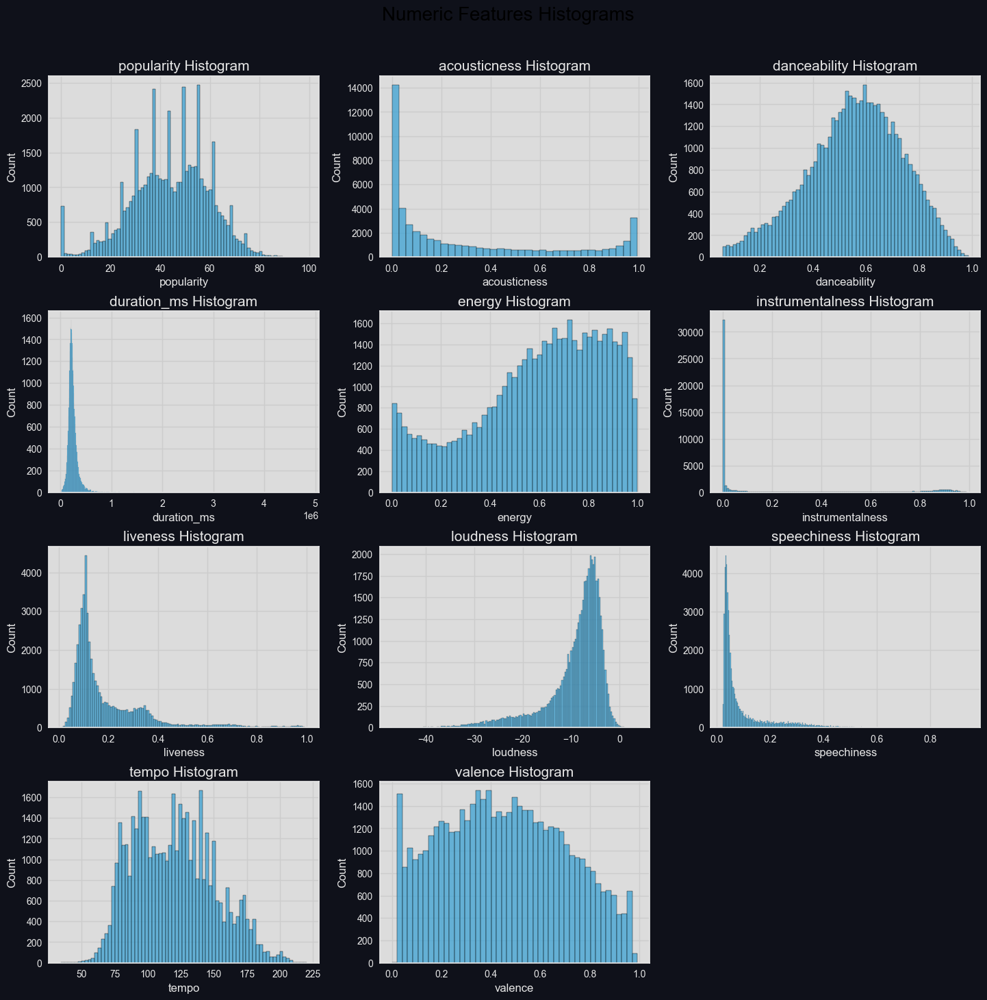

In [49]:
NumHists, axes = plt.subplots(4, 3, figsize=(15, 15))
NumHists.suptitle('Numeric Features Histograms', fontsize=20)
NumHists.tight_layout(pad=3.0)
for i, feature in enumerate(dfNum.columns):
    ax = axes[i//3, i%3]
    sns.histplot(dfNum[feature], ax=ax, color=snsPalette[0])
    ax.set_title(f'{feature} Histogram', fontsize=15)
    ax.set_xlabel(f'{feature}', fontsize=12)
    ax.set_ylabel('Count', fontsize=12)
    ax.set_facecolor(axBGColor)
NumHists.delaxes(axes[3,2])

From the graphs above, we can see that most of the numerical features are not normally distributed. For example, 'liveness' and 'speechiness' are right skewed and 'energy' and 'loudness' are left skewed. We will be transforming these features in the data preprocessing step to make them as normally distributed as possible. This is important for some models such as Logistic Regression.

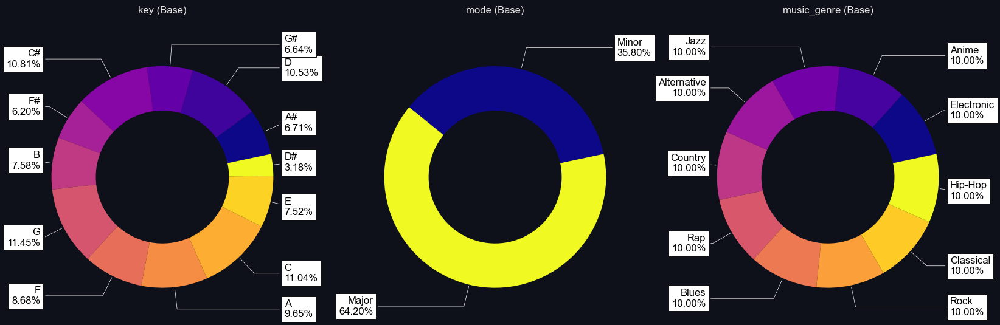

In [50]:
CateDonut, axes = plt.subplots(1, 3, figsize=(20,20))
bbox_props = dict(boxstyle="square,pad=0.3", fc="w", ec="k", lw=0.72)
kw = dict(arrowprops=dict(arrowstyle="-", color='w', lw=0.5),
          bbox=bbox_props, zorder=0, va="center")
for idx, col in enumerate(dfCate.columns):
    labelName = df[col].unique().tolist()
    wedges, texts = axes[idx].pie(df[col].value_counts(normalize=True)[df[col].unique()] * 100,
                                            startangle = 12,
                                            colors = pieCmap(np.linspace(0, 1, num=len(df[col].value_counts()))),
                                            wedgeprops=dict(width=0.4))
    axes[idx].set_title(col + " (Base)", pad=30)
    for i, p in enumerate(wedges):
        ang = (p.theta2 - p.theta1)/2. + p.theta1
        y = np.sin(np.deg2rad(ang))
        x = np.cos(np.deg2rad(ang))
        horizontalalignment = {-1: "right", 1: "left"}[int(np.sign(x))]
        connectionstyle = "angle,angleA=0,angleB={}".format(ang)
        kw["arrowprops"].update({"connectionstyle": connectionstyle})
        axes[idx].annotate(f"{labelName[i]}\n{df[col].value_counts(normalize=True)[df[col].unique()][i]*100:.2f}%", xy=(x, y), xytext=(1.1*np.sign(x), 1.2*y),
                    horizontalalignment=horizontalalignment, **kw)

Plotting the value count charts, we can see that:
- In the feature 'key', there are a total of 12 keys. The most common key is G, which is 11.45% of all keys. The least common key is D#, which is 3.18% of all keys.
- In the feature 'mode', there are 2 modes, Major and Minor. The most common mode is Major, which is 64.20%.
- In the feature 'music_genre', there are a total of 10 genres. Every genre are equally distributed at 10% each.

### **Pairplotting Data Samples**

We will be pairplotting a tenth of the whole dataset to see the distribution of the data.

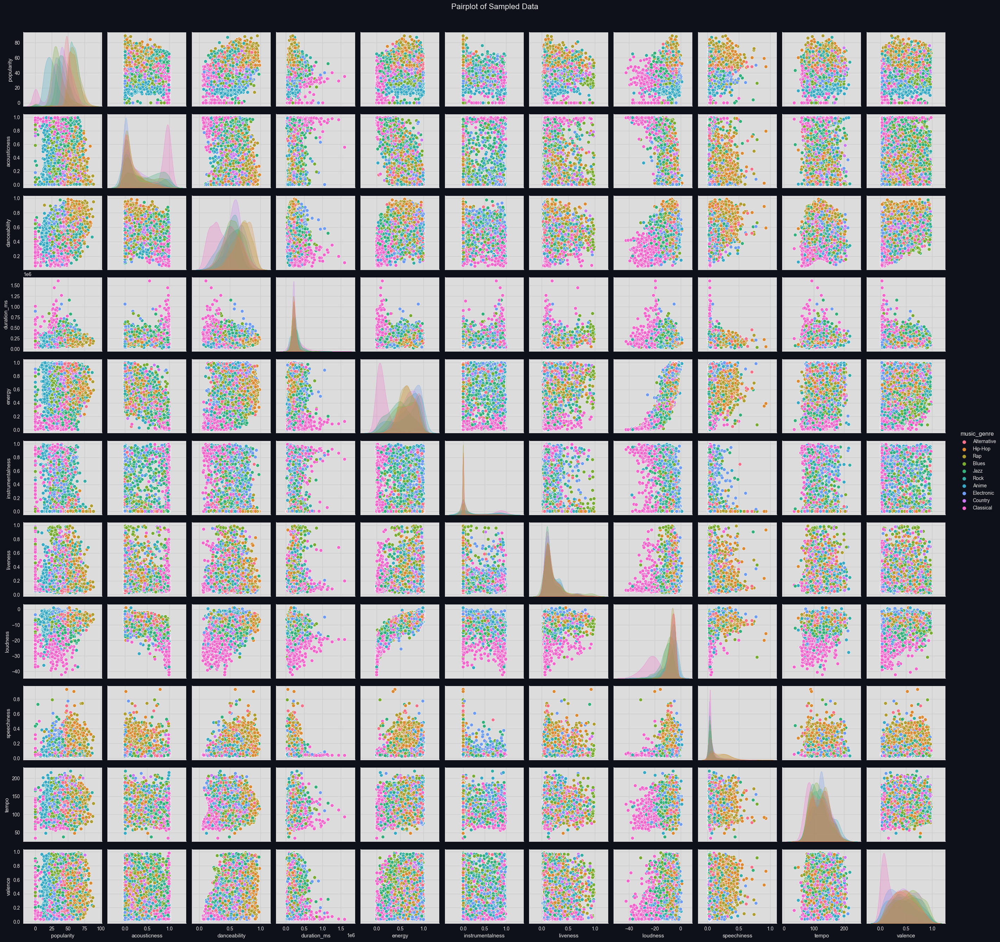

In [51]:
PairSamp = sns.pairplot(data = df.sample(int(df.shape[0]/10), random_state=777),
             diag_kind = 'kde',
             hue = 'music_genre',)
plt.setp(PairSamp._legend.get_title(), color=titleColor)
PairSamp.fig.suptitle("Pairplot of Sampled Data",
                      fontsize=16,
                      color=titleColor)
PairSamp.fig.subplots_adjust(top=0.95)

From the pairplot, we can see that the variance between class of the features are quite low and the variance within class of the features are quite low as well (except class 'Classical'). This means that the data is not very separable and we will need to use some feature engineering techniques to make the data more separable.

### **Plot Data for visualization**

In [52]:
dfNum.columns

Index(['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo',
       'valence'],
      dtype='object')

In [53]:
df_visual = df.copy()
df_visual.columns

Index(['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo',
       'valence', 'key', 'mode', 'music_genre'],
      dtype='object')

In [54]:
def visualizationof2data(df, feature1, feature2, mainfeaturerange,offset=[0,0,0]):
    df_visual_fcn = df.copy()
    main_group = pd.cut(df_visual_fcn[feature1], mainfeaturerange)
    df_visual_fcn[feature1] = main_group
    sum_group = df_visual_fcn[[feature2,feature1]].groupby(feature1).sum()
    mean_group  = df_visual_fcn[[feature2,feature1]].groupby(feature1).mean()
    # Plot
    visual_fcn_plot , axes = plt.subplots(1, 2, figsize=(20, 8))
    axes = axes.flatten()

    sns.barplot(x=sum_group[feature2], y=sum_group.index, ci=None, orient='h', ax=axes[0])
    axes[0].set_title(f'Total {feature2} \nby {feature1} Groups', weight='bold', fontsize=16)

    for i,v in enumerate(sum_group[feature2]):
        if i in [1, 2, 3, 4]:
            axes[0].text(v+offset[0], i, '{}'.format(v), horizontalalignment='right', verticalalignment='center', weight='bold', color='black', fontsize=12)
        else:
            axes[0].text(v+offset[1], i, '{}'.format(v), horizontalalignment='left', verticalalignment='center', weight='bold', color='black', fontsize=12)

    sns.barplot(x=mean_group[feature2], y=mean_group.index, ci=None, orient='h', ax=axes[1])
    axes[1].set_title(f'Average {feature2} \nby {feature1} Groups', weight='bold', fontsize=16)

    for i,v in enumerate(mean_group[feature2]):
        axes[1].text(v+offset[2], i, '{}'.format(round(v,2)), horizontalalignment='right', verticalalignment='center', weight='bold', color='black', fontsize=12)
    return visual_fcn_plot

# Usage Example:
# danceabilityByPopularityPlot = visualizationof2data(df_visual, 'popularity', 'danceability', [10, 20, 30, 40, 50, 60, 70, 80, 90, 100])

In [55]:
df_visual.mean()

popularity              44.220420
acousticness             0.306383
danceability             0.558241
duration_ms         245503.541466
energy                   0.599755
instrumentalness         0.181601
liveness                 0.193896
loudness                -9.133761
speechiness              0.093586
tempo                  119.952961
valence                  0.456264
dtype: float64

In [56]:
def visualizationof2dataAll(df, feature1, mainfeaturerange,offset=[0,0,0]):
    df_visual_fcn = df.copy()
    main_group = pd.cut(df_visual_fcn[feature1], mainfeaturerange)
    df_visual_fcn[feature1] = main_group
    numcol = ['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo',
       'valence']
    numcol.remove(feature1)
    # Plot
    visual_fcn_plot, axes = plt.subplots(3, 4, figsize=(24, 20))
    for idx,col in enumerate(numcol):
        ax = axes[idx//4, idx%4]
        mean_group  = df_visual_fcn[[col,feature1]].groupby(feature1).mean()
        sns.barplot(x=mean_group[col], y=mean_group.index, ci=None, orient='h', ax=ax)
        ax.set_title(f'Average {col} \nby {feature1} Groups', weight='bold', fontsize=16)
        threshold = mean_group.max().values[0]
        for i,v in enumerate(mean_group[col]):
            # print(mean_group)
            # alignment
            if 2*mean_group.iloc[i].values[0] > threshold:
                halignment = 'right'
            else:
                halignment = 'left'
            ax.text(v+offset[2], i, '{}'.format(round(v,2)), horizontalalignment=halignment, verticalalignment='center', weight='bold', color='black', fontsize=12)
    visual_fcn_plot.delaxes(axes[2,3])
    visual_fcn_plot.delaxes(axes[2,2])
    return visual_fcn_plot, mean_group

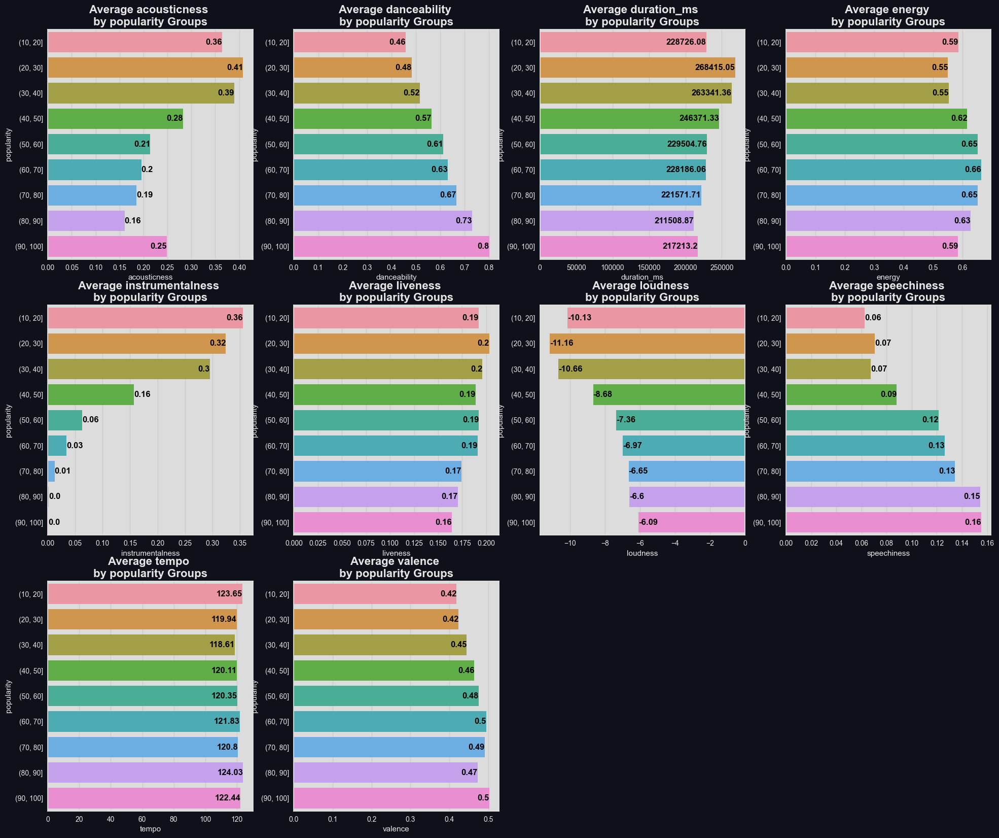

In [57]:
featureByPopularityPlot = visualizationof2dataAll(df_visual, 'popularity', [10, 20, 30, 40, 50, 60, 70, 80, 90, 100])

- เพลงที่มีความเป็น acoustic สูง จะมีความนิยมต่ำ
- เมื่อเพลงมีความ danceability สูง ความนิยมก็จะสูงขึ้นตาม
- เมื่อเพลงมีการใช้เครื่องดนตรีในการบรรเลงเยอะ (instrumentalness) ความนิยมก็จะต่ำลง
- เพลงที่ค่า liveness ต่ำ จะมีความนิยมสูง
- เพลงที่มีความดังของเสียงสูง (loudness) จะมีความนิยมต่ำ
- เพลงที่มีเสียงนักร้องเป็นส่วนใหญ่ (speechiness) จะมีความนิยมสูง
- ความยาวของเพลง (duration_ms), ความพุ่งของเพลง (energy), จังหวะ (tempo), เเละความสูงของเสียง (valence) ไม่ค่อยมีความสัมพันธ์กับ popularity ของเพลง

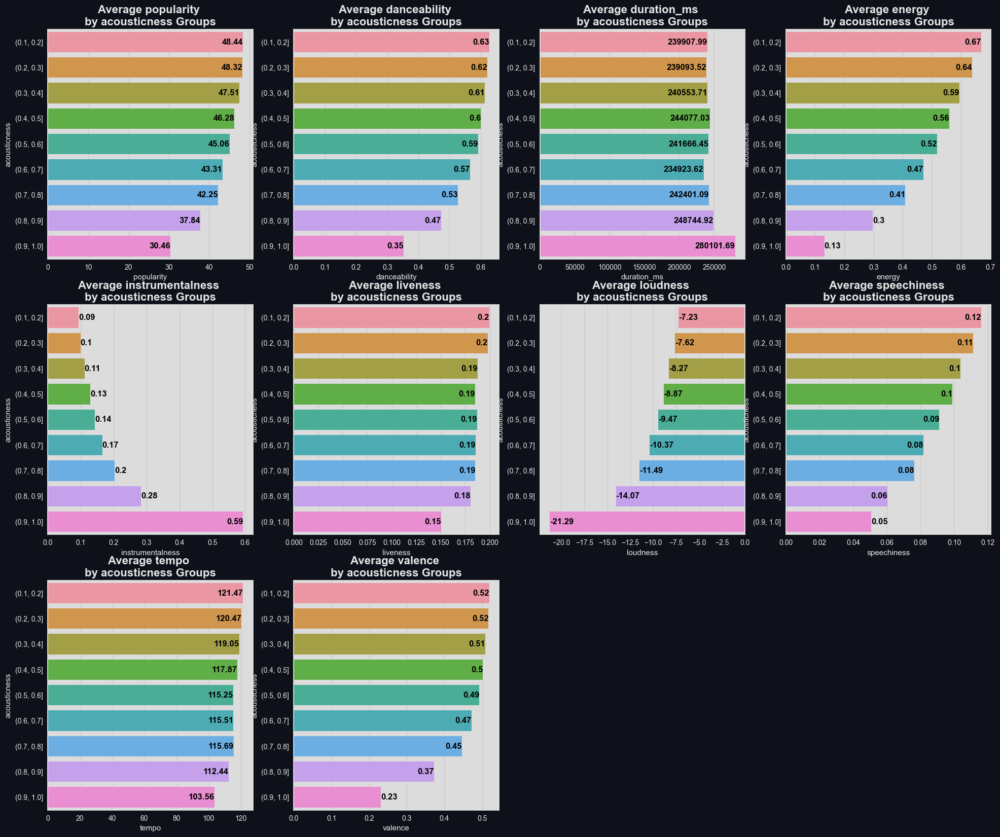

In [58]:
featureByacousticnessPlot = visualizationof2dataAll(df_visual, 'acousticness', [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])

- เมื่อเพลงมีความ danceability สูง ค่าความเป็น acoustic จะต่ำ
- เมื่อเพลงมีความยาว (duration_ms) ค่าความเป็น acoustic จะสูง
- เมื่อเพลงมีความพุ่ง (energy) สูงขึ้น ค่าความเป็น acoustic จะต่ำลง
- เพลงที่มีการใช้เครื่องดนตรีในการบรรเลงเยอะ (instrumentalness) ค่าความเป็น acoustic จะสูง
- เพลงที่ค่า liveness สูง ความเป็น acoustic จะต่ำ
- เพลงที่เสียงเบา (loudness) ความเป็น acoustic จะสูง
- เมื่อเพลงมีเสียงนักร้องเป็นส่วนใหญ่ (speechiness) ความเป็น acoustic จะต่ำ
- ยิ่งเพลงที่มีจังหวะเร็ว (tempo) ความเป็น acoustic จะต่ำลง
- เพลงที่มีความสูงของเสียงสูง (valence) ความเป็น acoustic จะต่ำ

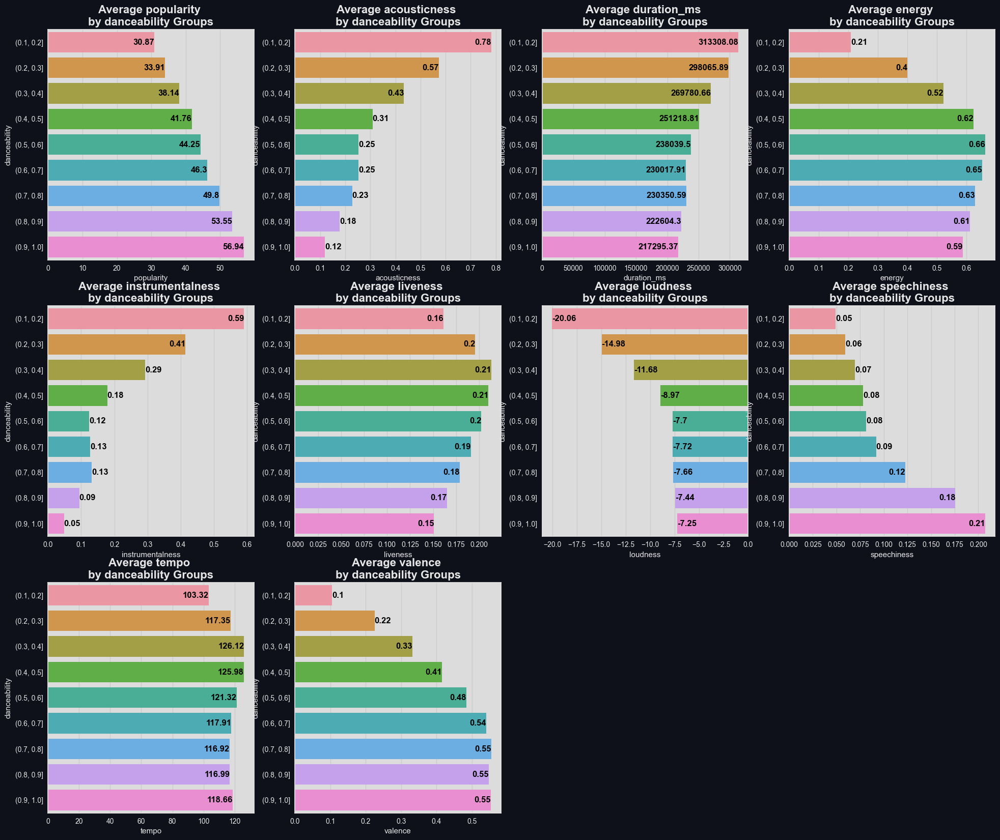

In [59]:
featureBydanceabilityPlot = visualizationof2dataAll(df_visual, 'danceability', [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])

- ยิ่งเพลงมีความยาวขึ้น (duration_ms) danceability จะต่ำลง
- เพลงที่มีการใช้เครื่องดนตรีในการบรรเลงเยอะ (instrumentalness) danceability จะต่ำ
- ยิ่งเพลงมีเสียงเบา (loudness) danceability จะต่ำลง
- เมื่อเพลงมีเสียงนักร้องเป็นส่วนใหญ่ (speechiness) ค่า danceability จะสูงขึ้น
- เพลงที่มีความสูงของเสียงสูง (valence) ค่า danceability จะสูงตาม
- ความพุ่งของเสียง (energy), เพลงที่บันทึกจากการแสดงสด (liveness), เเละจังหวะ (tempo) ไม่ค่อยมีความสัมพันธ์กับ danceability

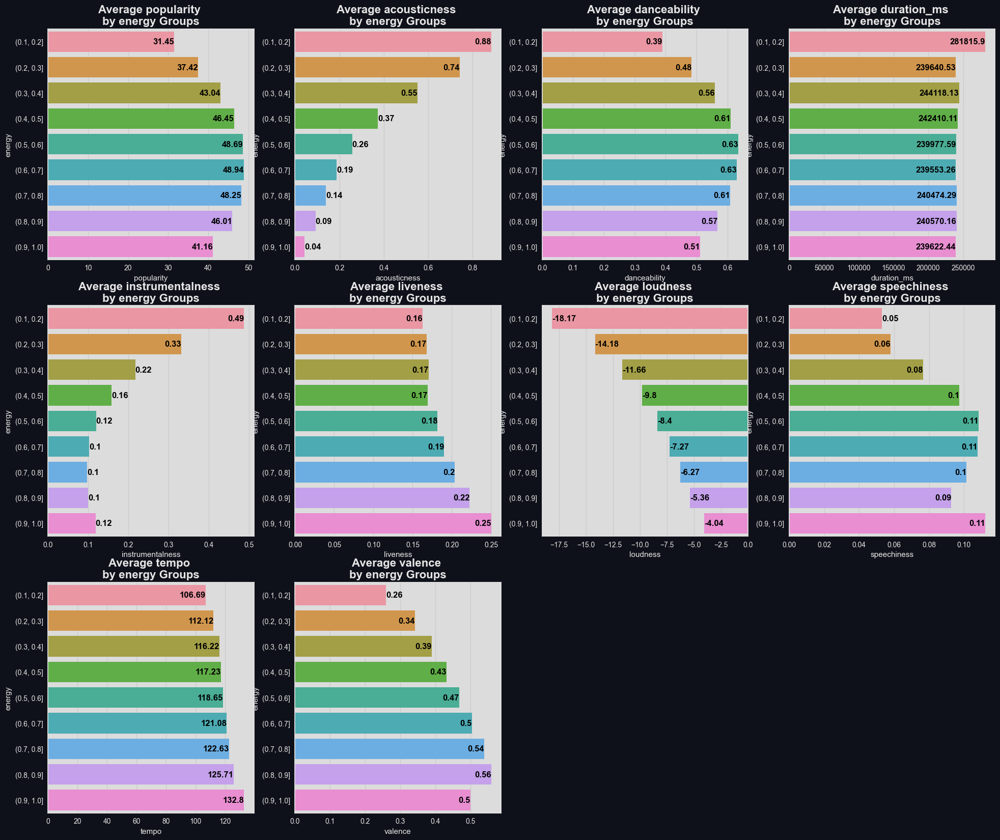

In [60]:
featureByenergyPlot = visualizationof2dataAll(df_visual, 'energy', [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])

- เพลงที่มีการใช้เครื่องดนตรีในการบรรเลงเยอะ (instrumentalness) energy จะต่ำ
- เพลงที่มีค่า liveness สูง energy จะสูงตาม
- เพลงที่เสียงเบา (loudness) energy จะต่ำ
- เพลงที่มีจังหวะเร็ว (tempo) energy จะสูง
- เพลงที่มีความสูงของเสียงสูง (valence) energy จะสูง
- ความนิยมของเพลง (popularity), ความเต้นของเพลง (danceablity), ความยาวของเพลง (duration_ms), เเละเสียงนักร้องในเพลง (speechiness) ไม่ค่อยมีความสัมพันธ์กับ energy

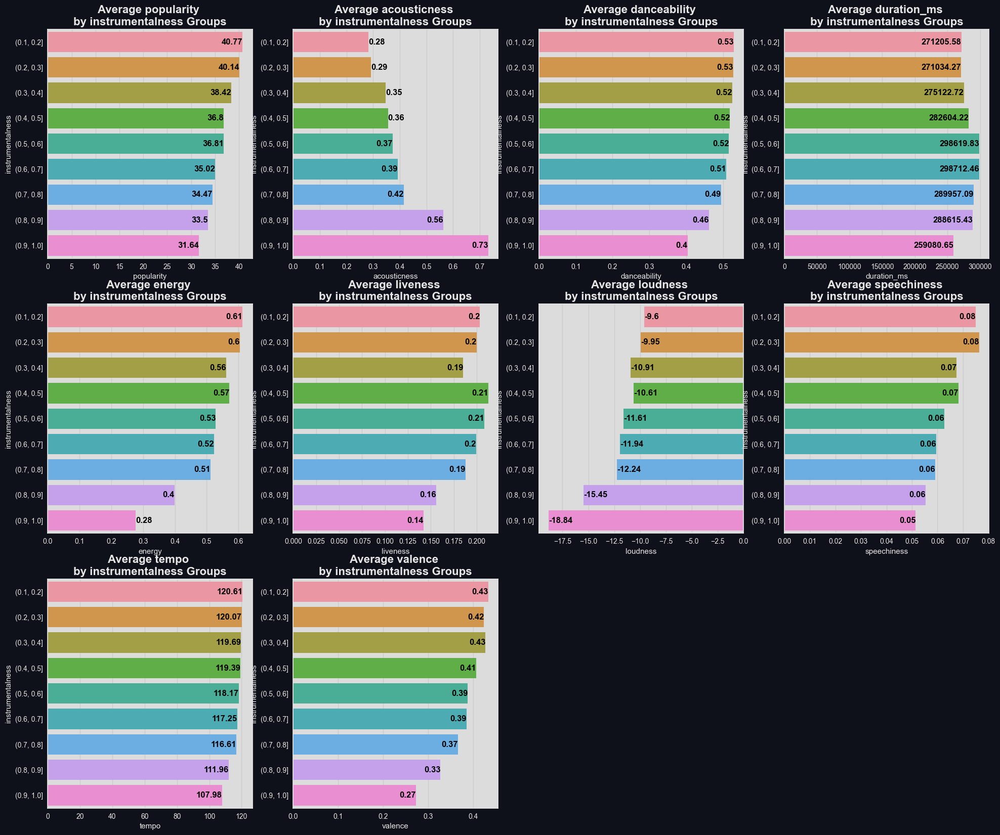

In [61]:
featureByinstrumentalnessPlot = visualizationof2dataAll(df_visual, 'instrumentalness', [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])

- เพลงที่เสียงเบา (loudness) instrumentalness จะสูง
- เมื่อเพลงมีเสียงนักร้องเป็นส่วนใหญ่ (speechiness) instrumentalness จะต่ำ
- เพลงที่มีจังหวะเร็ว (tempo) instrumentalness จะต่ำ
- เพลงที่มีความสูงของเสียงสูง (valence) instrumentalness จะต่ำ
- ความยาวของเพลง (duration_ms) เเละเพลงที่บันทึกจากการแสดงสด (liveness) ไม่ค่อยมีความสัมพันธ์กับ instrumentalness

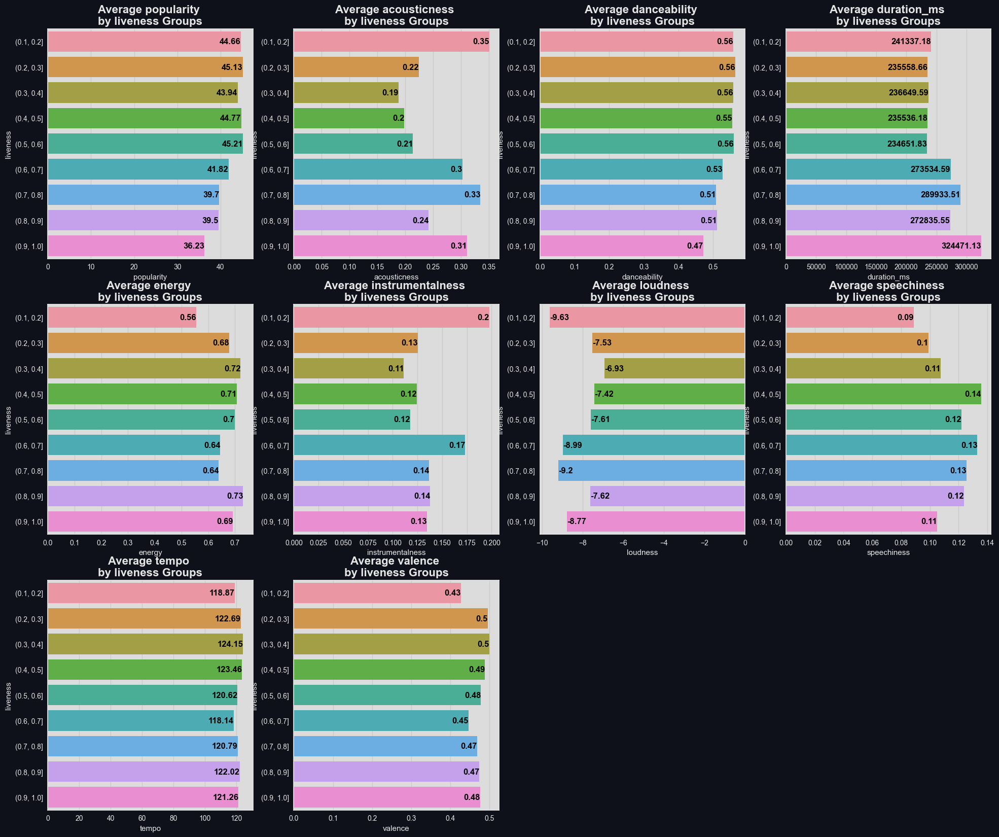

In [62]:
featureBylivenessPlot = visualizationof2dataAll(df_visual, 'liveness', [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])

- เพลงที่มีความยาว (duration_ms) liveness จะสูง
- acousticness, energy, instrumentalness, loudness, speechiness, tempo, เเละ valence ไม่มีค่อยมีความสัมพันธ์กับ liveness

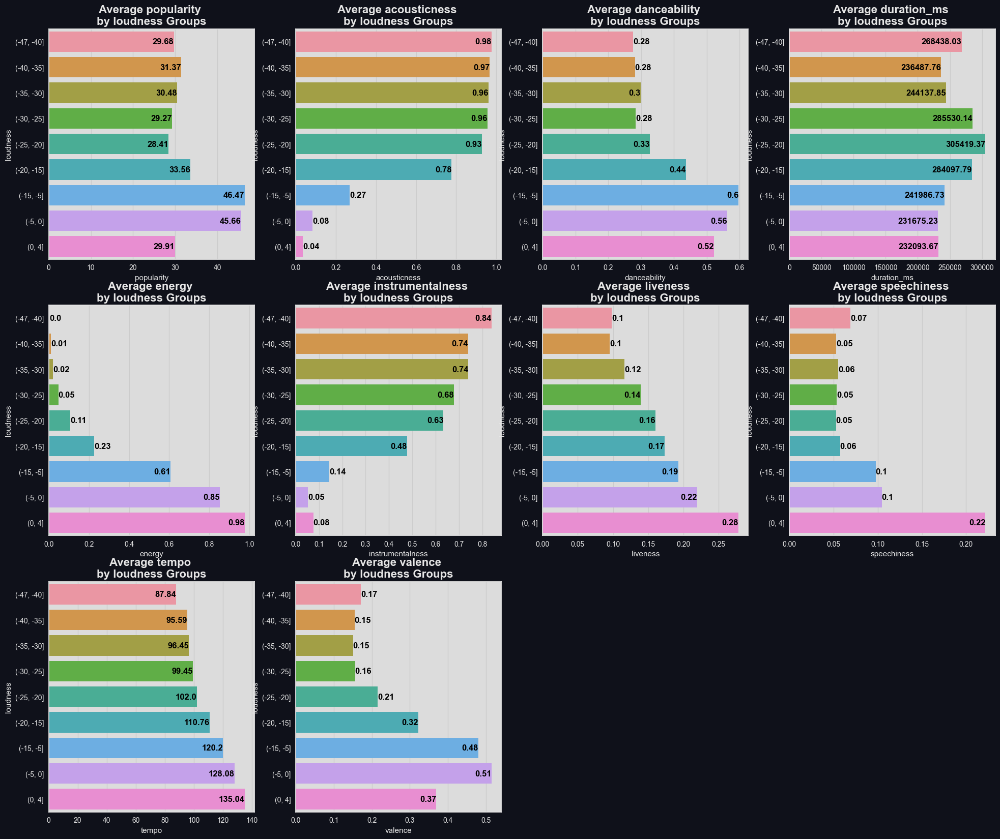

In [63]:
featureByloudnessPlot = visualizationof2dataAll(df_visual, 'loudness', [-47, -40, -35, -30, -25, -20, -15, -5, 0, 4])

- เพลงที่ค่า liveness สูง ความดังของเสียงก็จะสูง (<font color=red>ทำไมกราฟนี้ไม่เหมือนกับกราฟของ liveness?</font>)
- เพลงที่มีเสียงนักร้องเป็นส่วนใหญ่ (speechiness) ความดังของเสียงก็จะสูง
- เมื่อเพลงมีจังหวะเร็วขึ้น (tempo) ความดังของเสียงก็จะสูงขึ้น
- เพลงที่มีความสูงของเสียงสูง (valence) ความดังของเสียงก็จะสูง
- ความนิยมของเพลง (popularity) เเละความยาวของเพลง (duration_ms) ไม่ค่อยมีความสัมพันธ์กับ loudness

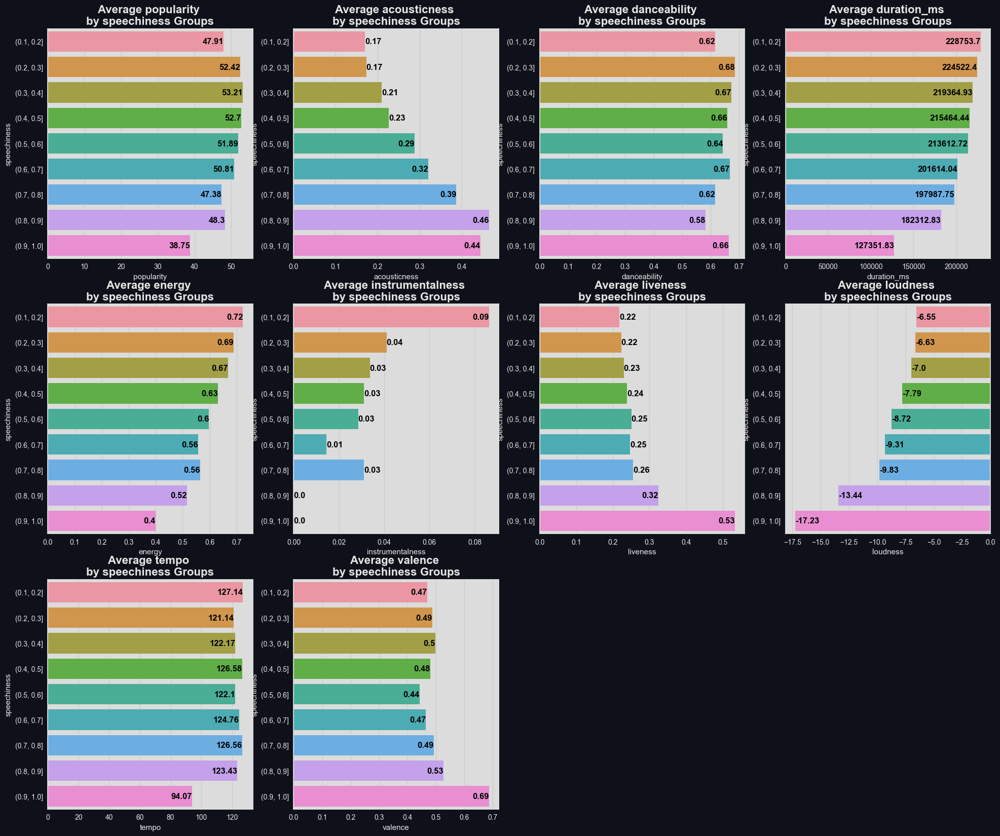

In [64]:
featureByspeechinessPlot = visualizationof2dataAll(df_visual, 'speechiness', [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])


- เพลงที่มีความเป็น acoustic สูง speechiness ก็จะสูง (<font color=red>ทำไมกราฟนี้ไม่เหมือนกับกราฟของ acousticness?</font>)
- เพลงที่สั้น speechiness ก็จะสูง
- เมื่อเพลงมี energy สูง speechiness จะต่ำลง (<font color=red>เเตกต่างจากกราฟของ energy?</font>)
- เพลงที่ค่า liveness สูง speechiness จะสูงขึ้นตาม (<font color=red>เป็นเพราะการเเสดงสดจากเน้นเสียงของนักร้อง?</font>)
- เพลงที่มีเสียงดัง (loudness) ค่า speechiness จะลดต่ำลง (<font color=red>เเตกต่างจากกราฟของ loudness?</font>)
- ความนิยมของเพลง (popularity), ความเต้นของเพลง (danceablity), จังหวะเพลง (tempo), เเละความสูงของเสียง (valence) ไม่ค่อยมีความสัมพันธ์กับ speechiness

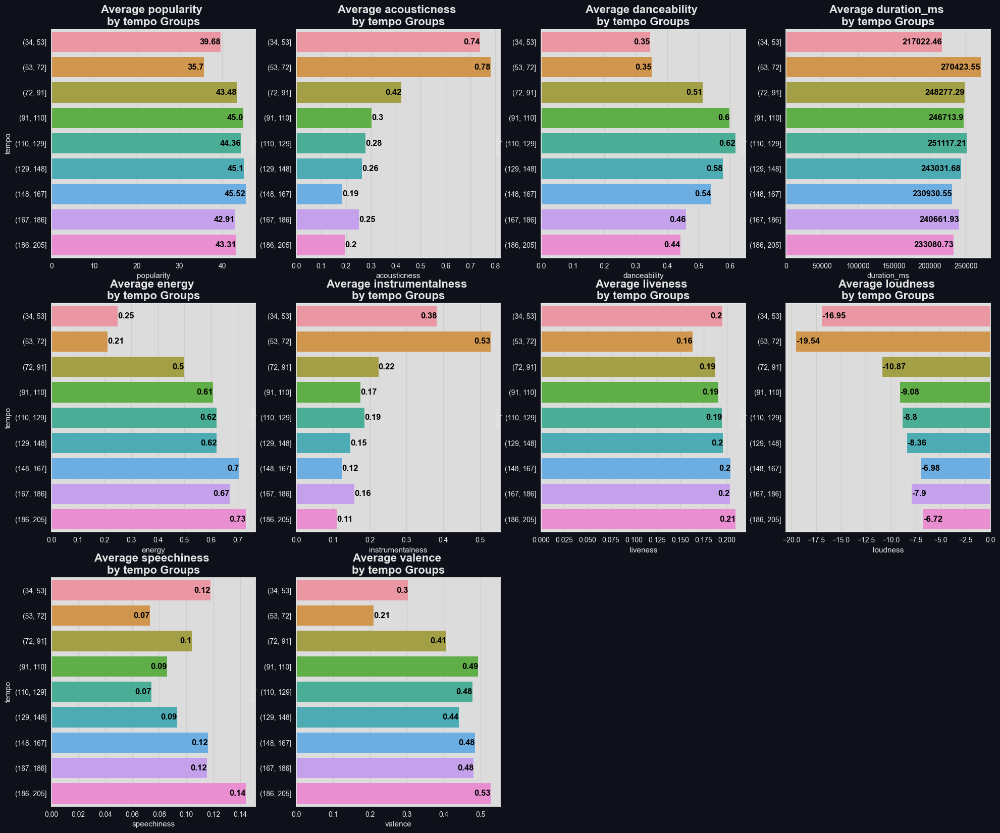

In [65]:
featureBytempoPlot = visualizationof2dataAll(df_visual, 'tempo', [34, 53, 72, 91, 110, 129, 148, 167, 186, 205])

- ความนิยมของเพลง (popularity), ความเต้นของเพลง (danceablity), ความยาวเพลง (duration_ms), เพลงที่บันทึกจากการแสดงสด (liveness), เพลงที่มีเสียงร้อง (speechiness), เเละความสูงของเสียง (valence) ไม่ค่อยมีความสัมพันธ์กับ tempo

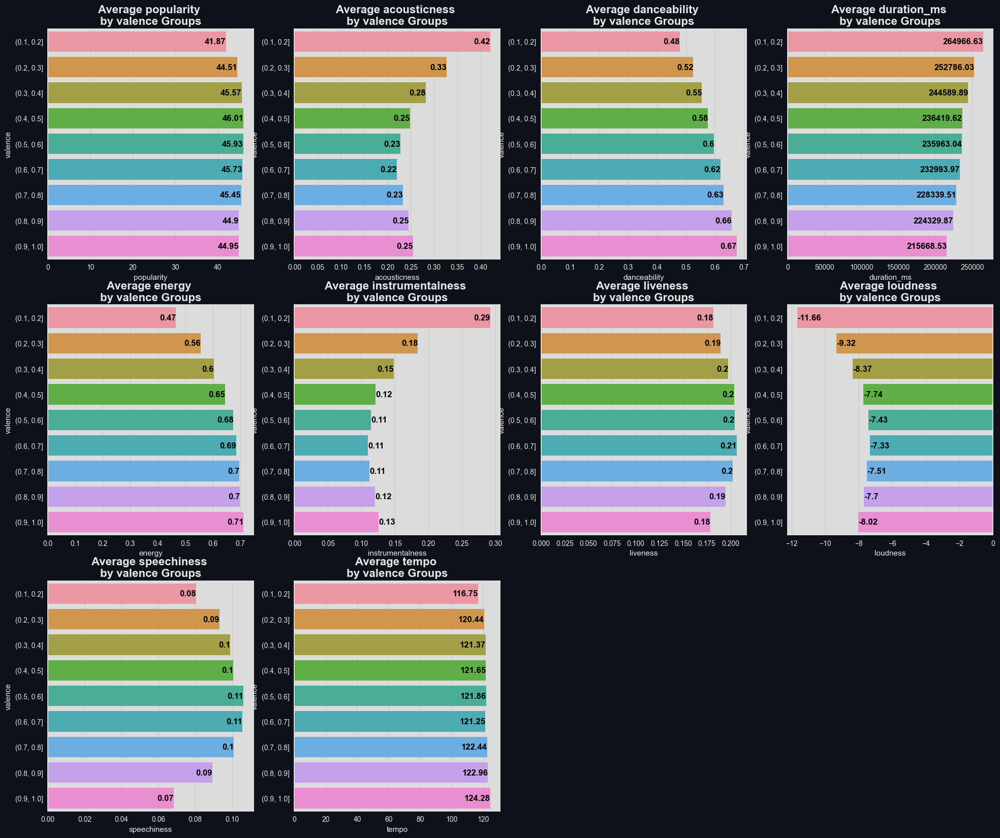

In [66]:
featureByvalencePlot = visualizationof2dataAll(df_visual, 'valence', [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1])

- เพลงที่มีความ acoustic สูง valence จะต่ำ
- เมื่อเพลงมีความ danceability สูง valence จะสูงขึ้นตาม
- เมื่อเพลงมีความยาวมากขึ้น (duration_ms) valence จะลดลง
- ความนิยม (popularity), เพลงที่บันทึกจากการแสดงสด (liveness), เพลงที่มีเสียงร้อง (speechiness), เเละจังหวะ (tempo) ไม่ค่อยมีความสัมพันธ์กับ valence

In [67]:
df_visual.groupby('music_genre').get_group('Hip-Hop').sort_values(by='key', ascending=False).head(10)

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,key,mode,music_genre
47724,57.0,0.204000,0.800,114373.0,0.749,0.000000,0.1130,-4.943,0.3300,151.851,0.961,G#,Major,Hip-Hop
48720,69.0,0.294000,0.760,161990.0,0.476,0.000000,0.1000,-8.103,0.2410,147.010,0.354,G#,Major,Hip-Hop
45483,60.0,0.008890,0.794,185107.0,0.864,0.000145,0.0398,-5.964,0.0755,100.516,0.900,G#,Major,Hip-Hop
47782,56.0,0.039000,0.744,258200.0,0.697,0.000000,0.1710,-14.753,0.0631,119.955,0.683,G#,Major,Hip-Hop
46738,59.0,0.000174,0.723,238227.0,0.822,0.000000,0.1350,-6.880,0.2340,180.013,0.456,G#,Major,Hip-Hop
46735,60.0,0.082100,0.686,216002.0,0.720,0.000000,0.4140,-6.084,0.2250,146.026,0.326,G#,Major,Hip-Hop
46730,55.0,0.217000,0.756,228000.0,0.457,0.000302,0.1300,-7.555,0.2080,139.972,0.265,G#,Minor,Hip-Hop
45493,70.0,0.252000,0.746,349785.0,0.576,0.000000,0.0740,-7.461,0.4140,110.200,0.337,G#,Major,Hip-Hop
46722,56.0,0.519000,0.820,267200.0,0.743,0.000000,0.1160,-6.776,0.3130,NaN,0.812,G#,Major,Hip-Hop
45499,67.0,0.306000,0.786,235703.0,0.440,0.000000,0.1210,-7.673,0.1570,98.014,0.315,G#,Minor,Hip-Hop


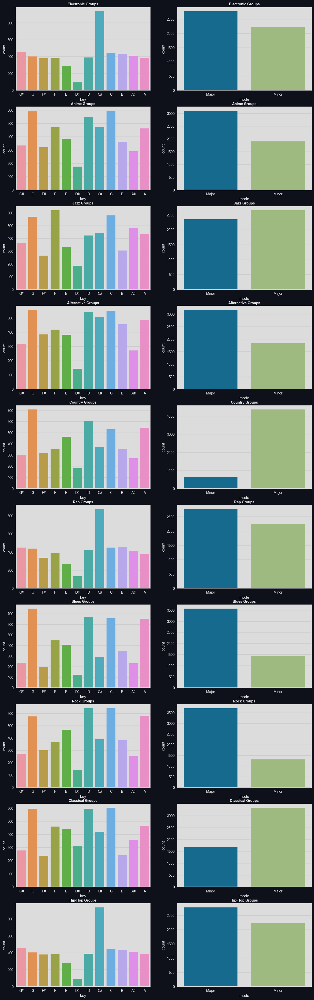

In [68]:
dfCateDict = {"Electronic": df_visual.groupby('music_genre').get_group('Hip-Hop').sort_values(by='key', ascending=False),
            "Anime": df_visual.groupby('music_genre').get_group('Anime').sort_values(by='key', ascending=False),
            "Jazz": df_visual.groupby('music_genre').get_group('Jazz').sort_values(by='key', ascending=False),
            "Alternative": df_visual.groupby('music_genre').get_group('Alternative').sort_values(by='key', ascending=False),
            "Country": df_visual.groupby('music_genre').get_group('Country').sort_values(by='key', ascending=False),
            "Rap": df_visual.groupby('music_genre').get_group('Rap').sort_values(by='key', ascending=False),
            "Blues": df_visual.groupby('music_genre').get_group('Blues').sort_values(by='key', ascending=False),
            "Rock": df_visual.groupby('music_genre').get_group('Rock').sort_values(by='key', ascending=False),
            "Classical": df_visual.groupby('music_genre').get_group('Classical').sort_values(by='key', ascending=False),
            "Hip-Hop": df_visual.groupby('music_genre').get_group('Hip-Hop').sort_values(by='key', ascending=False),
}
catcol = ['key', 'mode']
catVisPlot , axes = plt.subplots(10, 2, figsize=(15, 50))
count = 0
for key, item in dfCateDict.items():
    for idx,col in enumerate(catcol):
        ax = axes[count, idx]
        sns.countplot(x=col, data=item, ax=ax)
        ax.set_title(f'{key} Groups', weight='bold', fontsize=10)
    count += 1


### **Plot Outlier for visualization**

In [69]:
def plotoutlierBarStrip(df,title='',plottype='both',plotdetail='notdetail'):
    df_def = df.copy()
    plotlist = []
    if plottype == 'both' or plottype == 'box':
        if plotdetail == 'notdetail':
            plotgraphBox, axes = plt.subplots(2, 6, figsize=(20, 12))
        elif plotdetail == 'detail':
            plotgraphBox, axes = plt.subplots(2, 6, figsize=(60, 20))
        plotgraphBox.suptitle(f'{title} Outlier Detection', fontsize=20, fontweight='bold', color='white',y=0.92)
        plotgraphBox.delaxes(axes[1,5])
        for idx, col in enumerate(dfNum.columns):
            if plotdetail == 'notdetail':
                sns.boxplot(x=df_def[col],ax=axes[idx//6, idx%6])
            elif plotdetail == 'detail':
                sns.boxplot(x='music_genre', y=col, data=df_def, ax=axes[idx//6, idx%6])
            plt.title(col + ' (box)')
        plotlist.append(plotgraphBox)
    if plottype == 'both' or plottype == 'strip':
        if plotdetail == 'notdetail':
            plotgraphStrip, axes = plt.subplots(2, 6, figsize=(20, 12))
        elif plotdetail == 'detail':
            plotgraphStrip, axes = plt.subplots(2, 6, figsize=(60, 20))
        plotgraphStrip.suptitle(f'{title} Outlier Detection', fontsize=20, fontweight='bold', color='white',y=0.92)
        plotgraphStrip.delaxes(axes[1,5])
        for idx, col in enumerate(dfNum.columns):
            if plotdetail == 'notdetail':
                sns.stripplot(x=df_def[col],ax=axes[idx//6, idx%6])
            elif plotdetail == 'detail':
                sns.stripplot(x='music_genre', y=col, data=df_def, ax=axes[idx//6, idx%6])
            plt.title(col + ' (strip)')
        plotlist.append(plotgraphStrip)
    return plotlist

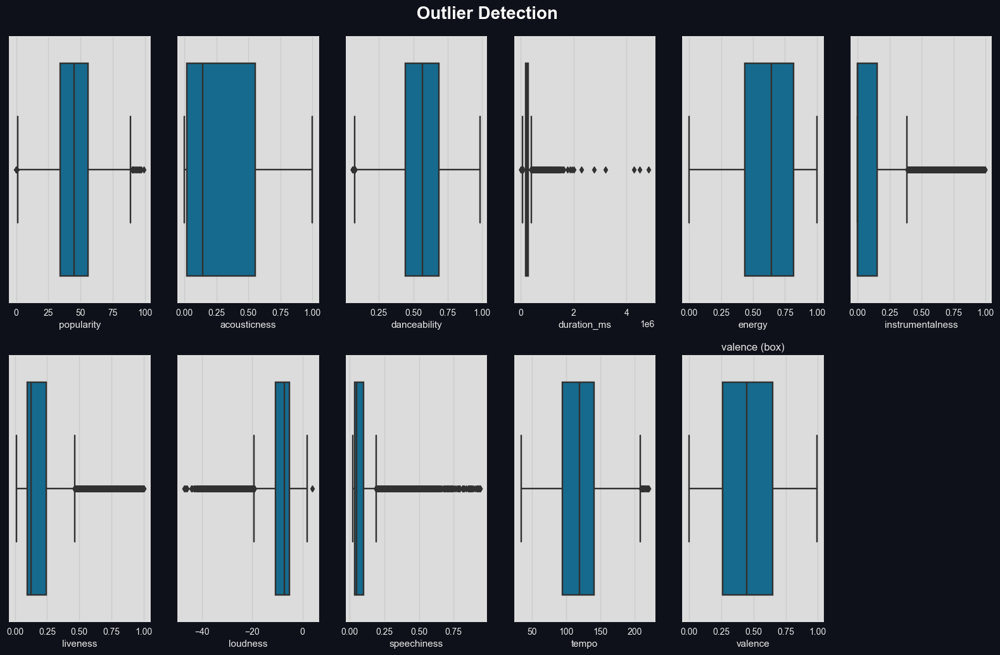

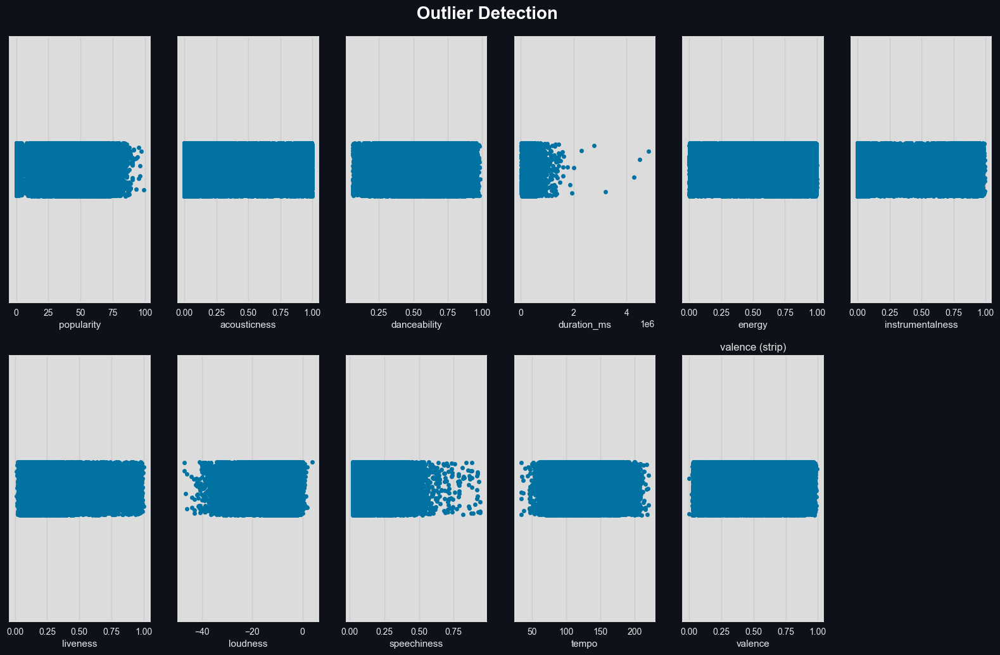

In [70]:
outlierplotALL = plotoutlierBarStrip(df_visual,'','both','notdetail')

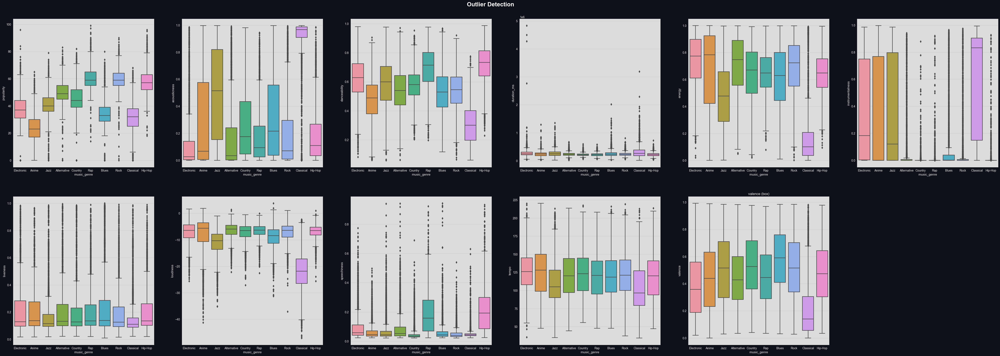

In [71]:
outlierplotBoxDetail = plotoutlierBarStrip(df_visual,'','box','detail')

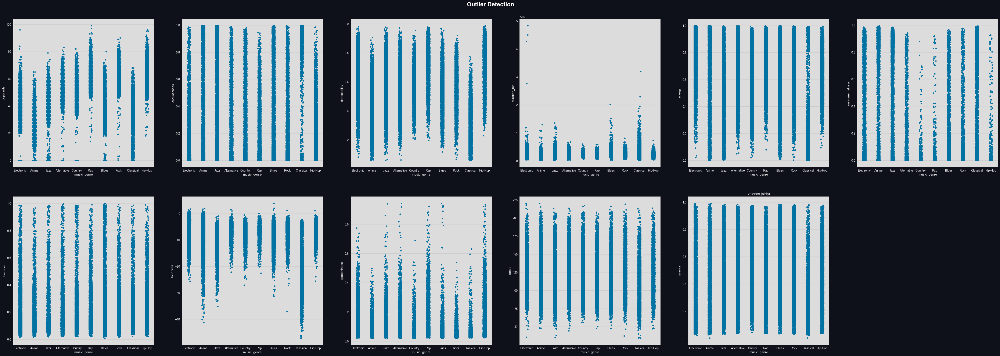

In [72]:
outlierplotstripdetail = plotoutlierBarStrip(df_visual,'','strip','detail')

โดยเราจะเห็นได้ว่ามี Outlier อยู่ใน Data set ของเรายิ่งโดยจะเห็นได้ชัดใน Feature duration_ms มากที่สุด

### **Data Exploration's Conclusion**

To conclude everything up to this point, there were <u>4 unnecessary feature</u>, <u>4 duplicated instances</u> and <u>1 missing values</u> that we have removed. This means that we are left with a total of **50000 instances and 14 features**.

In which, there are:

- 4 features, including output, that are '<font color='green'>object</font>', which means that they are '<font color='red'>Categorical Features</font>'.
- 10 features that are '<font color='green'>int64</font>', which means that they are '<font color='red'>Numerical Features</font>'

In [73]:
df.to_csv('Data/data.csv', index=False)

<font color='green'><h3>ตรงนี้จะใส่ Data Exploration's Conclusion</h3></font>

## **Data Preprocessing**

### **Import Data**

In [74]:
df = pd.read_csv('Data/data.csv')
dfNum = df.select_dtypes(include=['float64'])
dfCate = df.select_dtypes(include=['object'])

### **Handle Missing Values**

เนื่องจาก Missing values มีจำนวนมาก 18.8% ของ Dataset ทั้งหมด จึงเลือกที่จะ Replace แทนที่จะ Remove โดยเลือกที่จะ Replace ด้วยค่าต่างในการทดลองนี้โดยเราพิจารณาใช้

- ค่าเฉลี่ยของคอลัมน์ที่มี Missing values
- ค่าที่มีความถี่สูงสุดของคอลัมน์ที่มี Missing values
- Multivariate Imputation by Chained Equations(mice)
- K-Nearest Neighbors (KNN) Imputer

In [75]:
df_vis = df.copy()
df_impute =  df.copy()

In [76]:
def plotForImpute(df, feature, df2 = None, prefix = ['','']):
    df = df.copy()
    df_Electronic = df[df['music_genre'] == 'Electronic']
    df_Anime = df[df['music_genre'] == 'Anime']
    df_Jazz = df[df['music_genre'] == 'Jazz']
    df_Alternative = df[df['music_genre'] == 'Alternative']
    df_Country = df[df['music_genre'] == 'Country']
    df_Blues = df[df['music_genre'] == 'Blues']
    df_Rap = df[df['music_genre'] == 'Rap']
    df_Rock = df[df['music_genre'] == 'Rock']
    df_Classical = df[df['music_genre'] == 'Classical']
    df_Hip_Hop = df[df['music_genre'] == 'Hip-Hop']
    if type(df2) == type(None):
        plotDflist = [df_Electronic, df_Anime, df_Jazz, df_Alternative, df_Country, df_Blues, df_Rap, df_Rock, df_Classical, df_Hip_Hop]
        titlelist = ['Electronic', 'Anime', 'Jazz', 'Alternative', 'Country', 'Blues', 'Rap', 'Rock', 'Classical', 'Hip-Hop']
        row , col = 2, 5
        targetPlot = feature
        imputeHists, axes = plt.subplots(row, col, figsize=(30, 10))
    else :
        df2 = df2.copy()
        df2_Electronic = df2[df2['music_genre'] == 'Electronic']
        df2_Anime = df2[df2['music_genre'] == 'Anime']
        df2_Jazz = df2[df2['music_genre'] == 'Jazz']
        df2_Alternative = df2[df2['music_genre'] == 'Alternative']
        df2_Country = df2[df2['music_genre'] == 'Country']
        df2_Blues = df2[df2['music_genre'] == 'Blues']
        df2_Rap = df2[df2['music_genre'] == 'Rap']
        df2_Rock = df2[df2['music_genre'] == 'Rock']
        df2_Classical = df2[df2['music_genre'] == 'Classical']
        df2_Hip_Hop = df2[df2['music_genre'] == 'Hip-Hop']
        plotDflist = [df_Electronic, df2_Electronic, df_Anime, df2_Anime, df_Jazz, df2_Jazz, df_Alternative, df2_Alternative, df_Country, df2_Country, df_Blues, df2_Blues, df_Rap, df2_Rap, df_Rock, df2_Rock, df_Classical, df2_Classical, df_Hip_Hop, df2_Hip_Hop]
        titlelist = ['Electronic', 'Electronic', 'Anime', 'Anime', 'Jazz', 'Jazz', 'Alternative', 'Alternative', 'Country', 'Country', 'Blues', 'Blues', 'Rap', 'Rap', 'Rock', 'Rock', 'Classical', 'Classical', 'Hip-Hop', 'Hip-Hop']
        row , col = 5, 2
        targetPlot = feature
        imputeHists, axes = plt.subplots(2*row, col, figsize=(20, 60))
    for i, df in enumerate(plotDflist):
            ax = axes[i//col, i%col]
            sns.histplot(df[targetPlot], ax=ax, color=snsPalette[0], kde=True)
            if i%2 == 0:
                ax.set_title(f'{prefix[0]}'+titlelist[i])
            else:
                ax.set_title(f'{prefix[1]}'+titlelist[i])
            ax.set_xlabel(targetPlot)
            ax.set_ylabel('Count')
            ax.set_facecolor(axBGColor)
    return imputeHists

#### **Plotting Histogram**

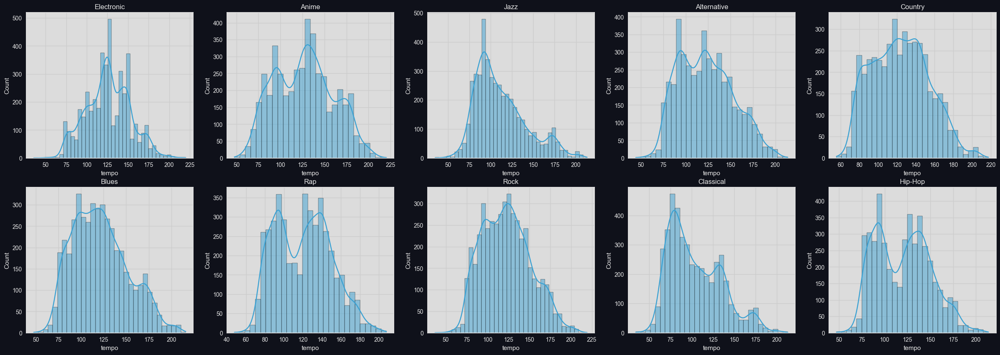

In [77]:
imputeHists_tempo = plotForImpute(df_vis, 'tempo')

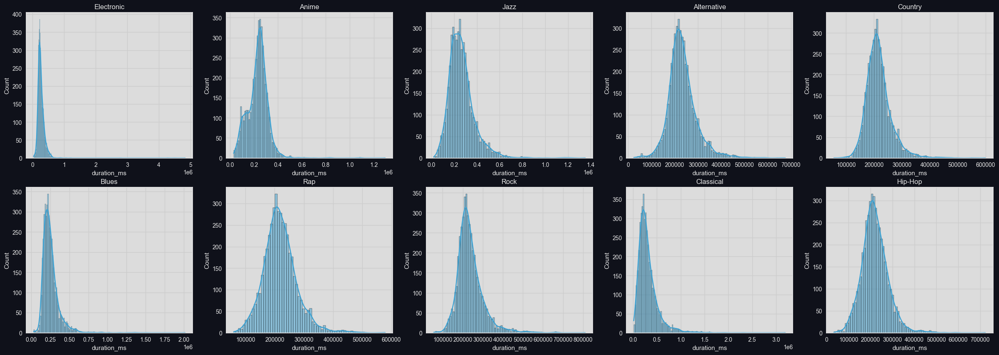

In [78]:
imputeHists_duration_ms = plotForImpute(df_vis, 'duration_ms')

โดยเราจะ Plot Histogram ของคอลัมน์ที่มี Missing values ออกมาเพื่อพิจารณาการกระจายของตัวของข้อมูล โดยเราจะพยายามที่จะเลือก Method ในการ Replace ที่มีการกระจายของข้อมูลใกล้เคียงกับข้อมูลตั้งต้นมากที่สุดเพื่อไม่ให้การทำ Imputation ทำให้ข้อมูลไมาแสดงถึงการกระจายของข้อมูลจริง 

#### **Imputation Using Mean,Most Frequent**

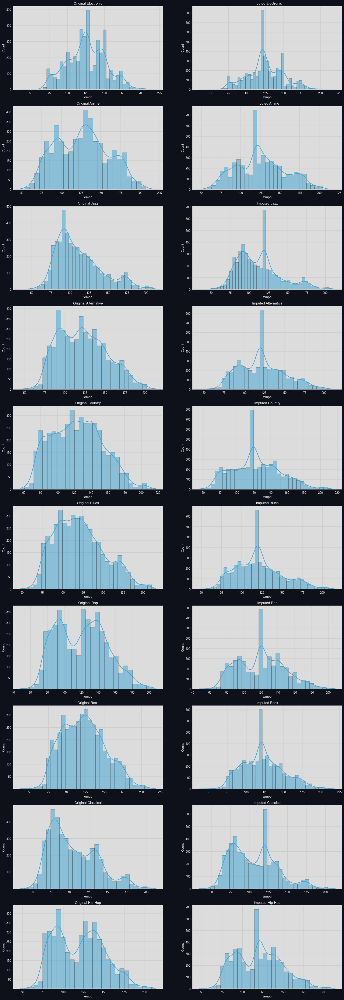

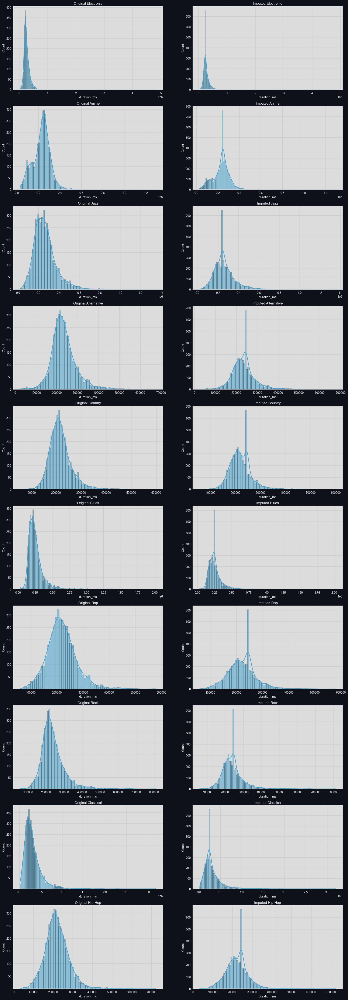

In [79]:
imp_mean = SimpleImputer(missing_values=np.nan, strategy='mean')
df_impute_mean = df_impute.copy()
df_impute_mean['tempo'] = imp_mean.fit_transform(df_impute_mean[['tempo']])
df_impute_mean['duration_ms'] = imp_mean.fit_transform(df_impute_mean[['duration_ms']])
imputeHists_mean_tempo_compare = plotForImpute(df_vis , 'tempo', df_impute_mean, ['Original ','Imputed '])
imputeHists_mean_duration_ms_compare = plotForImpute(df_vis , 'duration_ms', df_impute_mean, ['Original ','Imputed '])

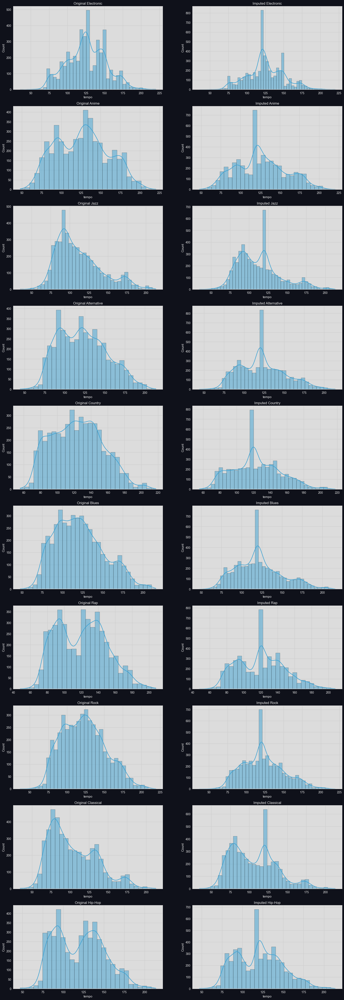

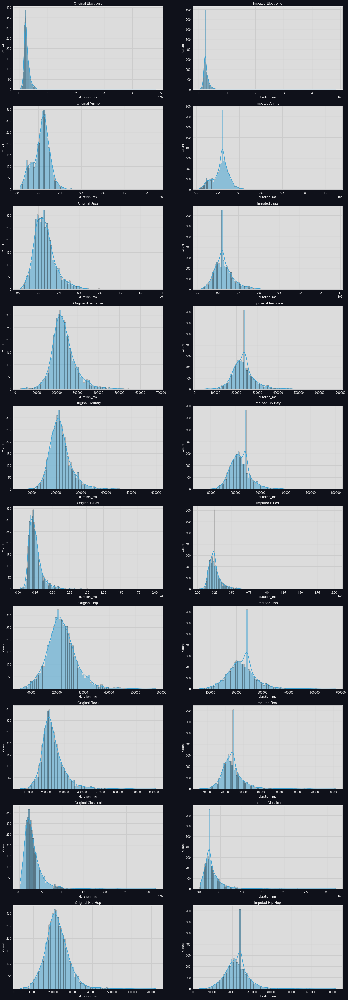

In [80]:
imp_mode = SimpleImputer(missing_values=np.nan, strategy='most_frequent')
df_impute_mode = df_impute.copy()
df_impute_mode['tempo'] = imp_mode.fit_transform(df_impute_mode[['tempo']])
df_impute_mode['duration_ms'] = imp_mode.fit_transform(df_impute_mode[['duration_ms']])
imputeHists_mode_tempo_compare = plotForImpute(df_vis , 'tempo', df_impute_mode, ['Original ','Imputed '])
imputeHists_mode_duration_ms_compare = plotForImpute(df_vis , 'duration_ms', df_impute_mode, ['Original ','Imputed '])

From the histogram, we can see that the distribution of the data is not quite the same as before. So we decided not to use the mean and the most frequent value to impute the missing values.

#### **Imputation Using Multivariate Imputation by Chained Equations(mice)**

In [81]:
from impyute.imputation.cs import mice

df_impute_mice = df_impute.copy()
df_impute_mice.drop(['key','mode','music_genre'], axis=1, inplace=True)
imputed_training=mice(df_impute_mice.values)

In [82]:
df_impute_mice = pd.DataFrame(imputed_training, columns=df_impute_mice.columns)
df_impute_mice['key'] = df_impute['key']
df_impute_mice['mode'] = df_impute['mode']
df_impute_mice['music_genre'] = df_impute['music_genre']
df_impute_mice

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,key,mode,music_genre
0,27.0,0.00468,0.652,253749.301242,0.941,0.79200,0.115,-5.201,0.0748,100.889,0.759,A#,Minor,Electronic
1,31.0,0.01270,0.622,218293.000000,0.890,0.95000,0.124,-7.043,0.0300,115.002,0.531,D,Minor,Electronic
2,28.0,0.00306,0.620,215613.000000,0.755,0.01180,0.534,-4.617,0.0345,127.994,0.333,G#,Major,Electronic
3,34.0,0.02540,0.774,166875.000000,0.700,0.00253,0.157,-4.498,0.2390,128.014,0.270,C#,Major,Electronic
4,32.0,0.00465,0.638,222369.000000,0.587,0.90900,0.157,-6.266,0.0413,145.036,0.323,F#,Major,Electronic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,59.0,0.03340,0.913,209584.008900,0.574,0.00000,0.119,-7.022,0.2980,98.028,0.330,C#,Major,Hip-Hop
49996,72.0,0.15700,0.709,251860.000000,0.362,0.00000,0.109,-9.814,0.0550,122.043,0.113,B,Major,Hip-Hop
49997,51.0,0.00597,0.693,189483.000000,0.763,0.00000,0.143,-5.443,0.1460,131.079,0.395,D,Major,Hip-Hop
49998,65.0,0.08310,0.782,262773.000000,0.472,0.00000,0.106,-5.016,0.0441,75.886,0.354,G,Minor,Hip-Hop


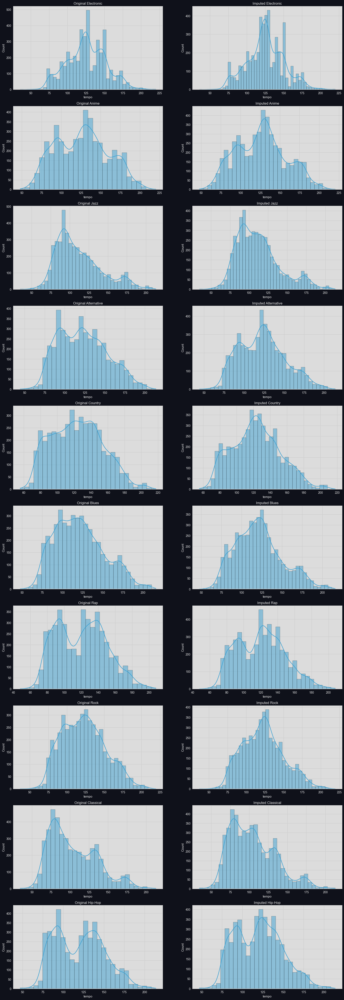

In [83]:
imputeHists_mice_tempo_compare = plotForImpute(df_vis , 'tempo', df_impute_mice, ['Original ','Imputed '])

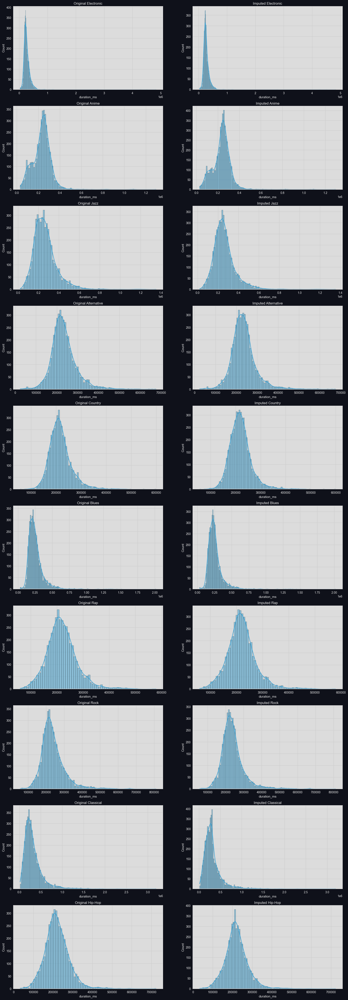

In [84]:
imputeHists_mice_duration_ms_compare = plotForImpute(df_vis , 'duration_ms', df_impute_mice, ['Original ','Imputed '])

From the histogram, we can see that the distribution of the data is quite the same as before. So we decided to use the mice to impute the missing values.

#### **Imputation Using KNNImputer**

##### **Search for Hyperparameter**

In [85]:
# Impute missing values
df_impute_knn_find = df_impute.copy()
df_impute_knn_find = pd.get_dummies(df_impute_knn_find, columns=['key','mode'], drop_first=True).dropna()

In [86]:
X = df_impute_knn_find.drop(['music_genre'], axis=1)
y = df_impute_knn_find['music_genre']
colX = X.columns
toend = ['Electronic', 'Anime', 'Jazz', 'Alternative', 'Country', 'Rap',
       'Blues', 'Rock', 'Classical', 'Hip-Hop']
coltoend = [['music_genre']]
y = y.apply(lambda x: toend.index(x))
scaler = StandardScaler()
X = scaler.fit_transform(X)

KN_param = [{ 'n_neighbors' : range(0,6,1),
             'weights' : ['uniform', 'distance'],
              }]

KN_clf = KNeighborsClassifier(n_jobs=-1)

f1sc = make_scorer(f1_score, average='weighted')

grid_KN_clf = GridSearchCV(KN_clf, 
                        KN_param,
                        scoring=f1sc, 
                        refit=True,
                        cv=4,
                        n_jobs=-1,
                        verbose=3,
                        return_train_score=True)

In [87]:
# grid_KN_clf.fit(X, y)
# print("tuned hpyerparameters :(best parameters) ",grid_KN_clf.best_params_)
# print("score :",grid_KN_clf.best_score_)

"""
Fitting 4 folds for each of 12 candidates, totalling 48 fits
tuned hpyerparameters :(best parameters)  {'n_neighbors': 3, 'weights': 'uniform'}
score : 0.41099356419921224

Fitting 4 folds for each of 12 candidates, totalling 48 fits
tuned hpyerparameters :(best parameters)  {'n_neighbors': 5, 'weights': 'uniform'}
score : 0.4450642884772404

Fitting 4 folds for each of 22 candidates, totalling 88 fits
tuned hpyerparameters :(best parameters)  {'n_neighbors': 10, 'weights': 'uniform'}
score : 0.4686828275311239

Fitting 4 folds for each of 22 candidates, totalling 88 fits
tuned hpyerparameters :(best parameters)  {'n_neighbors': 30, 'weights': 'uniform'}
score : 0.4754055746692795
"""

"\nFitting 4 folds for each of 12 candidates, totalling 48 fits\ntuned hpyerparameters :(best parameters)  {'n_neighbors': 3, 'weights': 'uniform'}\nscore : 0.41099356419921224\n\nFitting 4 folds for each of 12 candidates, totalling 48 fits\ntuned hpyerparameters :(best parameters)  {'n_neighbors': 5, 'weights': 'uniform'}\nscore : 0.4450642884772404\n\nFitting 4 folds for each of 22 candidates, totalling 88 fits\ntuned hpyerparameters :(best parameters)  {'n_neighbors': 10, 'weights': 'uniform'}\nscore : 0.4686828275311239\n\nFitting 4 folds for each of 22 candidates, totalling 88 fits\ntuned hpyerparameters :(best parameters)  {'n_neighbors': 30, 'weights': 'uniform'}\nscore : 0.4754055746692795\n"

โดยหลังจากที่นำค่า K ที่เป็นไปได้มาทดลองแล้ว จะพบว่า ค่า K ที่ดีที่สุดคือ 3 ที่จะใช้ Histogram ในการทำ Imputation ให้มีการกระจายของข้อมูลใกล้เคียงกับข้อมูลตั้งต้นมากที่สุด ทั้งนี้ด้วยความที่ KNN เป็น Model ที่ได้รับผลกระทบจาก Outlier ค่อนข้างมากเมื่อ K เพิ่มขึ้น ด้วยเหตุที่ว่า มี Bias ที่สูงและ Variance ที่ต่ำ จึงเลือกใช้ K ที่เล็กที่สุด 3 ในการทำ Imputation

##### **Impute**

In [88]:
# Impute missing values
df_impute_knn = df_impute.copy()
df_impute_knn = pd.get_dummies(df_impute_knn, columns=['key','mode','music_genre'], drop_first=True)
col_knn = df_impute_knn.columns

In [89]:
scaler_knnimpute = StandardScaler()
df_impute_knn = pd.DataFrame(scaler_knnimpute.fit_transform(df_impute_knn), columns=col_knn)
KNNimputer = KNNImputer(n_neighbors=3, weights="uniform")
df_impute_knn = pd.DataFrame(KNNimputer.fit_transform(df_impute_knn), columns=col_knn)
df_impute_knn = pd.DataFrame(scaler_knnimpute.inverse_transform(df_impute_knn), columns=col_knn)

In [90]:
duration_ms = df_impute_knn['duration_ms']
tempo = df_impute_knn['tempo']
df_impute_knn = df_impute.copy()
df_impute_knn['duration_ms'] = duration_ms
df_impute_knn['tempo'] = tempo
df_impute_knn

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,key,mode,music_genre
0,27.0,0.00468,0.652,265662.333333,0.941,0.79200,0.115,-5.201,0.0748,100.889,0.759,A#,Minor,Electronic
1,31.0,0.01270,0.622,218293.000000,0.890,0.95000,0.124,-7.043,0.0300,115.002,0.531,D,Minor,Electronic
2,28.0,0.00306,0.620,215613.000000,0.755,0.01180,0.534,-4.617,0.0345,127.994,0.333,G#,Major,Electronic
3,34.0,0.02540,0.774,166875.000000,0.700,0.00253,0.157,-4.498,0.2390,128.014,0.270,C#,Major,Electronic
4,32.0,0.00465,0.638,222369.000000,0.587,0.90900,0.157,-6.266,0.0413,145.036,0.323,F#,Major,Electronic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,59.0,0.03340,0.913,210142.333333,0.574,0.00000,0.119,-7.022,0.2980,98.028,0.330,C#,Major,Hip-Hop
49996,72.0,0.15700,0.709,251860.000000,0.362,0.00000,0.109,-9.814,0.0550,122.043,0.113,B,Major,Hip-Hop
49997,51.0,0.00597,0.693,189483.000000,0.763,0.00000,0.143,-5.443,0.1460,131.079,0.395,D,Major,Hip-Hop
49998,65.0,0.08310,0.782,262773.000000,0.472,0.00000,0.106,-5.016,0.0441,75.886,0.354,G,Minor,Hip-Hop


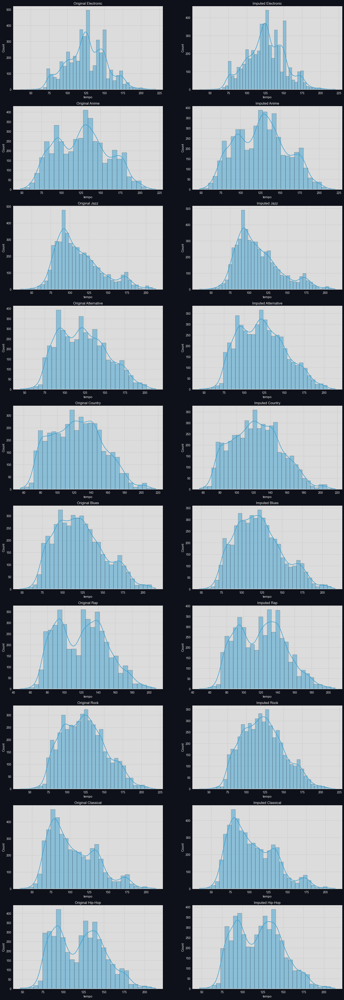

In [91]:
imputeHists_KNN_tempo_compare = plotForImpute(df_vis , 'tempo', df_impute_knn, ['Original ','Imputed '])

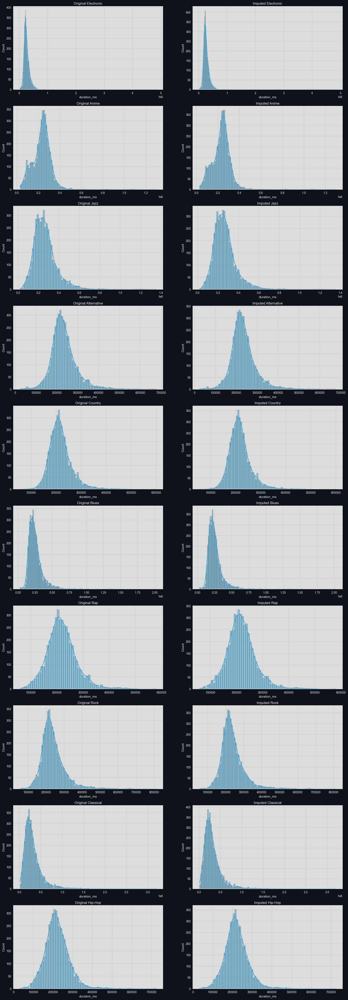

In [92]:
imputeHists_KNN_duration_ms_compare = plotForImpute(df_vis , 'duration_ms', df_impute_knn, ['Original ','Imputed '])

From the histogram, we can see that the distribution of the data is quite the same as before. So we decided to use the KNNImputer to impute the missing values.

#### **Conclusion**

เนื่องจากการทำ Imputation ด้วย KNNImputer และ mice ได้ผลลัพธ์ที่ใกล้เคียงกับข้อมูลตั้งต้นมาก เราจะพิจารณาถึง Histogram ของข้อมูลโดยรวมและ Outlier ของข้อมูลเพิ่มเติม

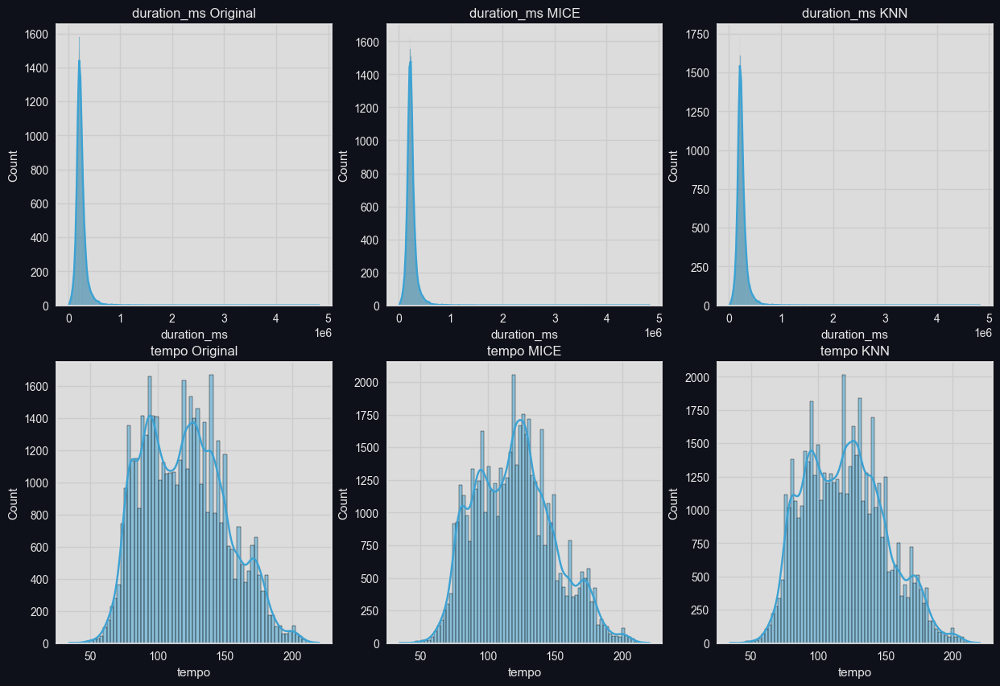

In [93]:
coltoplot = ['duration_ms','tempo']
dftoplot = [df_vis, df_impute_mice, df_impute_knn]
titlelist = ['Original','MICE','KNN']
NumHists_knn, axes = plt.subplots(2, 3, figsize=(15, 10))
for i, df in enumerate(dftoplot):
    for j, col in enumerate(coltoplot):
        ax = axes[j, i]
        sns.histplot(df[col], ax=ax, color=snsPalette[0], kde=True)
        ax.set_title(f'{col} '+titlelist[i])
        ax.set_xlabel(col)
        ax.set_ylabel('Count')
        ax.set_facecolor(axBGColor)

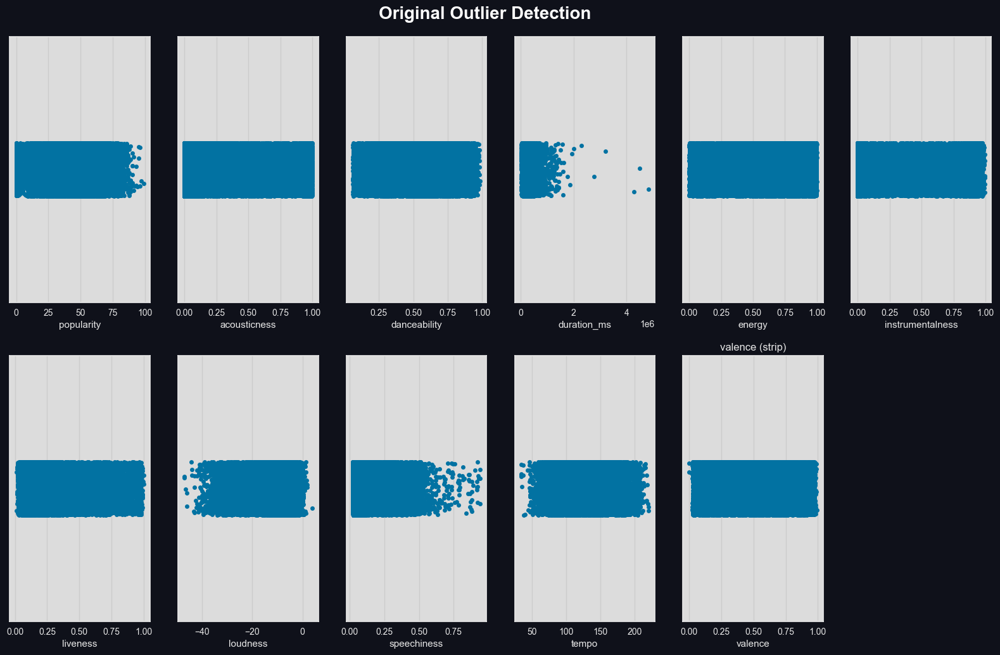

In [94]:
outlierplotstripOriginal = plotoutlierBarStrip(df_vis, 'Original','strip','notdetail')

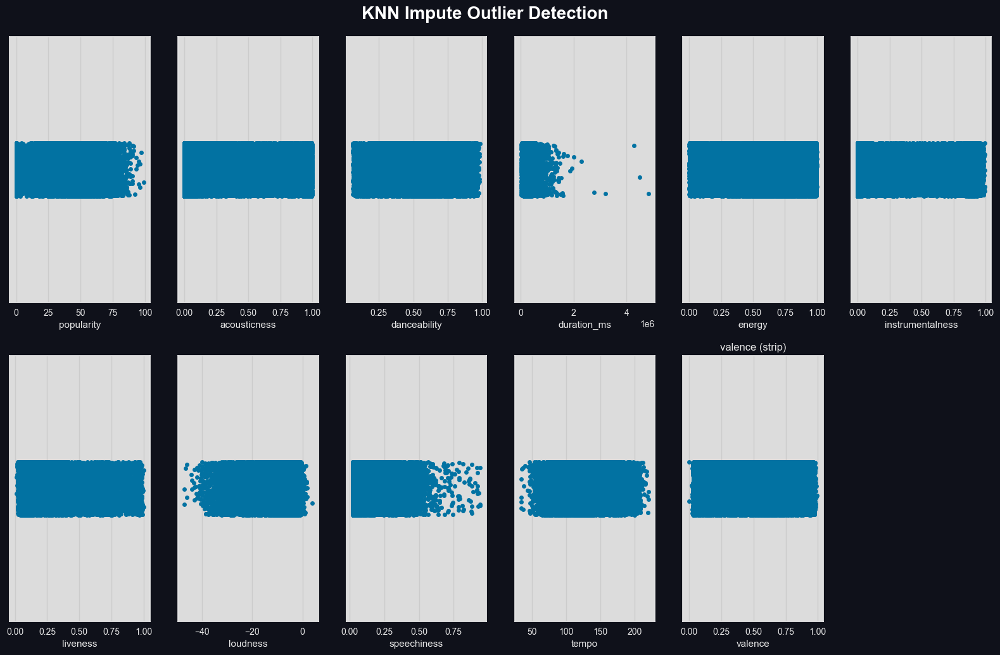

In [95]:
outlierplotstripMice = plotoutlierBarStrip(df_impute_mice, 'KNN Impute','strip','notdetail')

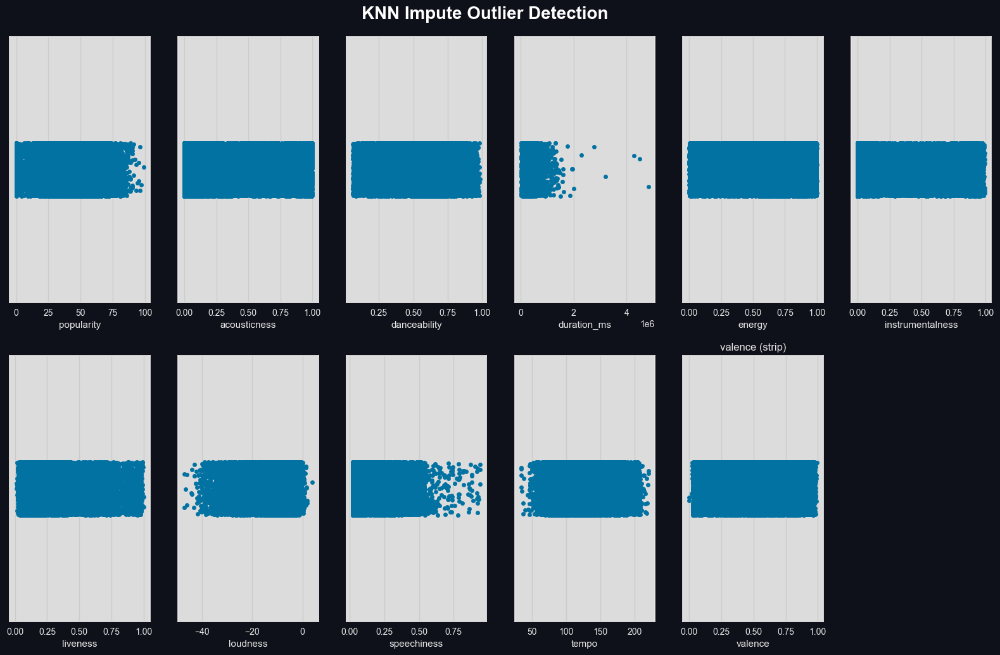

In [96]:
outlierplotstripKNNimpute = plotoutlierBarStrip(df_impute_knn, 'KNN Impute','strip','notdetail')

หลังจากพิจารณา Histogram ของข้อมูลโดยรวมและ Outlier ของข้อมูลแล้วพอว่าผลลัพธ์ที่ได้จากการทำ Imputation ด้วย KNNImputer มีความถูกต้องมากกว่าการทำ Imputation ด้วย Mean, Most Frequent และ mice จึงเลือกใช้ KNNImputer ในการทำ Imputation เป็นผลลัพธ์สุดท้าย

In [97]:
df_impute_knn.to_csv('Data/df_impute_knn.csv', index=False)

### **Remove Outlier**

##### **Import Data**

In [98]:
df = pd.read_csv('Data/df_impute_knn.csv')
dfNum = df.select_dtypes(include=['float64'])
dfCate = df.select_dtypes(include=['object'])
dfOutlier = df.copy()
df.head()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,key,mode,music_genre
0,27.0,0.00468,0.652,265662.333333,0.941,0.79200,0.115,-5.201,0.0748,100.889,0.759,A#,Minor,Electronic
1,31.0,0.01270,0.622,218293.000000,0.890,0.95000,0.124,-7.043,0.0300,115.002,0.531,D,Minor,Electronic
2,28.0,0.00306,0.620,215613.000000,0.755,0.01180,0.534,-4.617,0.0345,127.994,0.333,G#,Major,Electronic
3,34.0,0.02540,0.774,166875.000000,0.700,0.00253,0.157,-4.498,0.2390,128.014,0.270,C#,Major,Electronic
4,32.0,0.00465,0.638,222369.000000,0.587,0.90900,0.157,-6.266,0.0413,145.036,0.323,F#,Major,Electronic


##### **Performance Benchmark**

In [99]:
modelBM, resultBM, confmatrixBM, f1BM = modelTestProcess(df, getdummy=1)

Logistic Regression Model (F1 score) : 0.524447965191827
Decision Tree Model (F1 score) : 0.44075530167155413
Random Forest Model (F1 score) : 0.5471645226550553
KNN Model (F1 score) : 0.47193630572630274
MLPC Model (F1 score) : 0.5821545904941349


We will be removing the outliers from the dataset using Anomaly Detection with Isolation Forest Algorithm, Local Outlier Factor Algorithm and KNN Algorithm.

#### **Isolation Forest**

In [100]:
dfOutlier_IF = dfOutlier.copy()
dfOutlier_IF

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,key,mode,music_genre
0,27.0,0.00468,0.652,265662.333333,0.941,0.79200,0.115,-5.201,0.0748,100.889,0.759,A#,Minor,Electronic
1,31.0,0.01270,0.622,218293.000000,0.890,0.95000,0.124,-7.043,0.0300,115.002,0.531,D,Minor,Electronic
2,28.0,0.00306,0.620,215613.000000,0.755,0.01180,0.534,-4.617,0.0345,127.994,0.333,G#,Major,Electronic
3,34.0,0.02540,0.774,166875.000000,0.700,0.00253,0.157,-4.498,0.2390,128.014,0.270,C#,Major,Electronic
4,32.0,0.00465,0.638,222369.000000,0.587,0.90900,0.157,-6.266,0.0413,145.036,0.323,F#,Major,Electronic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,59.0,0.03340,0.913,210142.333333,0.574,0.00000,0.119,-7.022,0.2980,98.028,0.330,C#,Major,Hip-Hop
49996,72.0,0.15700,0.709,251860.000000,0.362,0.00000,0.109,-9.814,0.0550,122.043,0.113,B,Major,Hip-Hop
49997,51.0,0.00597,0.693,189483.000000,0.763,0.00000,0.143,-5.443,0.1460,131.079,0.395,D,Major,Hip-Hop
49998,65.0,0.08310,0.782,262773.000000,0.472,0.00000,0.106,-5.016,0.0441,75.886,0.354,G,Minor,Hip-Hop


##### **Search for Hyperparameter**

In [101]:
def IFparamtuning(df,param,getdummy=0,verbose=0,n_estimators=[100],contamination=['auto'],max_features=[1.0]):
    verboseprint = print if verbose==1 else lambda *a, **k: None
    df_model = df.copy()
    if getdummy == 1:
        df_model = pd.get_dummies(df_model, columns=['key','mode'],drop_first=True)
    X = df_model.drop(['music_genre'], axis=1)
    y = df_model['music_genre']
    # Scaling
    scaler = StandardScaler()
    X = scaler.fit_transform(X)
    iteration = 1
    bestscore = 0
    bestmodel = None
    bestparam = None
    classreport = None
    print(f'All parameters are {param}') 
    for key, value in param.items():
        if key == 'n_estimators':
            n_estimators = value
        elif key == 'contamination':
            contamination = value
        elif key == 'max_features':
            max_features = value
    print(f'Number of Iteration: {len(n_estimators)*len(contamination)*len(max_features)}')
    print('-'*50)
    for i in n_estimators:
        for j in contamination:
            for k in max_features:
                verboseprint(f'Iteration number :{iteration}')
                verboseprint(f'n_estimators = {i}, contamination = {j}, max_features = {k}')
                IF_clf = IsolationForest(n_estimators=i, contamination=j, max_features=k, n_jobs=-1, random_state=1)
                IF_clf.fit(X)
                df_model['anomaly'] = IF_clf.predict(X)
                outliers = df_model[df_model['anomaly'] == -1]
                outlier_index = list(outliers.index)
                verboseprint(f'Number of outliers is {len(outlier_index)}')
                df_score = df_model[df_model['anomaly'] == 1].drop(['anomaly'], axis=1)
                df_model = df_model.drop('anomaly', axis=1)
                RF_clf = RandomForestClassifier(n_jobs=-1, random_state=1)
                X_score = df_score.drop(['music_genre'], axis=1)
                y_score = df_score['music_genre']
                # Scaling
                scalerScore = StandardScaler()
                X_score = scalerScore.fit_transform(X_score)
                # Splitting
                X_train, X_test, y_train, y_test = train_test_split(X_score, y_score, test_size=0.2, random_state=1)
                # Training
                RF_clf = RF_clf.fit(X_train, y_train)
                # Testing
                y_pred = RF_clf.predict(X_test)
                f1score = f1_score(y_test, y_pred, average='weighted')
                classreport = classification_report(y_test, y_pred)
                verboseprint(f'F1 score of Random Forest Model is {f1score}\n','-'*50)
                if f1score > bestscore:
                    bestscore = f1score
                    bestparam = {'n_estimators':i,'contamination':j,'max_features':k}
                    bestmodel = IF_clf
                iteration += 1
    print(f'Best score is {bestscore} with parameters {bestparam}')
    print(f'Best model is {bestmodel}')
    return bestparam,classreport,bestmodel

In [102]:
""""
'n_estimators':list(range(10,110,10))
'contamination':['auto',0.01, 0.02, 0.03]
Best score is 0.5538827260767094 with parameters {'n_estimators': 20, 'contamination': 0.01, 'max_features': 1.0}
Best model is IsolationForest(contamination=0.01, n_estimators=20, n_jobs=-1, random_state=1)

{'n_estimators':[20],
'contamination':[0.01],
'max_features':list(range(1,21,1))
Best score is 0.55187532899251 with parameters {'n_estimators': 20, 'contamination': 0.01, 'max_features': 2}
Best model is IsolationForest(contamination=0.01, max_features=2, n_estimators=20, n_jobs=-1,
                random_state=1)
"""
# list(range(10,110,10))
# parm,rep,mo = IFparamtuning(dfOutlier_IF,{'n_estimators':[10, 20, 30, 40, 50],
#                                         'contamination':['auto',0.01, 0.02, 0.03],
#                                         getdummy=1,
#                                         verbose=1)
pass

In [103]:
dfOutlier_IF_find = dfOutlier_IF.copy()
dfOutlier_IF_find = pd.get_dummies(dfOutlier_IF_find, columns=['key','mode'],drop_first=True)
X = dfOutlier_IF_find.drop(['music_genre'], axis=1)
y = dfOutlier_IF_find['music_genre']
toend = ['Electronic', 'Anime', 'Jazz', 'Alternative', 'Country', 'Rap',
       'Blues', 'Rock', 'Classical', 'Hip-Hop']
coltoend = [['music_genre']]
y = y.apply(lambda x: toend.index(x))

IF_clf = IsolationForest(n_jobs=-1, random_state=1)

minrange =10
maxrange = 110
step = 10
param_grid = {
              # 'n_estimators': list(range(minrange,maxrange,step)), 
              # 'max_samples': list(range(100, 500, 5)), 
              'contamination': [0.1, 0.2, 0.3, 0.4, 0.5], 
              # 'max_features': [15,20],
              }

scoring = {'f1score':make_scorer(f1_score,average='weighted')}
# scoring = {'Recall': make_scorer(recall_score, pos_label=-1, average='weighted')
#           ,'f1score': make_scorer(f1_score, pos_label=-1, average='weighted')}
# ,'AUC': make_scorer(roc_auc_score,
#                                 average='weighted',
#                                 multi_class='ovr',
#                                 labels=[0, 1, 2, 3, 4, 5, 6, 7, 8, 9])}                                       

grid_dt_estimator = GridSearchCV(IF_clf, 
                                param_grid,
                                scoring=scoring, 
                                refit='f1score',
                                cv=4,
                                n_jobs=-1,
                                return_train_score=True
                                )

In [104]:
'''

Fitting 4 folds for each of 15 candidates, totalling 60 fits
tuned hpyerparameters :(best parameters)  {'max_features': 15, 'n_estimators': 140}
score : 0.05262386217850815

Fitting 4 folds for each of 18 candidates, totalling 72 fits
tuned hpyerparameters :(best parameters)  {'max_features': 15, 'n_estimators': 150}
score : 0.05270171149144254

Fitting 4 folds for each of 20 candidates, totalling 80 fits
tuned hpyerparameters :(best parameters)  {'max_features': 20, 'n_estimators': 100}
score : 0.05414193867457961

'''
# grid_dt_estimator.fit(X, y)
# print("tuned hpyerparameters :(best parameters) ",grid_dt_estimator.best_params_)
# print("score :",grid_dt_estimator.best_score_)
# results = grid_dt_estimator.cv_results_
pass

##### **Remove outlier**

In [105]:
X = dfOutlier_IF.copy()
y = X['music_genre']
X = pd.get_dummies(X, columns=['key','mode'], drop_first=True).drop(['music_genre'], axis=1)
scaler_IF = StandardScaler()
X = scaler_IF.fit_transform(X)

In [106]:
IF_clf = IsolationForest(n_estimators=20, contamination=0.01, n_jobs=-1, random_state=1)
IF_clf = IF_clf.fit(X,y)

In [107]:
dfOutlier_IF['anomalyscore'] = IF_clf.score_samples(X)
dfOutlier_IF['anomaly']= IF_clf.predict(X)
dfOutlier_IF

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,key,mode,music_genre,anomalyscore,anomaly
0,27.0,0.00468,0.652,265662.333333,0.941,0.79200,0.115,-5.201,0.0748,100.889,0.759,A#,Minor,Electronic,-0.483615,1
1,31.0,0.01270,0.622,218293.000000,0.890,0.95000,0.124,-7.043,0.0300,115.002,0.531,D,Minor,Electronic,-0.517061,1
2,28.0,0.00306,0.620,215613.000000,0.755,0.01180,0.534,-4.617,0.0345,127.994,0.333,G#,Major,Electronic,-0.450166,1
3,34.0,0.02540,0.774,166875.000000,0.700,0.00253,0.157,-4.498,0.2390,128.014,0.270,C#,Major,Electronic,-0.378085,1
4,32.0,0.00465,0.638,222369.000000,0.587,0.90900,0.157,-6.266,0.0413,145.036,0.323,F#,Major,Electronic,-0.517650,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,59.0,0.03340,0.913,210142.333333,0.574,0.00000,0.119,-7.022,0.2980,98.028,0.330,C#,Major,Hip-Hop,-0.407122,1
49996,72.0,0.15700,0.709,251860.000000,0.362,0.00000,0.109,-9.814,0.0550,122.043,0.113,B,Major,Hip-Hop,-0.490252,1
49997,51.0,0.00597,0.693,189483.000000,0.763,0.00000,0.143,-5.443,0.1460,131.079,0.395,D,Major,Hip-Hop,-0.427725,1
49998,65.0,0.08310,0.782,262773.000000,0.472,0.00000,0.106,-5.016,0.0441,75.886,0.354,G,Minor,Hip-Hop,-0.419981,1


In [108]:
outliers=dfOutlier_IF.loc[dfOutlier_IF['anomaly']==-1]
outlier_index=list(outliers.index)
print(dfOutlier_IF['anomaly'].value_counts())
outliers

 1    49500
-1      500
Name: anomaly, dtype: int64


,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,key,mode,music_genre,anomalyscore,anomaly
288,34.0,0.01420,0.569,159880.0,0.988,0.920000,0.6320,-4.021,0.3760,126.150333,0.1420,F#,Minor,Electronic,-0.552367,-1
373,46.0,0.71600,0.589,366970.0,0.587,0.845000,0.1000,-14.527,0.3080,149.024000,0.5680,F#,Minor,Electronic,-0.580265,-1
614,37.0,0.00161,0.889,860761.0,0.480,0.835000,0.0514,-12.380,0.0747,100.002000,0.0751,A#,Minor,Electronic,-0.569811,-1
695,35.0,0.49400,0.247,207960.0,0.296,0.049100,0.0763,-13.472,0.0437,184.154000,0.1230,B,Minor,Electronic,-0.572137,-1
854,34.0,0.00519,0.621,274467.0,0.903,0.930000,0.1210,-9.548,0.1390,107.002000,0.5250,F#,Major,Electronic,-0.552307,-1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48252,64.0,0.81900,0.471,243724.0,0.784,0.000011,0.1070,-8.250,0.8830,160.833000,0.2580,B,Minor,Hip-Hop,-0.568867,-1
49083,60.0,0.71400,0.802,206811.0,0.616,0.000000,0.0929,-9.740,0.7120,91.894000,0.6060,D,Major,Hip-Hop,-0.553294,-1
49430,48.0,0.79300,0.589,52907.0,0.391,0.000000,0.9320,-15.681,0.9320,89.046000,0.7210,F#,Minor,Hip-Hop,-0.577240,-1
49650,53.0,0.47000,0.633,59118.0,0.506,0.000000,0.9590,-16.808,0.8630,112.074667,0.7840,C#,Major,Hip-Hop,-0.557180,-1


In [109]:
df_outliertest_IF = dfOutlier_IF[dfOutlier_IF['anomaly']==1].drop(['anomaly','anomalyscore'], axis=1)
df_outliertest_IF.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 49500 entries, 0 to 49999
Data columns (total 14 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   popularity        49500 non-null  float64
 1   acousticness      49500 non-null  float64
 2   danceability      49500 non-null  float64
 3   duration_ms       49500 non-null  float64
 4   energy            49500 non-null  float64
 5   instrumentalness  49500 non-null  float64
 6   liveness          49500 non-null  float64
 7   loudness          49500 non-null  float64
 8   speechiness       49500 non-null  float64
 9   tempo             49500 non-null  float64
 10  valence           49500 non-null  float64
 11  key               49500 non-null  object 
 12  mode              49500 non-null  object 
 13  music_genre       49500 non-null  object 
dtypes: float64(11), object(3)
memory usage: 5.7+ MB


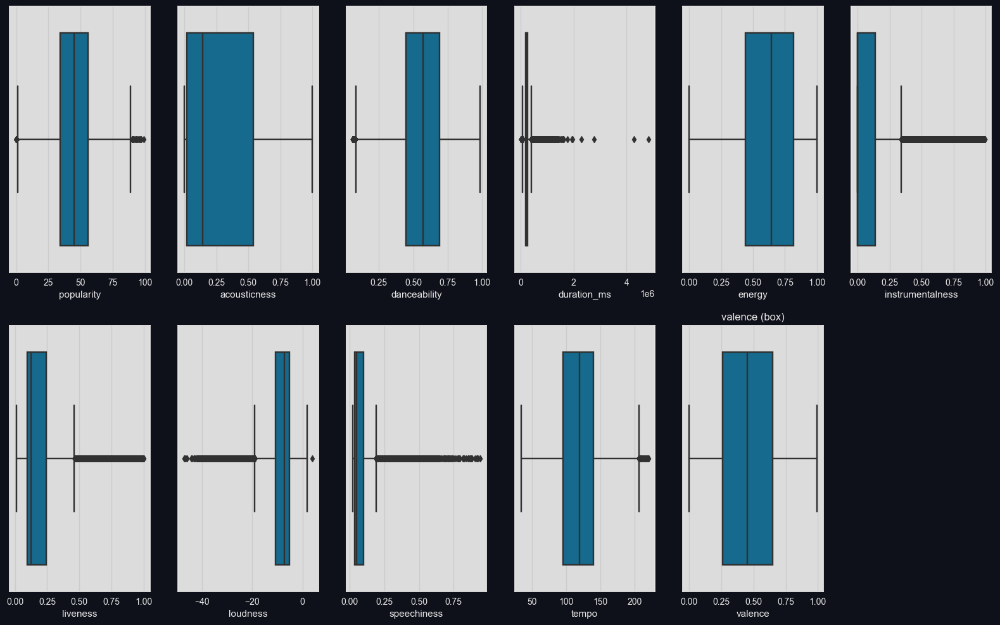

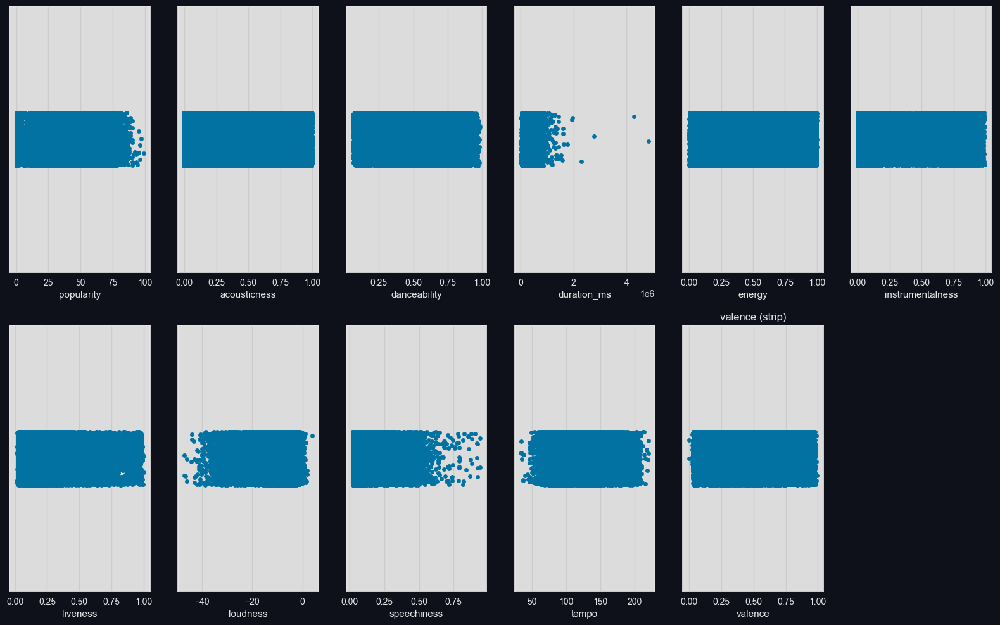

In [110]:
outlierplotboxALL, axes = plt.subplots(2, 6, figsize=(20, 12))
outlierplotboxALL.delaxes(axes[1,5])
for idx, col in enumerate(dfNum.columns):
    sns.boxplot(x=df_outliertest_IF[col],ax=axes[idx//6, idx%6])
    plt.title(col + ' (box)')
outlierplotstripALL, axes = plt.subplots(2, 6, figsize=(20, 12))
outlierplotstripALL.delaxes(axes[1,5])
for idx, col in enumerate(dfNum.columns):
    sns.stripplot(x=df_outliertest_IF[col],ax=axes[idx//6, idx%6])
    plt.title(col + ' (strip)')

##### **Performance**

In [111]:
modelBM_IF, resultBM_IF, confmatrixBM_IF, f1BM_IF = modelTestProcess(df_outliertest_IF, getdummy=1)

Logistic Regression Model (F1 score) : 0.5289420692335385
Decision Tree Model (F1 score) : 0.44370417825324693
Random Forest Model (F1 score) : 0.5500204039684669
KNN Model (F1 score) : 0.46712937911671276
MLPC Model (F1 score) : 0.5714024337810822


#### **Local Outlier Factor**

In [112]:
from sklearn.neighbors import LocalOutlierFactor
dfOutlier_LOF = dfOutlier.copy()
dfOutlier_LOF = pd.get_dummies(dfOutlier_LOF, columns=['key','mode'], drop_first=True)
dfOutlier_LOF

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,...,key_C,key_C#,key_D,key_D#,key_E,key_F,key_F#,key_G,key_G#,mode_Minor
0,27.0,0.00468,0.652,265662.333333,0.941,0.79200,0.115,-5.201,0.0748,100.889,...,0,0,0,0,0,0,0,0,0,1
1,31.0,0.01270,0.622,218293.000000,0.890,0.95000,0.124,-7.043,0.0300,115.002,...,0,0,1,0,0,0,0,0,0,1
2,28.0,0.00306,0.620,215613.000000,0.755,0.01180,0.534,-4.617,0.0345,127.994,...,0,0,0,0,0,0,0,0,1,0
3,34.0,0.02540,0.774,166875.000000,0.700,0.00253,0.157,-4.498,0.2390,128.014,...,0,1,0,0,0,0,0,0,0,0
4,32.0,0.00465,0.638,222369.000000,0.587,0.90900,0.157,-6.266,0.0413,145.036,...,0,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,59.0,0.03340,0.913,210142.333333,0.574,0.00000,0.119,-7.022,0.2980,98.028,...,0,1,0,0,0,0,0,0,0,0
49996,72.0,0.15700,0.709,251860.000000,0.362,0.00000,0.109,-9.814,0.0550,122.043,...,0,0,0,0,0,0,0,0,0,0
49997,51.0,0.00597,0.693,189483.000000,0.763,0.00000,0.143,-5.443,0.1460,131.079,...,0,0,1,0,0,0,0,0,0,0
49998,65.0,0.08310,0.782,262773.000000,0.472,0.00000,0.106,-5.016,0.0441,75.886,...,0,0,0,0,0,0,0,1,0,1


##### **Search for Hyperparameter**

In [113]:
# Impute missing values
dfOutlier_LOF_find = dfOutlier_LOF.copy()
X = dfOutlier_LOF_find.drop(['music_genre'], axis=1)
y = dfOutlier_LOF_find['music_genre']
colX = X.columns
toend = ['Electronic', 'Anime', 'Jazz', 'Alternative', 'Country', 'Rap',
       'Blues', 'Rock', 'Classical', 'Hip-Hop']
coltoend = [['music_genre']]
y = y.apply(lambda x: toend.index(x))
scalerLOF = StandardScaler()
X = scalerLOF.fit_transform(X)

KN_LOF_param = [{ 
              'n_neighbors' : range(10,60,10),
              # 'algorithm' : ['auto', 'ball_tree', 'kd_tree', 'brute'],
              # 'leaf_size' : range(10,60,10),
              }]

KN_LOF_clf = KNeighborsClassifier(n_jobs=-1,algorithm='ball_tree')

f1sc = make_scorer(f1_score, average='weighted')

grid_KN_LOF_clf = GridSearchCV(KN_LOF_clf, 
                        KN_LOF_param,
                        scoring=f1sc, 
                        refit=True,
                        cv=4,
                        n_jobs=-1,
                        verbose=3,
                        return_train_score=True)

In [114]:
# grid_KN_LOF_clf.fit(X, y)
# print("tuned hpyerparameters :(best parameters) ",grid_KN_LOF_clf.best_params_)
# print("score :",grid_KN_LOF_clf.best_score_)

"""
Fitting 4 folds for each of 4 candidates, totalling 16 fits
tuned hpyerparameters :(best parameters)  {'algorithm': 'ball_tree'}
score : 0.4638039248476319

Fitting 4 folds for each of 5 candidates, totalling 20 fits
tuned hpyerparameters :(best parameters)  {'n_neighbors': 20}
score : 0.4852892750123391
"""
pass

##### **Remove outlier**

In [115]:
X = dfOutlier_LOF.drop(['music_genre'], axis=1)
y = dfOutlier_LOF['music_genre']
colX = X.columns
scalerLOF = StandardScaler()
X = scalerLOF.fit_transform(X)

clf_LOF = LocalOutlierFactor(n_neighbors=20, algorithm='ball_tree', n_jobs=-1)
clf_LOF.fit_predict(X)
lof_LOF  = clf_LOF.negative_outlier_factor_

In [116]:
thresh_LOF = np.quantile(lof_LOF, .03)
dfoutlier_LOF = dfOutlier_LOF[lof_LOF <= thresh_LOF]
dfNormal_LOF = dfOutlier_LOF[lof_LOF > thresh_LOF]
print(thresh_LOF)
dfNormal_LOF

-1.3476365914081732


,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,...,key_C,key_C#,key_D,key_D#,key_E,key_F,key_F#,key_G,key_G#,mode_Minor
0,27.0,0.00468,0.652,265662.333333,0.941,0.79200,0.115,-5.201,0.0748,100.889,...,0,0,0,0,0,0,0,0,0,1
1,31.0,0.01270,0.622,218293.000000,0.890,0.95000,0.124,-7.043,0.0300,115.002,...,0,0,1,0,0,0,0,0,0,1
2,28.0,0.00306,0.620,215613.000000,0.755,0.01180,0.534,-4.617,0.0345,127.994,...,0,0,0,0,0,0,0,0,1,0
3,34.0,0.02540,0.774,166875.000000,0.700,0.00253,0.157,-4.498,0.2390,128.014,...,0,1,0,0,0,0,0,0,0,0
4,32.0,0.00465,0.638,222369.000000,0.587,0.90900,0.157,-6.266,0.0413,145.036,...,0,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,59.0,0.03340,0.913,210142.333333,0.574,0.00000,0.119,-7.022,0.2980,98.028,...,0,1,0,0,0,0,0,0,0,0
49996,72.0,0.15700,0.709,251860.000000,0.362,0.00000,0.109,-9.814,0.0550,122.043,...,0,0,0,0,0,0,0,0,0,0
49997,51.0,0.00597,0.693,189483.000000,0.763,0.00000,0.143,-5.443,0.1460,131.079,...,0,0,1,0,0,0,0,0,0,0
49998,65.0,0.08310,0.782,262773.000000,0.472,0.00000,0.106,-5.016,0.0441,75.886,...,0,0,0,0,0,0,0,1,0,1


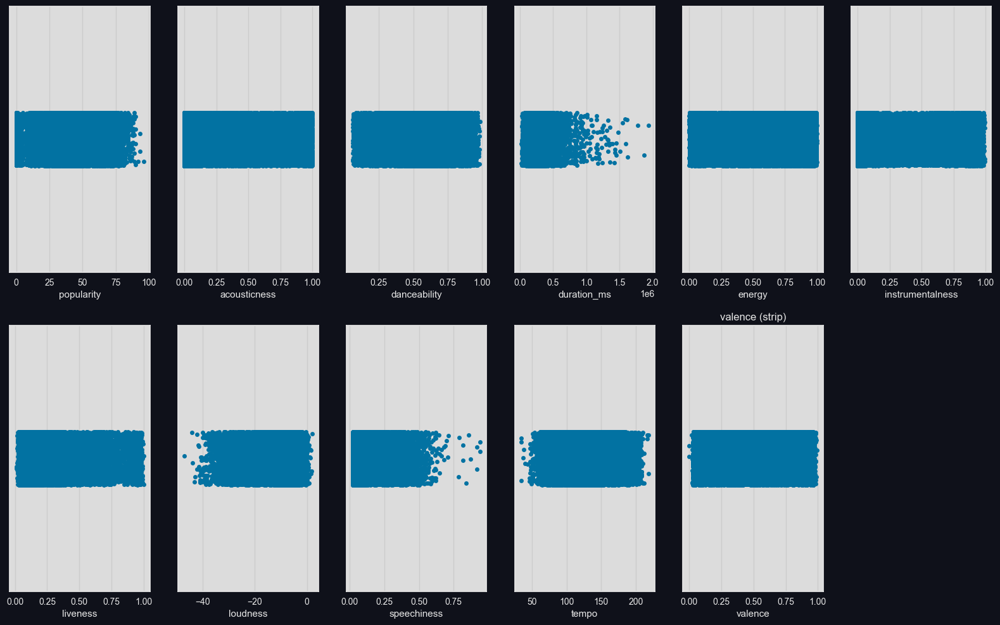

In [117]:
outlierplotstripALL, axes = plt.subplots(2, 6, figsize=(20, 12))
outlierplotstripALL.delaxes(axes[1,5])
for idx, col in enumerate(dfNum.columns):
    sns.stripplot(x=dfNormal_LOF[col],ax=axes[idx//6, idx%6])
    plt.title(col + ' (strip)')

##### **Performance**

In [118]:
modelBM_LOF, resultBM_LOF, confmatrixBM_LOF, f1BM_LOF = modelTestProcess(dfNormal_LOF, getdummy=0)

Logistic Regression Model (F1 score) : 0.5357630309884516
Decision Tree Model (F1 score) : 0.4436429258486196
Random Forest Model (F1 score) : 0.5509402128633895
KNN Model (F1 score) : 0.4709673156959691
MLPC Model (F1 score) : 0.582190201113514


#### **Nearest Neighbors**

In [119]:
# create arrays
dfnbrs = dfOutlier.copy()
dfnbrsOrig = dfnbrs.copy()
# Unsupervised learning we consider all features even the target
X = pd.get_dummies(dfnbrs, columns=['key','mode','music_genre'], drop_first=True)
X

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,...,mode_Minor,music_genre_Anime,music_genre_Blues,music_genre_Classical,music_genre_Country,music_genre_Electronic,music_genre_Hip-Hop,music_genre_Jazz,music_genre_Rap,music_genre_Rock
0,27.0,0.00468,0.652,265662.333333,0.941,0.79200,0.115,-5.201,0.0748,100.889,...,1,0,0,0,0,1,0,0,0,0
1,31.0,0.01270,0.622,218293.000000,0.890,0.95000,0.124,-7.043,0.0300,115.002,...,1,0,0,0,0,1,0,0,0,0
2,28.0,0.00306,0.620,215613.000000,0.755,0.01180,0.534,-4.617,0.0345,127.994,...,0,0,0,0,0,1,0,0,0,0
3,34.0,0.02540,0.774,166875.000000,0.700,0.00253,0.157,-4.498,0.2390,128.014,...,0,0,0,0,0,1,0,0,0,0
4,32.0,0.00465,0.638,222369.000000,0.587,0.90900,0.157,-6.266,0.0413,145.036,...,0,0,0,0,0,1,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49995,59.0,0.03340,0.913,210142.333333,0.574,0.00000,0.119,-7.022,0.2980,98.028,...,0,0,0,0,0,0,1,0,0,0
49996,72.0,0.15700,0.709,251860.000000,0.362,0.00000,0.109,-9.814,0.0550,122.043,...,0,0,0,0,0,0,1,0,0,0
49997,51.0,0.00597,0.693,189483.000000,0.763,0.00000,0.143,-5.443,0.1460,131.079,...,0,0,0,0,0,0,1,0,0,0
49998,65.0,0.08310,0.782,262773.000000,0.472,0.00000,0.106,-5.016,0.0441,75.886,...,1,0,0,0,0,0,1,0,0,0


โดยจะใช้ HYPERPARAMETER ที่ได้จาก Section ที่แล้ว คือ n_neighbors = 20, algorithm = 'ball_tree'

##### **Remove outlier**

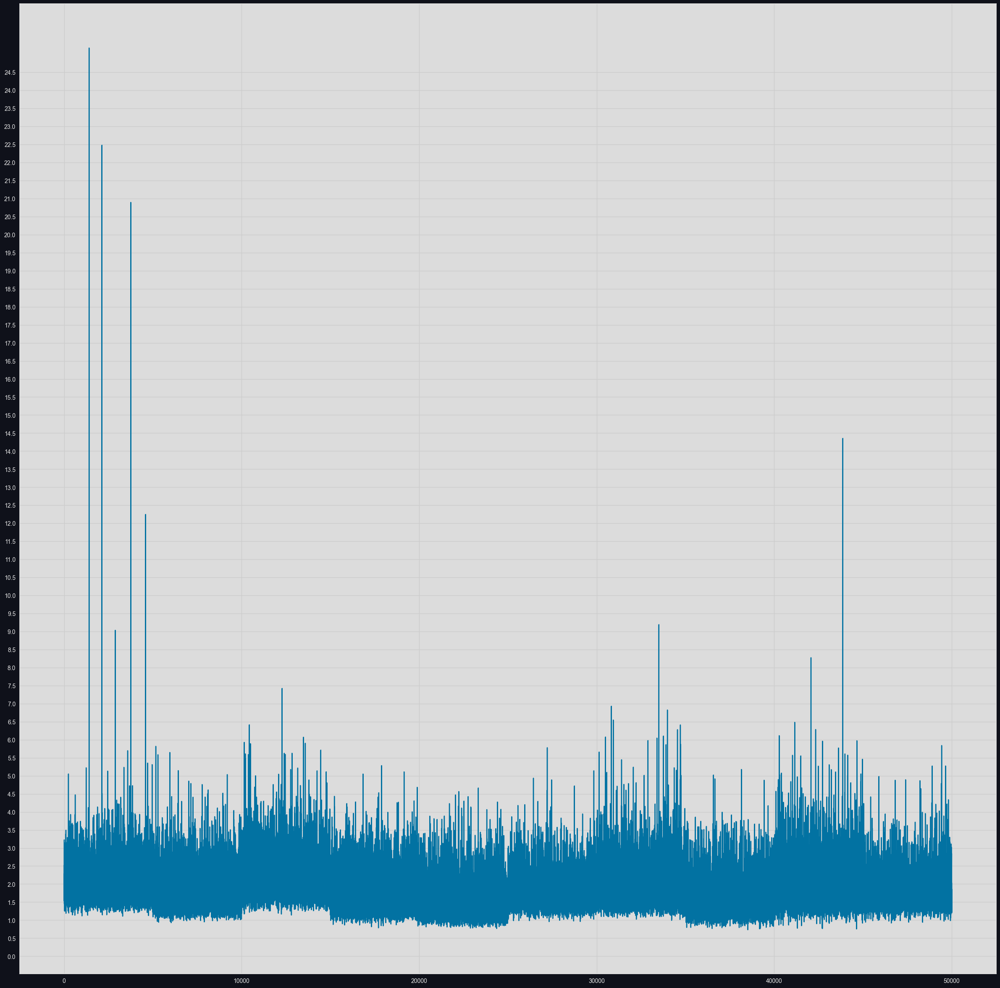

In [120]:
# instantiate model
scaler = StandardScaler()
X = scaler.fit_transform(X)
nbrs = NearestNeighbors(n_jobs=-1,n_neighbors=20,algorithm='ball_tree').fit(X)
# distances and indexes of k-neaighbors from model outputs
distances, indexes = nbrs.kneighbors(X)
# plot mean of k-distances of each observation
anomalyPlot, ax = plt.subplots(1, 1, figsize=(30, 30))
ax.set_yticks(np.arange(0, 25, 0.5))
ax.plot(distances.mean(axis =1))

In [121]:
# visually determine cutoff values > 2.8
outlier_index = np.where(distances.mean(axis = 1) > 2.8)
# filter outlier values
outlier_values = dfnbrsOrig.iloc[outlier_index]
outlier_values

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,key,mode,music_genre
10,30.0,0.85500,0.607,170463.000000,0.158,0.000000,0.106,-13.787,0.0345,57.528000,0.307,F#,Minor,Electronic
16,59.0,0.13600,0.336,216077.666667,0.746,0.000000,0.737,-4.315,0.0685,151.756000,0.210,C#,Minor,Electronic
20,44.0,0.00804,0.516,241877.000000,0.920,0.614000,0.801,-4.370,0.0942,145.027000,0.332,A,Minor,Electronic
43,43.0,0.16900,0.685,219436.333333,0.909,0.000663,0.942,-7.627,0.0430,119.978000,0.962,C,Major,Electronic
60,27.0,0.21600,0.626,337091.000000,0.362,0.867000,0.681,-14.892,0.0479,109.948000,0.107,C,Major,Electronic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49880,49.0,0.01100,0.431,528880.000000,0.898,0.001150,0.523,-4.233,0.1660,96.701000,0.192,C#,Minor,Hip-Hop
49900,54.0,0.04200,0.688,185747.000000,0.723,0.874000,0.196,-5.259,0.0463,171.774000,0.959,A,Minor,Hip-Hop
49959,59.0,0.08470,0.929,215200.000000,0.737,0.000000,0.861,-6.424,0.1020,126.653667,0.886,G#,Major,Hip-Hop
49977,58.0,0.72300,0.541,197721.000000,0.399,0.000060,0.111,-10.414,0.1310,203.893000,0.392,B,Major,Hip-Hop


In [122]:
dropOutliers = outlier_index[0].tolist()
dfnbrsOrig.drop(dropOutliers, axis=0, inplace=True)
dfnbrsOrig.reset_index(drop=True, inplace=True)
dfnbrsOrig

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,key,mode,music_genre
0,27.0,0.00468,0.652,265662.333333,0.941,0.79200,0.115,-5.201,0.0748,100.889,0.759,A#,Minor,Electronic
1,31.0,0.01270,0.622,218293.000000,0.890,0.95000,0.124,-7.043,0.0300,115.002,0.531,D,Minor,Electronic
2,28.0,0.00306,0.620,215613.000000,0.755,0.01180,0.534,-4.617,0.0345,127.994,0.333,G#,Major,Electronic
3,34.0,0.02540,0.774,166875.000000,0.700,0.00253,0.157,-4.498,0.2390,128.014,0.270,C#,Major,Electronic
4,32.0,0.00465,0.638,222369.000000,0.587,0.90900,0.157,-6.266,0.0413,145.036,0.323,F#,Major,Electronic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
46472,59.0,0.03340,0.913,210142.333333,0.574,0.00000,0.119,-7.022,0.2980,98.028,0.330,C#,Major,Hip-Hop
46473,72.0,0.15700,0.709,251860.000000,0.362,0.00000,0.109,-9.814,0.0550,122.043,0.113,B,Major,Hip-Hop
46474,51.0,0.00597,0.693,189483.000000,0.763,0.00000,0.143,-5.443,0.1460,131.079,0.395,D,Major,Hip-Hop
46475,65.0,0.08310,0.782,262773.000000,0.472,0.00000,0.106,-5.016,0.0441,75.886,0.354,G,Minor,Hip-Hop


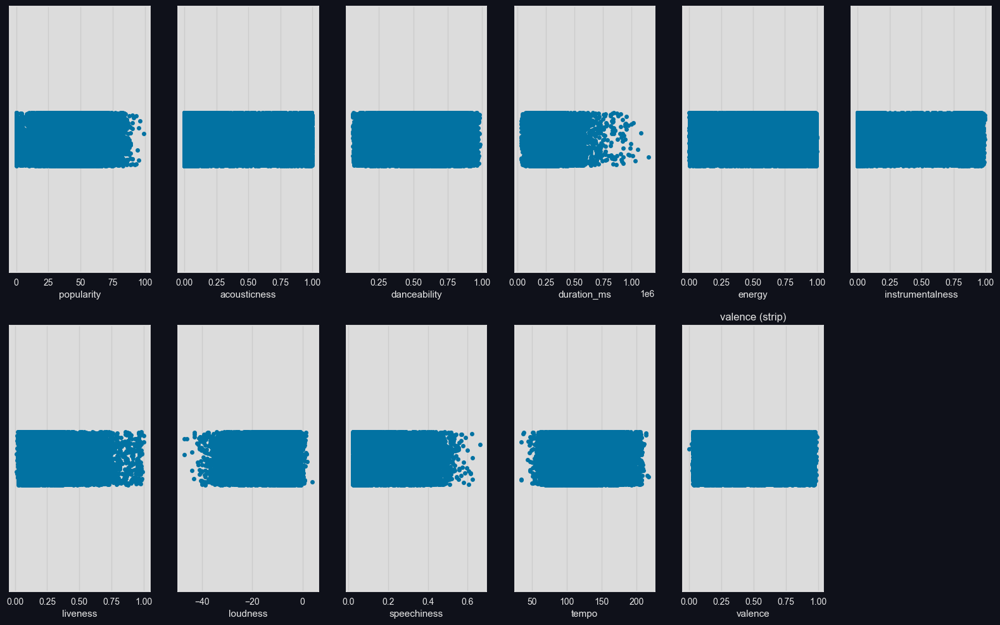

In [123]:
outlierplotstripALL, axes = plt.subplots(2, 6, figsize=(20, 12))
outlierplotstripALL.delaxes(axes[1,5])
for idx, col in enumerate(dfNum.columns):
    sns.stripplot(x=dfnbrsOrig[col],ax=axes[idx//6, idx%6])
    plt.title(col + ' (strip)')

##### **Performance**

In [124]:
modelBM_KN, resultBM_KN, confmatrixBM_KN, f1BM_KN = modelTestProcess(dfnbrsOrig, getdummy=1)

Logistic Regression Model (F1 score) : 0.5391570061625844
Decision Tree Model (F1 score) : 0.44469774223072245
Random Forest Model (F1 score) : 0.5567616271692278
KNN Model (F1 score) : 0.4779681649136388
MLPC Model (F1 score) : 0.5867948169999857


In [125]:
"""
BM
{'Logistic Regression Model': 0.524447965191827,
 'Decision Tree Model': 0.43945745895900645,
 'Random Forest Model': 0.5495947325317898,
 'KNN Model': 0.47201620184508275,
 'MLPC Model': 0.5820716052140181}

 K=5 th=3.5
 {'Logistic Regression Model': 0.5267810382941709,
 'Decision Tree Model': 0.44051382014335133,
 'Random Forest Model': 0.553135221178713,
 'KNN Model': 0.47181105767624826,
 'MLPC Model': 0.5644229849392003}

 K=20 th=2.5
 {'Logistic Regression Model': 0.5534657308220577,
 'Decision Tree Model': 0.45364463234145963,
 'Random Forest Model': 0.5591870916498062,
 'KNN Model': 0.4828599318951609,
 'MLPC Model': 0.5966668901650811}

  K=20 th=2.8
 {'Logistic Regression Model': 0.5391570061625844,
 'Decision Tree Model': 0.4440435845051865,
 'Random Forest Model': 0.5567451105220543,
 'KNN Model': 0.4779681649136388,
 'MLPC Model': 0.5853447432208643}

 K=20 th=3.0
{'Logistic Regression Model': 0.5416241410065534,
 'Decision Tree Model': 0.4450136318014417,
 'Random Forest Model': 0.5503797141498078,
 'KNN Model': 0.47676748749978265,
 'MLPC Model': 0.5778236970506728}

"""
pass

#### **Conclusion**

babababadbaba

In [126]:
dfOutlier_res = dfOutlier.copy()
dfOutlier_res = dfOutlier_res[lof_LOF > thresh_LOF]
dfOutlier_res.reset_index(drop=True, inplace=True)
dfOutlier_res

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence,key,mode,music_genre
0,27.0,0.00468,0.652,265662.333333,0.941,0.79200,0.115,-5.201,0.0748,100.889,0.759,A#,Minor,Electronic
1,31.0,0.01270,0.622,218293.000000,0.890,0.95000,0.124,-7.043,0.0300,115.002,0.531,D,Minor,Electronic
2,28.0,0.00306,0.620,215613.000000,0.755,0.01180,0.534,-4.617,0.0345,127.994,0.333,G#,Major,Electronic
3,34.0,0.02540,0.774,166875.000000,0.700,0.00253,0.157,-4.498,0.2390,128.014,0.270,C#,Major,Electronic
4,32.0,0.00465,0.638,222369.000000,0.587,0.90900,0.157,-6.266,0.0413,145.036,0.323,F#,Major,Electronic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48495,59.0,0.03340,0.913,210142.333333,0.574,0.00000,0.119,-7.022,0.2980,98.028,0.330,C#,Major,Hip-Hop
48496,72.0,0.15700,0.709,251860.000000,0.362,0.00000,0.109,-9.814,0.0550,122.043,0.113,B,Major,Hip-Hop
48497,51.0,0.00597,0.693,189483.000000,0.763,0.00000,0.143,-5.443,0.1460,131.079,0.395,D,Major,Hip-Hop
48498,65.0,0.08310,0.782,262773.000000,0.472,0.00000,0.106,-5.016,0.0441,75.886,0.354,G,Minor,Hip-Hop


In [127]:
dfOutlier_res.to_csv('Data/dfOutlier_res.csv', index=False)

### **Data Transformation**

#### **Import Data**

In [128]:
df = pd.read_csv('Data/dfOutlier_res.csv')
dfNum = df.select_dtypes(include=['float64'])
dfCate = df.select_dtypes(include=['object'])

#### **Performance Benchmark**

In [129]:
modelBM, resultBM, confmatrixBM, f1BM = modelTestProcess(df, getdummy=1)

Logistic Regression Model (F1 score) : 0.5357630309884516
Decision Tree Model (F1 score) : 0.4436429258486196
Random Forest Model (F1 score) : 0.5509402128633895
KNN Model (F1 score) : 0.4709673156959691
MLPC Model (F1 score) : 0.582190201113514


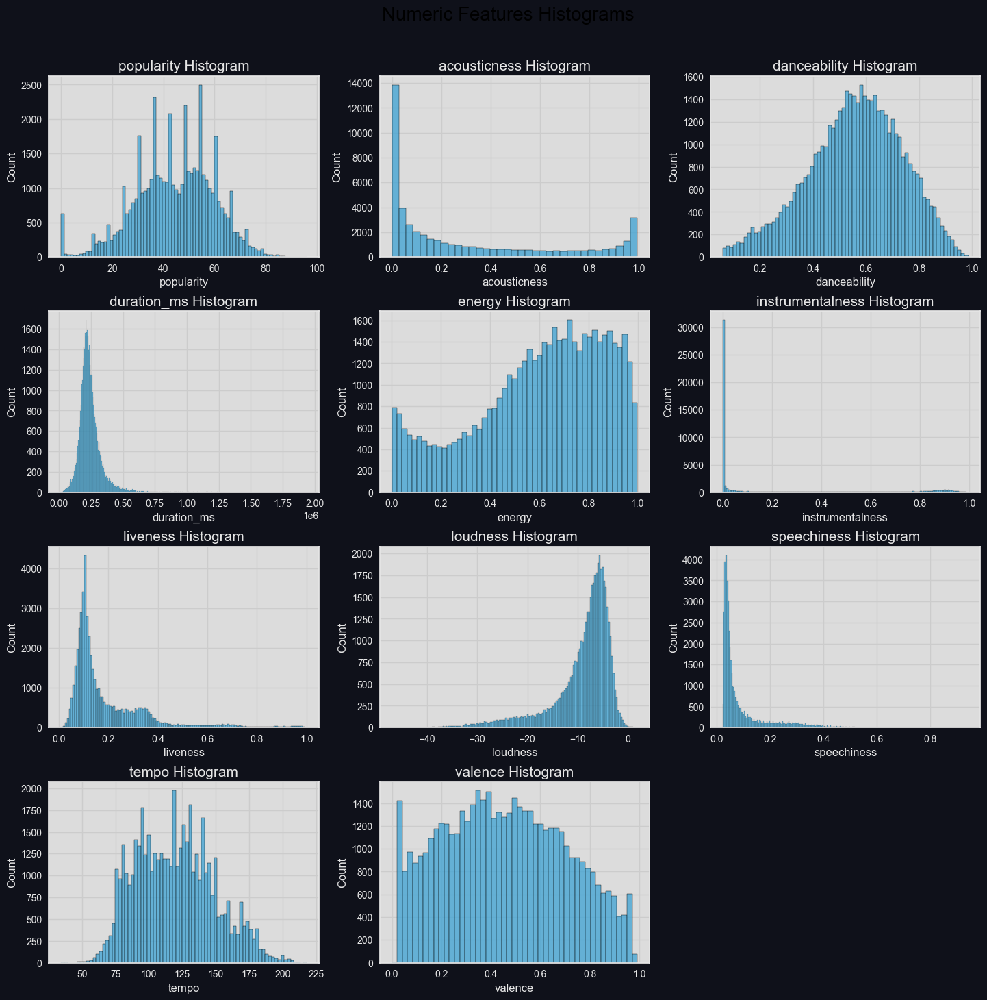

In [130]:
NumHists, axes = plt.subplots(4, 3, figsize=(15, 15))
NumHists.suptitle('Numeric Features Histograms', fontsize=20)
NumHists.tight_layout(pad=3.0)
for i, feature in enumerate(dfNum.columns):
    ax = axes[i//3, i%3]
    sns.histplot(dfNum[feature], ax=ax, color=snsPalette[0])
    ax.set_title(f'{feature} Histogram', fontsize=15)
    ax.set_xlabel(f'{feature}', fontsize=12)
    ax.set_ylabel('Count', fontsize=12)
    ax.set_facecolor(axBGColor)
NumHists.delaxes(axes[3,2])

#### **acousticness Feature**

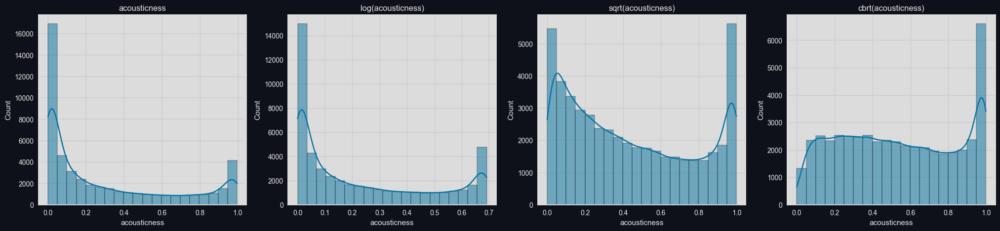

In [131]:
acousticness_base = df['acousticness']
acousticness_log = np.log(df["acousticness"]+1)
acousticness_sqrt = np.sqrt(df["acousticness"])
acousticness_cbrt = np.cbrt(df["acousticness"])
title = ['acousticness', 'log(acousticness)', 'sqrt(acousticness)', 'cbrt(acousticness)']
acousticnesstf , axes = plt.subplots(1, 4, figsize=(25, 5))
for idx, col in enumerate([acousticness_base, acousticness_log, acousticness_sqrt, acousticness_cbrt]):
    sns.histplot(col, ax=axes[idx], kde=True,bins=20)
    axes[idx].set_title(title[idx])

#### **duration_ms Feature**

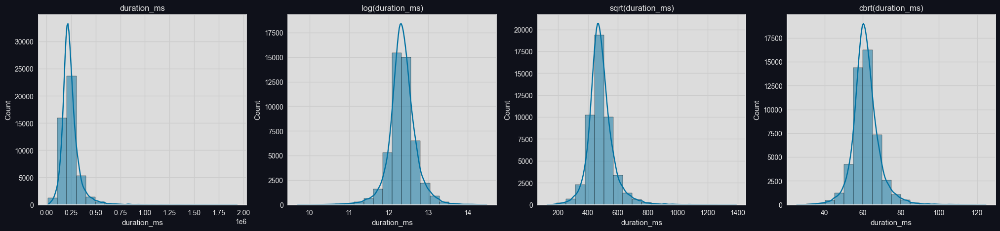

In [132]:
duration_ms_base = df['duration_ms']
duration_ms_log = np.log(df["duration_ms"])
duration_ms_sqrt = np.sqrt(df["duration_ms"])
duration_ms_cbrt = np.cbrt(df["duration_ms"])
title = ['duration_ms', 'log(duration_ms)', 'sqrt(duration_ms)', 'cbrt(duration_ms)']
duration_mstf , axes = plt.subplots(1, 4, figsize=(25, 5))
for idx, col in enumerate([duration_ms_base, duration_ms_log, duration_ms_sqrt, duration_ms_cbrt]):
    sns.histplot(col, ax=axes[idx], kde=True,bins=20)
    axes[idx].set_title(title[idx])

In [133]:
dfDuration = df.copy()
dfDuration['duration_ms'] = duration_ms_log

modelBM_Duration_log, resultBM_Duration_log, confmatrixBM_Duration_log, f1BM_Duration_log = modelTestProcess(dfDuration, getdummy=1)

Logistic Regression Model (F1 score) : 0.533729915477468
Decision Tree Model (F1 score) : 0.4436566732328976
Random Forest Model (F1 score) : 0.5512512049916017
KNN Model (F1 score) : 0.4737041015601774
MLPC Model (F1 score) : 0.5827114233497143


In [134]:
dfDuration = df.copy()
dfDuration['duration_ms'] = duration_ms_cbrt

modelBM_Duration_cbrt, resultBM_Duration_cbrt, confmatrixBM_Duration_cbrt, f1BM_Duration_cbrt = modelTestProcess(dfDuration, getdummy=1)

Logistic Regression Model (F1 score) : 0.5340660741918921
Decision Tree Model (F1 score) : 0.4435410451989476
Random Forest Model (F1 score) : 0.5511484530893378
KNN Model (F1 score) : 0.47334517401172793
MLPC Model (F1 score) : 0.5816618263303287


#### **instrumentalness Feature**

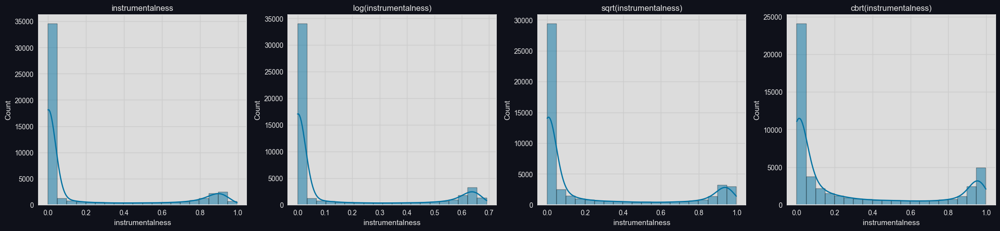

In [135]:
instrumentalness_base = df['instrumentalness']
instrumentalness_log = np.log(df["instrumentalness"]+1)
instrumentalness_sqrt = np.sqrt(df["instrumentalness"])
instrumentalness_cbrt = np.cbrt(df["instrumentalness"])
title = ['instrumentalness', 'log(instrumentalness)', 'sqrt(instrumentalness)', 'cbrt(instrumentalness)']
instrumentalnesstf , axes = plt.subplots(1, 4, figsize=(25, 5))
for idx, col in enumerate([instrumentalness_base, instrumentalness_log, instrumentalness_sqrt, instrumentalness_cbrt]):
    sns.histplot(col, ax=axes[idx], kde=True,bins=20)
    axes[idx].set_title(title[idx])

#### **liveness Feature**

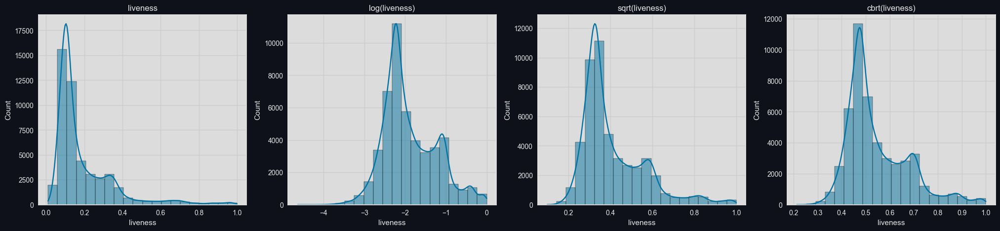

In [136]:
liveness_base = df['liveness']
liveness_log = np.log(df["liveness"])
liveness_sqrt = np.sqrt(df["liveness"])
liveness_cbrt = np.cbrt(df["liveness"])
title = ['liveness', 'log(liveness)', 'sqrt(liveness)', 'cbrt(liveness)']
livenesstf , axes = plt.subplots(1, 4, figsize=(25, 5))
for idx, col in enumerate([liveness_base, liveness_log, liveness_sqrt, liveness_cbrt]):
    sns.histplot(col, ax=axes[idx], kde=True,bins=20)
    axes[idx].set_title(title[idx])

In [137]:
dfLiveness = df.copy()
dfLiveness['liveness'] = liveness_log

modelBM_Liveness_log, resultBM_Liveness_log, confmatrixBM_Liveness_log, f1BM_Liveness_log = modelTestProcess(dfLiveness, getdummy=1)

Logistic Regression Model (F1 score) : 0.5352213530678591
Decision Tree Model (F1 score) : 0.44385863942657255
Random Forest Model (F1 score) : 0.5512122179361562
KNN Model (F1 score) : 0.4680461766899694
MLPC Model (F1 score) : 0.5798518690845943


In [138]:
dfLiveness = df.copy()
dfLiveness['liveness'] = liveness_cbrt

modelBM_Liveness_cbrt, resultBM_Liveness_cbrt, confmatrixBM_Liveness_cbrt, f1BM_Liveness_cbrt = modelTestProcess(dfLiveness, getdummy=1)

Logistic Regression Model (F1 score) : 0.5360678083215004
Decision Tree Model (F1 score) : 0.44367396452787294
Random Forest Model (F1 score) : 0.5512484972024289
KNN Model (F1 score) : 0.4699381115358704
MLPC Model (F1 score) : 0.5842755856272527


#### **loudness Feature**

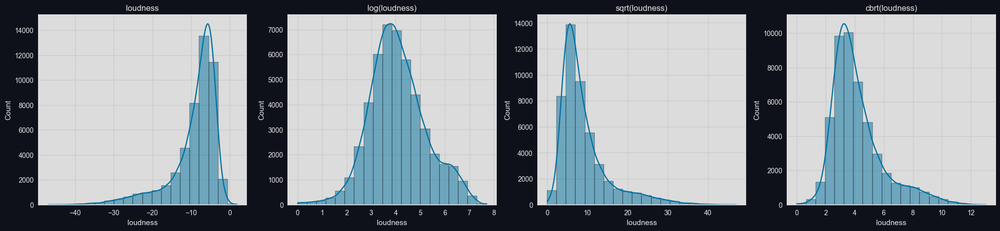

In [139]:
# Left skewed data can be transformed by taking the square first
loudness_base = df['loudness']
X = np.square(df["loudness"])
loudness_log = np.log(X+1)
loudness_sqrt = np.sqrt(X)
loudness_cbrt = np.cbrt(X)
title = ['loudness', 'log(loudness)', 'sqrt(loudness)', 'cbrt(loudness)']
loudnesstf , axes = plt.subplots(1, 4, figsize=(25, 5))
for idx, col in enumerate([loudness_base, loudness_log, loudness_sqrt, loudness_cbrt]):
    sns.histplot(col, ax=axes[idx], kde=True,bins=20)
    axes[idx].set_title(title[idx])

In [140]:
dfLoudness = df.copy()
dfLoudness['loudness'] = loudness_log

modelBM_Loudness_log, resultBM_Loudness_log, confmatrixBM_Loudness_log, f1BM_Loudness_log = modelTestProcess(dfLoudness, getdummy=1)

Logistic Regression Model (F1 score) : 0.5380658637343865
Decision Tree Model (F1 score) : 0.44199705038660936
Random Forest Model (F1 score) : 0.5432208696618277
KNN Model (F1 score) : 0.47757514300049714
MLPC Model (F1 score) : 0.5846061770571997


#### **speechiness Feature**

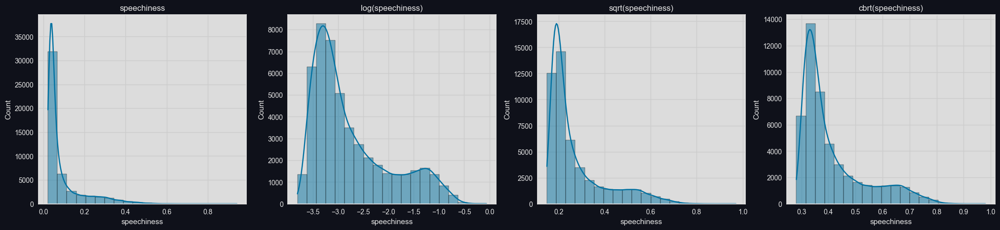

In [141]:
speechiness_base = df['speechiness']
speechiness_log = np.log(df["speechiness"])
speechiness_sqrt = np.sqrt(df["speechiness"])
speechiness_cbrt = np.cbrt(df["speechiness"])
title = ['speechiness', 'log(speechiness)', 'sqrt(speechiness)', 'cbrt(speechiness)']
speechinesstf , axes = plt.subplots(1, 4, figsize=(25, 5))
for idx, col in enumerate([speechiness_base, speechiness_log, speechiness_sqrt, speechiness_cbrt]):
    sns.histplot(col, ax=axes[idx], kde=True,bins=20)
    axes[idx].set_title(title[idx])

#### **Mix Feature**

In [142]:
dfMix = df.copy()
dfMix['duration_ms'] = duration_ms_log
dfMix['liveness'] = liveness_cbrt
dfMix['loudness'] = loudness_log

modelBM_Mix, resultBM_Mix, confmatrixBM_Mix, f1BM_Mix = modelTestProcess(dfMix, getdummy=1)

Logistic Regression Model (F1 score) : 0.5346875385993367
Decision Tree Model (F1 score) : 0.4423336541109584
Random Forest Model (F1 score) : 0.5431838161763447
KNN Model (F1 score) : 0.4737741259685333
MLPC Model (F1 score) : 0.5807543221261556


#### **Conclusion**

Not Good

### **Feature Scaling**

#### **Import Data**

In [143]:
df = pd.read_csv('Data/dfOutlier_res.csv')
dfNum = ['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo',
       'valence']
dfCate = ['key', 'mode']

In [144]:
df = pd.get_dummies(df, columns=['key','mode'],drop_first=True)
X = df.drop(['music_genre'], axis=1)
y = df['music_genre']

#### **StandardScaler**

In [145]:
Standardscaler = StandardScaler()
Xss = Standardscaler.fit_transform(X)
df_FE_SS = pd.DataFrame(Xss, columns=df.drop(['music_genre'], axis=1).columns)
df_FE_SS['music_genre'] = y
df_FE_SS

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,...,key_C#,key_D,key_D#,key_E,key_F,key_F#,key_G,key_G#,mode_Minor,music_genre
0,-1.131420,-0.880454,0.518825,0.226621,1.289310,1.888013,-0.481566,0.634848,-0.167852,-0.642721,...,-0.347066,-0.343513,-0.179567,-0.285741,-0.308871,-0.255542,-0.360714,-0.266626,1.335484,Electronic
1,-0.870287,-0.856916,0.349544,-0.269038,1.095733,2.374811,-0.424735,0.332545,-0.635823,-0.159905,...,-0.347066,2.911101,-0.179567,-0.285741,-0.308871,-0.255542,-0.360714,-0.266626,1.335484,Electronic
2,-1.066137,-0.885209,0.338258,-0.297081,0.583325,-0.515784,2.164250,0.730692,-0.588817,0.284560,...,-0.347066,-0.343513,-0.179567,-0.285741,-0.308871,-0.255542,-0.360714,3.750572,-0.748792,Electronic
3,-0.674436,-0.819642,1.207238,-0.807061,0.374566,-0.544345,-0.216353,0.750222,1.547347,0.285244,...,2.881298,-0.343513,-0.179567,-0.285741,-0.308871,-0.255542,-0.360714,-0.266626,-0.748792,Electronic
4,-0.805003,-0.880542,0.439827,-0.226388,-0.054339,2.248490,-0.216353,0.460063,-0.517786,0.867579,...,-0.347066,-0.343513,-0.179567,-0.285741,-0.308871,3.913245,-0.360714,-0.266626,-0.748792,Electronic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48495,0.957648,-0.796163,1.991576,-0.354324,-0.103682,-0.552140,-0.456308,0.335991,2.163648,-0.740598,...,2.881298,-0.343513,-0.179567,-0.285741,-0.308871,-0.255542,-0.360714,-0.266626,-0.748792,Hip-Hop
48496,1.806332,-0.433405,0.840461,0.082197,-0.908354,-0.552140,-0.519454,-0.122223,-0.374678,0.080972,...,-0.347066,-0.343513,-0.179567,-0.285741,-0.308871,-0.255542,-0.360714,-0.266626,-0.748792,Hip-Hop
48497,0.435381,-0.876668,0.750177,-0.570497,0.613690,-0.552140,-0.304757,0.595132,0.575888,0.390100,...,-0.347066,2.911101,-0.179567,-0.285741,-0.308871,-0.255542,-0.360714,-0.266626,-0.748792,Hip-Hop
48498,1.349348,-0.650296,1.252379,0.196388,-0.490836,-0.552140,-0.538397,0.665209,-0.488538,-1.498091,...,-0.347066,-0.343513,-0.179567,-0.285741,-0.308871,-0.255542,2.772279,-0.266626,1.335484,Hip-Hop


In [146]:
modelBM_FE_SS, resultBM_FE_SS, confmatrixBM_FE_SS, f1BM_FE_SS = modelTestProcess(df_FE_SS, getdummy=0)

Logistic Regression Model (F1 score) : 0.5357630309884516
Decision Tree Model (F1 score) : 0.4436429258486196
Random Forest Model (F1 score) : 0.5509402128633895
KNN Model (F1 score) : 0.4710736714570208
MLPC Model (F1 score) : 0.582190201113514


#### **MinMaxScaler**

In [147]:
MinMaxscaler = MinMaxScaler()
Xmm = MinMaxscaler.fit_transform(X)
df_FE_MM = pd.DataFrame(Xmm, columns=df.drop(['music_genre'], axis=1).columns)
df_FE_MM['music_genre'] = y
df_FE_MM

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,...,key_C#,key_D,key_D#,key_E,key_F,key_F#,key_G,key_G#,mode_Minor,music_genre
0,0.281250,0.004699,0.639309,0.129904,0.941896,0.795181,0.106358,0.854067,0.057084,0.362469,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,Electronic
1,0.322917,0.012751,0.606911,0.105225,0.890804,0.953815,0.115446,0.816471,0.008372,0.439345,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,Electronic
2,0.291667,0.003072,0.604752,0.103829,0.755562,0.011847,0.529450,0.865986,0.013265,0.510115,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,Electronic
3,0.354167,0.025502,0.771058,0.078438,0.700463,0.002540,0.148769,0.868415,0.235620,0.510224,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Electronic
4,0.333333,0.004669,0.624190,0.107349,0.587260,0.912651,0.148769,0.832330,0.020659,0.602947,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,Electronic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48495,0.614583,0.033534,0.921166,0.100979,0.574237,0.000000,0.110398,0.816900,0.299772,0.346884,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Hip-Hop
48496,0.750000,0.157631,0.700864,0.122713,0.361856,0.000000,0.100300,0.759914,0.035555,0.477699,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Hip-Hop
48497,0.531250,0.005994,0.683585,0.090216,0.763576,0.000000,0.134632,0.849127,0.134500,0.526920,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Hip-Hop
48498,0.677083,0.083434,0.779698,0.128398,0.472054,0.000000,0.097271,0.857843,0.023703,0.226272,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,Hip-Hop


In [148]:
modelBM_FE_MM, resultBM_FE_MM, confmatrixBM_FE_MM, f1BM_FE_MM = modelTestProcess(df_FE_MM, getdummy=0)

Logistic Regression Model (F1 score) : 0.5357630309884516
Decision Tree Model (F1 score) : 0.4436429258486196
Random Forest Model (F1 score) : 0.5509402128633895
KNN Model (F1 score) : 0.4709673156959691
MLPC Model (F1 score) : 0.582190201113514


#### **RobustScaler**

In [149]:
Robustscaler = RobustScaler()
Xrb = Robustscaler.fit_transform(X)
df_FE_RB = pd.DataFrame(Xrb, columns=df.drop(['music_genre'], axis=1).columns)
df_FE_RB['music_genre'] = y
df_FE_RB

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,...,key_C#,key_D,key_D#,key_E,key_F,key_F#,key_G,key_G#,mode_Minor,music_genre
0,-0.818182,-0.260520,0.337449,0.466024,0.782551,5.738134,-0.077356,0.363288,0.442211,-0.425942,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,Electronic
1,-0.636364,-0.245304,0.213992,-0.119591,0.647720,6.883062,-0.014065,0.034535,-0.308208,-0.105202,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,Electronic
2,-0.772727,-0.263593,0.205761,-0.152723,0.290813,0.084511,2.869198,0.467517,-0.232831,0.190063,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,Electronic
3,-0.500000,-0.221210,0.839506,-0.755258,0.145406,0.017337,0.218003,0.488756,3.192630,0.190517,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Electronic
4,-0.590909,-0.260577,0.279835,-0.069200,-0.153338,6.585960,0.218003,0.173211,-0.118928,0.577370,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,Electronic
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
48495,0.636364,-0.206033,1.411523,-0.220355,-0.187707,-0.000996,-0.049226,0.038283,4.180905,-0.490963,...,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Hip-Hop
48496,1.227273,0.028458,0.572016,0.295389,-0.748182,-0.000996,-0.119550,-0.460021,0.110553,0.054817,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Hip-Hop
48497,0.272727,-0.258072,0.506173,-0.475761,0.311963,-0.000996,0.119550,0.320096,1.634841,0.260174,...,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,Hip-Hop
48498,0.909091,-0.111744,0.872428,0.430304,-0.457369,-0.000996,-0.140647,0.396306,-0.072027,-0.994176,...,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,Hip-Hop


In [150]:
modelBM_FE_RB, resultBM_FE_RB, confmatrixBM_FE_RB, f1BM_FE_RB = modelTestProcess(df_FE_RB, getdummy=0)

Logistic Regression Model (F1 score) : 0.5357630309884516
Decision Tree Model (F1 score) : 0.4436429258486196
Random Forest Model (F1 score) : 0.5509402128633895
KNN Model (F1 score) : 0.4710736714570208
MLPC Model (F1 score) : 0.582190201113514


#### **Conclusion**

Look the same so we pick StandardScaler

In [151]:
df_FE_SS.to_csv('Data/df_FE_SS.csv', index=False)

### **Feature Extraction**

In [152]:
def checkCorrFF(df, figw, figh):
    corr, ax = plt.subplots(1, 1, figsize=(figw, figh))
    cor = df.corr()
    sns.heatmap(cor, annot=True, cmap='inferno', ax=ax)
    return corr

#### **Import Data**

In [153]:
df = pd.read_csv('Data/df_FE_SS.csv')
dfNum = ['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo',
       'valence']
dfCate = ['key', 'mode']
X = df.drop(['music_genre'], axis=1)
y = df['music_genre']
y_vis = y.replace({'Electronic':0, 'Anime':1, 'Jazz':2, 'Alternative':3, 'Country':4, 'Rap':5, 'Blues':6, 'Rock':7, 'Classical':8, 'Hip-Hop':9})
dfvis = pd.DataFrame(X, columns=df.drop(['music_genre'], axis=1).columns)
dfvis['music_genre'] = y_vis

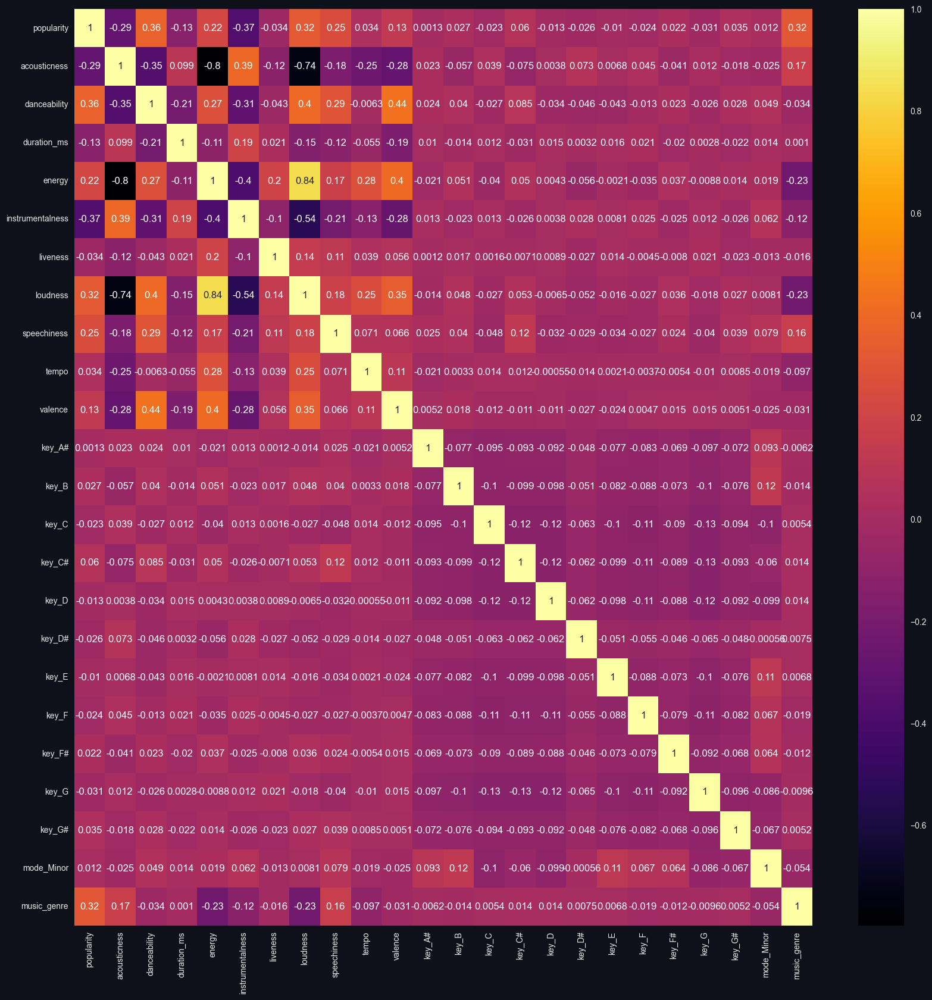

In [154]:
scaledFECorr = checkCorrFF(dfvis, 20, 20)

#### **ANOVA**

We will be using ANOVA to select the best features from the dataset because our dataset is both categorical and numerical.

In [155]:
def anovaSelector(df,k:list=['Default'],verbose:int=0):
    verboseprint = print if verbose==1 else lambda *a, **k: None
    dfa = df.copy()
    if k == ['Default']:
        k = [int(len(dfa.columns)/2)]
    print(f'Start ANOVA feature selection with k={k}')
    # Split the data into X and y
    X = dfa.drop(['music_genre'], axis=1)
    y = dfa['music_genre']
    y_vis = y.replace({'Electronic':0, 'Anime':1, 'Jazz':2, 'Alternative':3, 'Country':4, 'Rap':5, 'Blues':6, 'Rock':7, 'Classical':8, 'Hip-Hop':9})
    # Create Buffer
    bestmodel = {
        "Logistic Regression Model" : None,
        "Decision Tree Model" : None,
        "Random Forest Model" : None,
        "KNN Model" : None,
        "MLPC Model" : None,
    }
    bestresult = {
        "Logistic Regression Model" : 0,
        "Decision Tree Model" : 0,
        "Random Forest Model" : 0,
        "KNN Model" : 0,
        "MLPC Model" : 0,   
    }
    bestK = {
        "Logistic Regression Model" : 0,
        "Decision Tree Model" : 0,
        "Random Forest Model" : 0,
        "KNN Model" : 0,
        "MLPC Model" : 0,
    }
    iteration = 0
    for idx in k:
        verboseprint(f'Number of features: {idx}')
        anova_filter = SelectKBest(f_classif, k=idx)
        anova_filter.fit_transform(X, y)
        anova_support = anova_filter.get_support(indices=True)
        dfanova_select = dfa.iloc[:,anova_support]
        dfanova_select['music_genre'] = y
        verboseprint(f'Features selected: {dfanova_select.columns}')
        verboseprint(f'Star training model...')
        model, result, confmatrix, f1 = modelTestProcess(dfanova_select, getdummy=0)
        for key in bestmodel:
            if f1[key] > bestresult[key]:
                bestmodel[key] = model[key]
                bestresult[key] = f1[key]
                bestK[key] = idx
        iteration += 1
        verboseprint(f'Iteration {iteration} Best K: {bestK}')
        verboseprint('-'*50)
    return bestmodel, bestresult, bestK

In [156]:
'''
Number of features: 9
Features selected: Index(['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'loudness', 'speechiness', 'valence',
       'music_genre'],
      dtype='object')
Star training model
Logistic Regression Model (F1 score) : 0.5260571212943834
Decision Tree Model (F1 score) : 0.44154561159716826
Random Forest Model (F1 score) : 0.5425811891527921
KNN Model (F1 score) : 0.504160146149043
MLPC Model (F1 score) : 0.587763613712681
Iteration 1 Best K: {'Logistic Regression Model': 9, 'Decision Tree Model': 9, 'Random Forest Model': 9, 'KNN Model': 9, 'MLPC Model': 9}
--------------------------------------------------
Number of features: 10
Features selected: Index(['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'loudness', 'speechiness', 'tempo', 'valence',
       'music_genre'],
      dtype='object')
Star training model
Logistic Regression Model (F1 score) : 0.5277950778264864
Decision Tree Model (F1 score) : 0.438809854408412
Random Forest Model (F1 score) : 0.5506617999318845
KNN Model (F1 score) : 0.5046126888471603
MLPC Model (F1 score) : 0.5915947995749494
Iteration 2 Best K: {'Logistic Regression Model': 10, 'Decision Tree Model': 9, 'Random Forest Model': 10, 'KNN Model': 10, 'MLPC Model': 10}
--------------------------------------------------
Number of features: 11
Features selected: Index(['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'loudness', 'speechiness', 'tempo', 'valence',
       'mode_Minor', 'music_genre'],
      dtype='object')
Star training model
Logistic Regression Model (F1 score) : 0.532093182483687
Decision Tree Model (F1 score) : 0.4446852810651243
Random Forest Model (F1 score) : 0.5550049476008895
KNN Model (F1 score) : 0.5062018016528687
MLPC Model (F1 score) : 0.5942121258113638
Iteration 3 Best K: {'Logistic Regression Model': 11, 'Decision Tree Model': 11, 'Random Forest Model': 11, 'KNN Model': 11, 'MLPC Model': 11}
--------------------------------------------------
Number of features: 12
Features selected: Index(['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'loudness', 'speechiness', 'tempo', 'valence',
       'key_C#', 'mode_Minor', 'music_genre'],
      dtype='object')
Star training model
Logistic Regression Model (F1 score) : 0.5310457268457894
Decision Tree Model (F1 score) : 0.4425950704036651
Random Forest Model (F1 score) : 0.5549577861259054
KNN Model (F1 score) : 0.5011539964456009
MLPC Model (F1 score) : 0.5902917593600937
Iteration 4 Best K: {'Logistic Regression Model': 11, 'Decision Tree Model': 11, 'Random Forest Model': 11, 'KNN Model': 11, 'MLPC Model': 11}
--------------------------------------------------
Number of features: 13
Features selected: Index(['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo',
       'valence', 'key_C#', 'mode_Minor', 'music_genre'],
      dtype='object')
Star training model
Logistic Regression Model (F1 score) : 0.5305672893274366
Decision Tree Model (F1 score) : 0.43822852867113576
Random Forest Model (F1 score) : 0.555449972467583
KNN Model (F1 score) : 0.5014106517249948
MLPC Model (F1 score) : 0.5936132129473269
Iteration 5 Best K: {'Logistic Regression Model': 11, 'Decision Tree Model': 11, 'Random Forest Model': 13, 'KNN Model': 11, 'MLPC Model': 11}
--------------------------------------------------
Number of features: 14
Features selected: Index(['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo',
       'valence', 'key_A#', 'key_C#', 'mode_Minor', 'music_genre'],
      dtype='object')
Star training model
Logistic Regression Model (F1 score) : 0.5324330539715113
Decision Tree Model (F1 score) : 0.44193007791288813
Random Forest Model (F1 score) : 0.5530720742345434
KNN Model (F1 score) : 0.4974259349081127
MLPC Model (F1 score) : 0.5928478752509595
Iteration 4 Best K: {'Logistic Regression Model': 14, 'Decision Tree Model': 11, 'Random Forest Model': 13, 'KNN Model': 11, 'MLPC Model': 11}
--------------------------------------------------
Number of features: 15
Features selected: Index(['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'liveness', 'loudness', 'speechiness', 'tempo',
       'valence', 'key_A#', 'key_C#', 'key_D', 'mode_Minor', 'music_genre'],
      dtype='object')
Star training model
Logistic Regression Model (F1 score) : 0.5334196031320028
Decision Tree Model (F1 score) : 0.44116432627121743
Random Forest Model (F1 score) : 0.5524100941488908
KNN Model (F1 score) : 0.49499465997695213
MLPC Model (F1 score) : 0.5940271780921657
Iteration 5 Best K: {'Logistic Regression Model': 15, 'Decision Tree Model': 11, 'Random Forest Model': 13, 'KNN Model': 11, 'MLPC Model': 11}
--------------------------------------------------
'''
# anovamodel, anovaresult, anovaK = anovaSelector(df,k = [9,10,11,12,13],verbose=1)
pass

เนื่องจากคะแนนที่ได้จากการทำ Benchmark ด้วย ANOVA ที่เลือก Feature ที่มีค่าค่อนข้างสูงที่ K = 11 โดยหากมากกว่านั้นจะมีบาง Model ที่มีคะแนนเพิ่มมากขึ้น แต่เพิ่มขึ้นค่อนข้างน้อยมากดังนั้นแล้วเราจะเลือก K = 11 เพื่อให้ Model ที่ได้มีความแม่นและลด Overfitting ของ Model ลง (เนื่องจากจำนวน Feature ที่เหลือน้อยลง)

In [157]:
selector = SelectKBest(f_classif, k=11)
Xselect = selector.fit(X, y)
col = Xselect.get_support(indices=True)
dfSelect = df.iloc[:,col]
dfSelect['music_genre'] = y
dfSelect

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,loudness,speechiness,tempo,valence,mode_Minor,music_genre
0,-1.131420,-0.880454,0.518825,0.226621,1.289310,1.888013,0.634848,-0.167852,-0.642721,1.228594,1.335484,Electronic
1,-0.870287,-0.856916,0.349544,-0.269038,1.095733,2.374811,0.332545,-0.635823,-0.159905,0.301420,1.335484,Electronic
2,-1.066137,-0.885209,0.338258,-0.297081,0.583325,-0.515784,0.730692,-0.588817,0.284560,-0.503758,-0.748792,Electronic
3,-0.674436,-0.819642,1.207238,-0.807061,0.374566,-0.544345,0.750222,1.547347,0.285244,-0.759951,-0.748792,Electronic
4,-0.805003,-0.880542,0.439827,-0.226388,-0.054339,2.248490,0.460063,-0.517786,0.867579,-0.544423,-0.748792,Electronic
...,...,...,...,...,...,...,...,...,...,...,...,...
48495,0.957648,-0.796163,1.991576,-0.354324,-0.103682,-0.552140,0.335991,2.163648,-0.740598,-0.515958,-0.748792,Hip-Hop
48496,1.806332,-0.433405,0.840461,0.082197,-0.908354,-0.552140,-0.122223,-0.374678,0.080972,-1.398400,-0.748792,Hip-Hop
48497,0.435381,-0.876668,0.750177,-0.570497,0.613690,-0.552140,0.595132,0.575888,0.390100,-0.251632,-0.748792,Hip-Hop
48498,1.349348,-0.650296,1.252379,0.196388,-0.490836,-0.552140,0.665209,-0.488538,-1.498091,-0.418360,1.335484,Hip-Hop


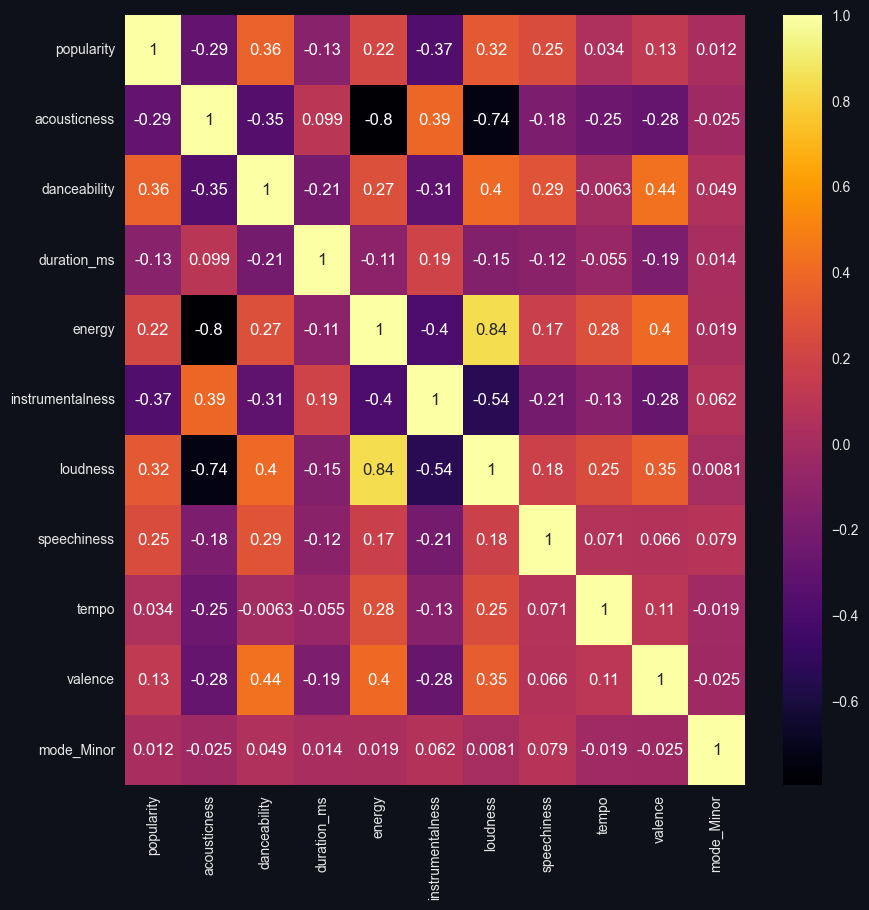

In [158]:
anova11 = checkCorrFF(dfSelect, 10, 10)

In [159]:
dfSelect.columns

Index(['popularity', 'acousticness', 'danceability', 'duration_ms', 'energy',
       'instrumentalness', 'loudness', 'speechiness', 'tempo', 'valence',
       'mode_Minor', 'music_genre'],
      dtype='object')

โดย Feature ที่ถูกตัดออกจาก Dataset จะมีข้อสังเกตดังนี้ดังนี้

In [160]:
df = pd.read_csv('Data/dfOutlier_res.csv')
Xcat = pd.get_dummies(df.drop(['music_genre'],axis=1),drop_first=True)
Xcat = Xcat[['key_A#', 'key_B', 'key_C', 'key_C#', 'key_D', 'key_D#',
       'key_E', 'key_F', 'key_F#', 'key_G', 'key_G#', 'mode_Minor',]]
Xcat

,key_A#,key_B,key_C,key_C#,key_D,key_D#,key_E,key_F,key_F#,key_G,key_G#,mode_Minor
0,1,0,0,0,0,0,0,0,0,0,0,1
1,0,0,0,0,1,0,0,0,0,0,0,1
2,0,0,0,0,0,0,0,0,0,0,1,0
3,0,0,0,1,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...
48495,0,0,0,1,0,0,0,0,0,0,0,0
48496,0,1,0,0,0,0,0,0,0,0,0,0
48497,0,0,0,0,1,0,0,0,0,0,0,0
48498,0,0,0,0,0,0,0,0,0,1,0,1


In [161]:
dfXCat = pd.concat([Xcat,df['music_genre']],axis=1)
dfCateDict = {"Electronic": dfXCat.groupby('music_genre').get_group('Hip-Hop'),
            "Anime": dfXCat.groupby('music_genre').get_group('Anime'),
            "Jazz": dfXCat.groupby('music_genre').get_group('Jazz'),
            "Alternative": dfXCat.groupby('music_genre').get_group('Alternative'),
            "Country": dfXCat.groupby('music_genre').get_group('Country'),
            "Rap": dfXCat.groupby('music_genre').get_group('Rap'),
            "Blues": dfXCat.groupby('music_genre').get_group('Blues'),
            "Rock": dfXCat.groupby('music_genre').get_group('Rock'),
            "Classical": dfXCat.groupby('music_genre').get_group('Classical'),
            "Hip-Hop": dfXCat.groupby('music_genre').get_group('Hip-Hop'),
}

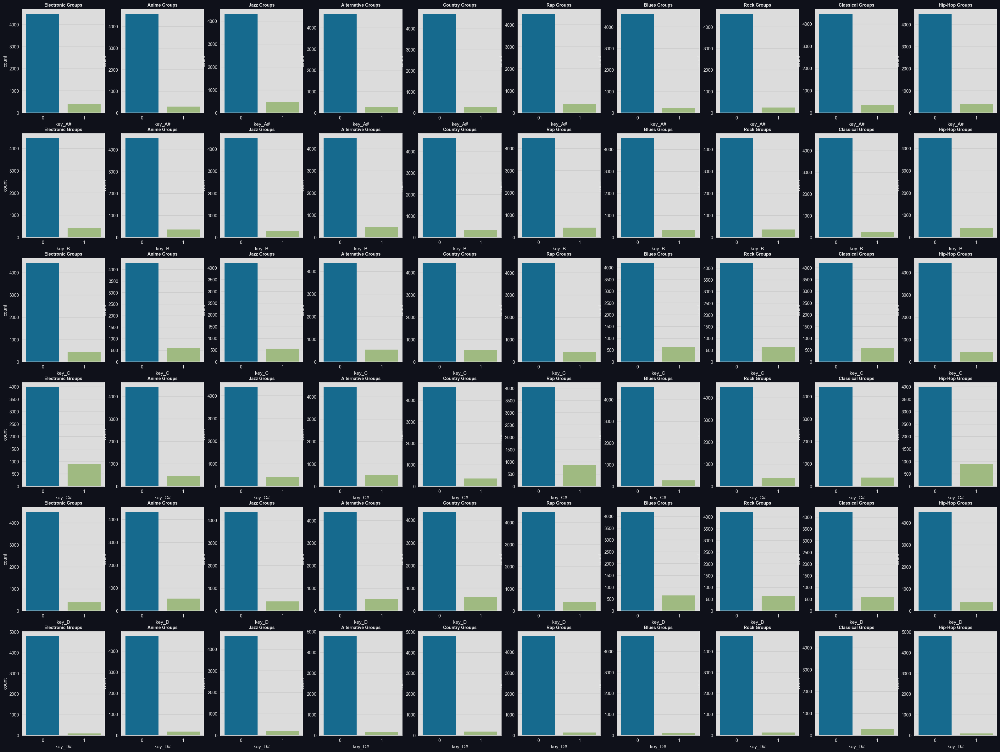

In [162]:
catcol = ['key_A#', 'key_B', 'key_C', 'key_C#', 'key_D', 'key_D#',]
catVisPlot , axes = plt.subplots( len(catcol),10, figsize=(40, 30))
count = 0
for key, item in dfCateDict.items():
    for idx,col in enumerate(catcol):
        ax = axes[idx,count]
        sns.countplot(x=col, data=item, ax=ax)
        ax.set_title(f'{key} Groups', weight='bold', fontsize=10)
    count += 1

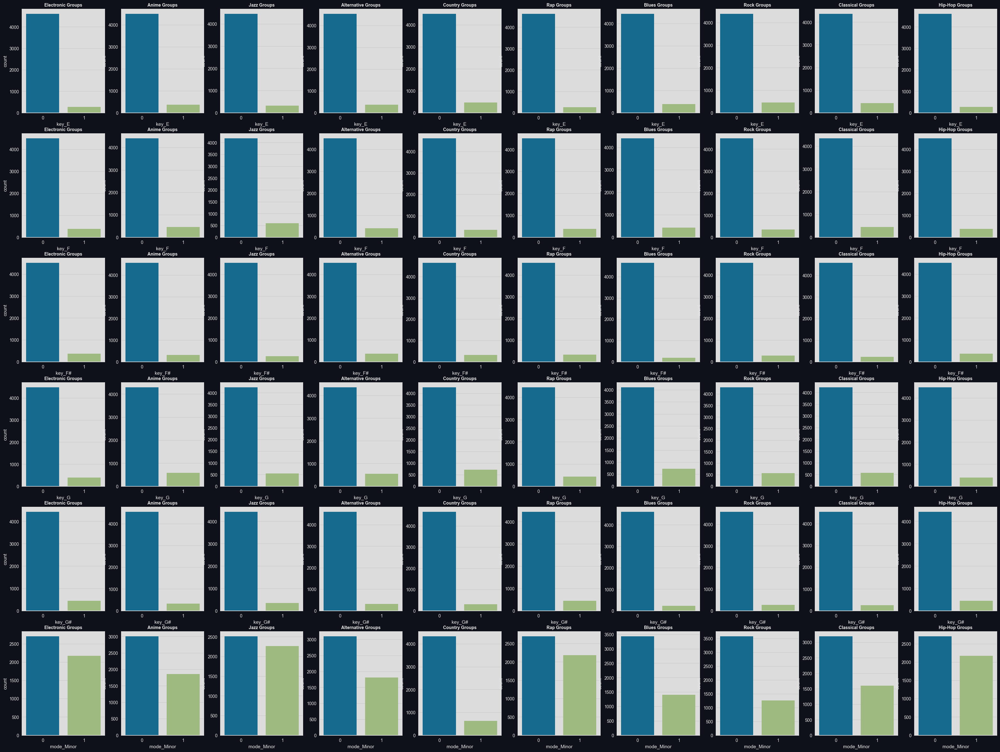

In [163]:
catcol = ['key_E', 'key_F', 'key_F#', 'key_G', 'key_G#', 'mode_Minor',]
catVisPlot , axes = plt.subplots( len(catcol),10, figsize=(40, 30))
count = 0
for key, item in dfCateDict.items():
    for idx,col in enumerate(catcol):
        ax = axes[idx,count]
        sns.countplot(x=col, data=item, ax=ax)
        ax.set_title(f'{key} Groups', weight='bold', fontsize=10)
    count += 1

In [164]:
selectorChi2 = SelectKBest(chi2, k=3)
XcatSelected = selectorChi2.fit_transform(Xcat, df['music_genre'])
colcat = selectorChi2.get_support(indices=True)
Xcat = Xcat.iloc[:,colcat]
catcol = Xcat.columns
Xcat['music_genre'] = df['music_genre']
Xcat

,key_A#,key_C#,mode_Minor,music_genre
0,1,0,1,Electronic
1,0,0,1,Electronic
2,0,0,0,Electronic
3,0,1,0,Electronic
4,0,0,0,Electronic
...,...,...,...,...
48495,0,1,0,Hip-Hop
48496,0,0,0,Hip-Hop
48497,0,0,0,Hip-Hop
48498,0,0,1,Hip-Hop


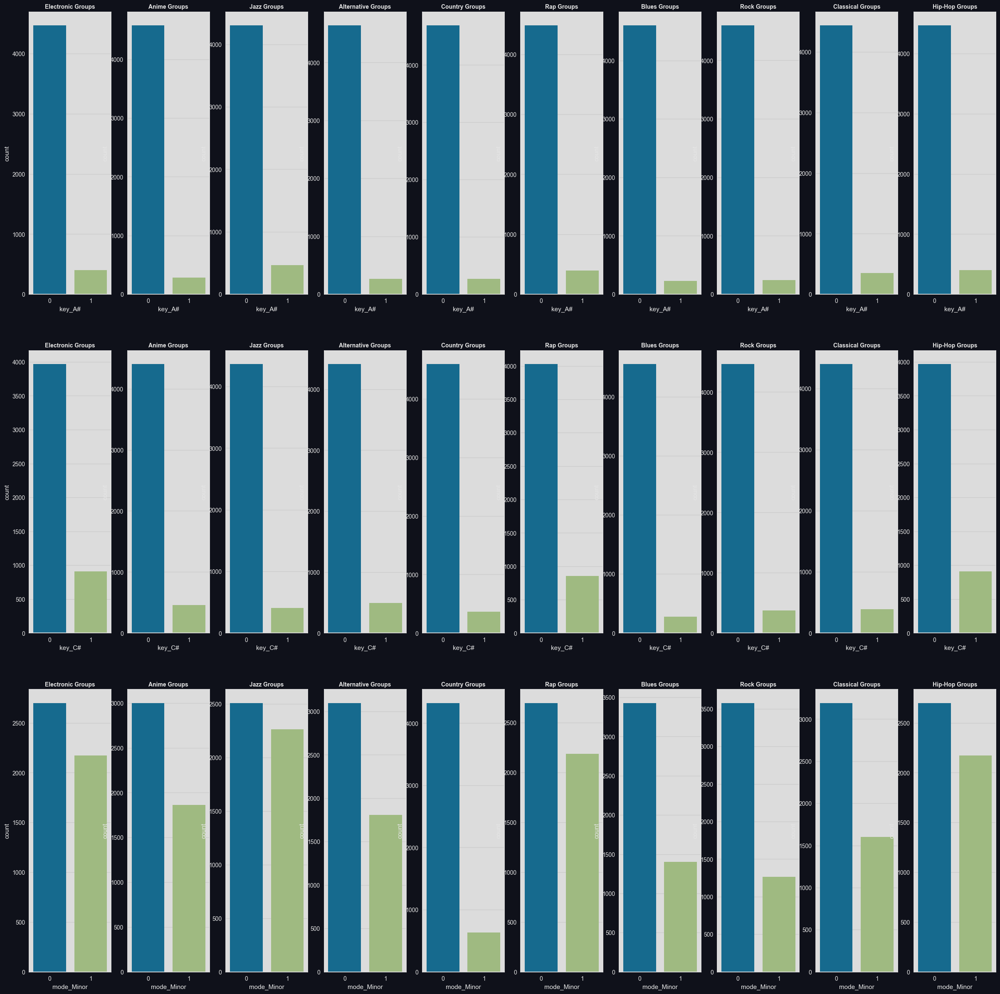

In [165]:
dfCateDict = {"Electronic": Xcat.groupby('music_genre').get_group('Hip-Hop'),
            "Anime": Xcat.groupby('music_genre').get_group('Anime'),
            "Jazz": Xcat.groupby('music_genre').get_group('Jazz'),
            "Alternative": Xcat.groupby('music_genre').get_group('Alternative'),
            "Country": Xcat.groupby('music_genre').get_group('Country'),
            "Rap": Xcat.groupby('music_genre').get_group('Rap'),
            "Blues": Xcat.groupby('music_genre').get_group('Blues'),
            "Rock": Xcat.groupby('music_genre').get_group('Rock'),
            "Classical": Xcat.groupby('music_genre').get_group('Classical'),
            "Hip-Hop": Xcat.groupby('music_genre').get_group('Hip-Hop'),
}
catVisPlot , axes = plt.subplots( len(catcol), 10, figsize=(30, 30))
count = 0
for key, item in dfCateDict.items():
    for idx,col in enumerate(catcol):
        ax = axes[idx,count]
        sns.countplot(x=col, data=item, ax=ax)
        ax.set_title(f'{key} Groups', weight='bold', fontsize=10)
    count += 1

##### **Performance**

In [166]:
dfSelect['music_genre'] = y

modelBM_Select, resultBM_Select, confmatrixBM_Select, f1BM_Select = modelTestProcess(dfSelect, getdummy=0)

Logistic Regression Model (F1 score) : 0.532093182483687
Decision Tree Model (F1 score) : 0.4446852810651243
Random Forest Model (F1 score) : 0.5550049476008895
KNN Model (F1 score) : 0.5062018016528687
MLPC Model (F1 score) : 0.5942121258113638


#### **Feature Drop Experiment**

In [167]:
dfSelectD = dfSelect.copy()
dfSelectD = dfSelectD.drop(['loudness','energy'], axis=1)
dfSelectD.columns

Index(['popularity', 'acousticness', 'danceability', 'duration_ms',
       'instrumentalness', 'speechiness', 'tempo', 'valence', 'mode_Minor',
       'music_genre'],
      dtype='object')

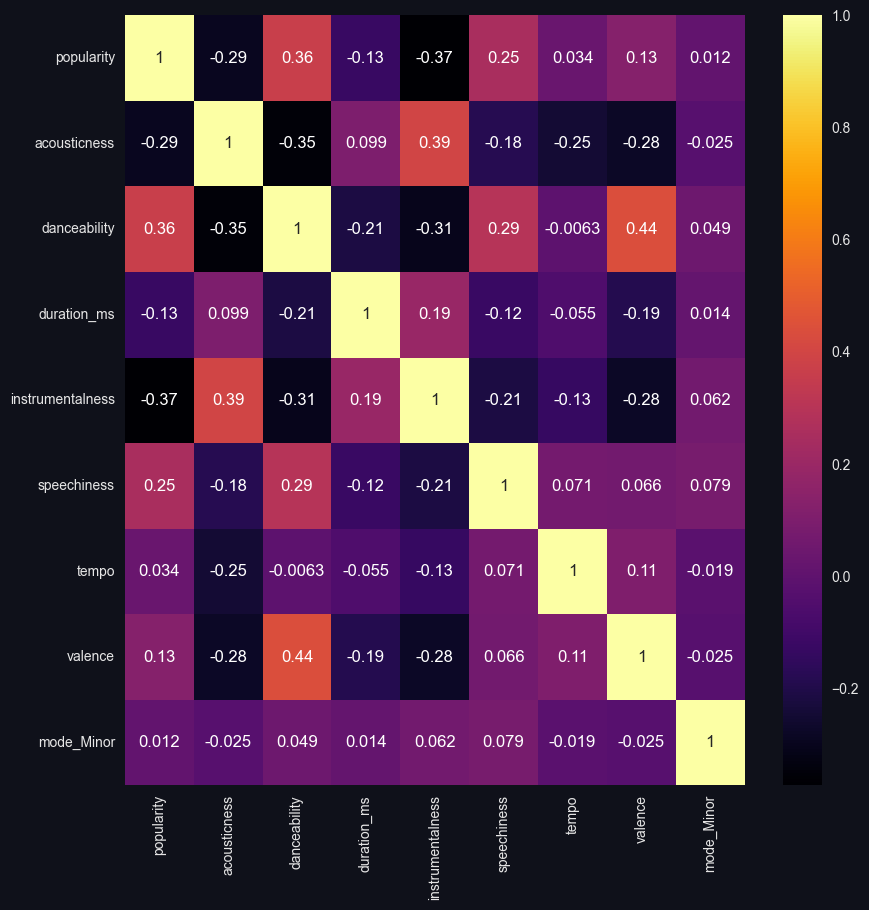

In [168]:
SelectD = checkCorrFF(dfSelectD, 10, 10)

##### **Performance**

In [169]:
modelBM_SelectD, resultBM_SelectD, confmatrixBM_SelectD, f1BM_SelectD = modelTestProcess(dfSelectD, getdummy=0)

Logistic Regression Model (F1 score) : 0.5103183111731755
Decision Tree Model (F1 score) : 0.43916640296903087
Random Forest Model (F1 score) : 0.5406180246544385
KNN Model (F1 score) : 0.49100938385003245
MLPC Model (F1 score) : 0.572626627955503


#### **Principal Component Analysis (PCA)**

In [170]:
def dfPCAGenerator(df, threshold,verbose:int=0):
    verboseprint = print if verbose==1 else lambda *a, **k: None
    dfPCA = df.copy()
    pca = PCA(n_components = len(dfPCA.columns))           
    pca.fit_transform(dfPCA)          

    # Print the explained variance ratio
    verboseprint('Number of components: ', pca.n_components_)
    verboseprint(f'Variace list: {pca.explained_variance_ratio_}')
    for i in range(len(pca.explained_variance_ratio_)):
        verboseprint('PC', i+1, ': ', np.around(pca.explained_variance_ratio_[i],4), ' (', np.around(sum(pca.explained_variance_ratio_[0:i+1]),4), ')')
    
    # Select the number of components where the variance is above the threshold
    varThreshold = threshold
    var = np.where(pca.explained_variance_ratio_.cumsum() >= varThreshold)[0][0] +1
    realVar = pca.explained_variance_ratio_.cumsum()[var-1]
    print(f'Number of components to explain {realVar*100}% of variance: {var}')
    
    # Plot the explained variance ratio
    if verbose == 1:
        fig, ax = plt.subplots(1, 1, figsize=(5, 5))
        for i in range(0, len(pca.explained_variance_ratio_)):
            ax.plot(i+1, pca.explained_variance_ratio_[i], 'ro')
    else :
        fig = None
    
    # Apply PCA to the dataset
    dfPCA = df.copy()
    pca = PCA(n_components = var)
    x_pca = pca.fit_transform(dfPCA)
    col = [
        str(f'PC{i+1}') for i in range(0, len(pca.explained_variance_ratio_))
        ]

    dfPCA = pd.DataFrame(x_pca, columns = col)
    return dfPCA, fig

In [171]:
def pcaSelector(df,threshold:list=['Default'],verbose:int=0):
    verboseprint = print if verbose==1 else lambda *a, **k: None
    dfp = df.copy()
    if threshold == ['Default']:
        threshold = [0.9]
    print(f'Start PCA feature selection with threshold={threshold}')
    # Split the data into X and y
    X = dfp.drop(['music_genre'], axis=1)
    y = dfp['music_genre']
    y_vis = y.replace({'Electronic':0, 'Anime':1, 'Jazz':2, 'Alternative':3, 'Country':4, 'Rap':5, 'Blues':6, 'Rock':7, 'Classical':8, 'Hip-Hop':9})
    # Create Buffer
    bestmodel = {
        "Logistic Regression Model" : None,
        "Decision Tree Model" : None,
        "Random Forest Model" : None,
        "KNN Model" : None,
        "MLPC Model" : None,
    }
    bestresult = {
        "Logistic Regression Model" : 0,
        "Decision Tree Model" : 0,
        "Random Forest Model" : 0,
        "KNN Model" : 0,
        "MLPC Model" : 0,   
    }
    bestthreshold = {
        "Logistic Regression Model" : 0,
        "Decision Tree Model" : 0,
        "Random Forest Model" : 0,
        "KNN Model" : 0,
        "MLPC Model" : 0,   
    }
    for idx in threshold:
        verboseprint(f'Threshold: {idx}')
        dfPCA, fig = dfPCAGenerator(X, idx, verbose)
        dfPCA['music_genre'] = y
        verboseprint(f'Star training model...')
        model, result, confmatrix, f1 = modelTestProcess(dfPCA, getdummy=0, verbose = verbose)
        for key in bestmodel:
            if f1[key] > bestresult[key]:
                bestmodel[key] = model[key]
                bestresult[key] = f1[key]
                bestthreshold[key] = idx
        print(f'Best Threshold: {bestthreshold}')
        print('-'*50)
    return bestmodel, bestresult, bestthreshold

In [184]:
dfPCA = dfSelect.copy()
dfDPCA = dfSelectD.copy()
Xpca, ypca = dfPCA.drop(['music_genre'], axis=1), dfPCA['music_genre']
Xdpca, ydpca = dfDPCA.drop(['music_genre'], axis=1), dfDPCA['music_genre']

<hr>

##### **PCA For ANOVA data**

In [185]:
pca = PCA(n_components = len(Xpca.columns))           
pca.fit_transform(Xpca)          

# Print the explained variance ratio
print('Number of components: ', pca.n_components_)
print(f'Variace list: {pca.explained_variance_ratio_}')
for i in range(len(pca.explained_variance_ratio_)):
    print('PC', i+1, ': ', np.around(pca.explained_variance_ratio_[i],4), ' (', np.around(sum(pca.explained_variance_ratio_[0:i+1]),4), ')')

Number of components:  11
Variace list: [0.34202272 0.12020121 0.09722095 0.08861556 0.08502454 0.07183711
 0.06547382 0.05471762 0.04225654 0.02274586 0.00988408]
PC 1 :  0.342  ( 0.342 )
PC 2 :  0.1202  ( 0.4622 )
PC 3 :  0.0972  ( 0.5594 )
PC 4 :  0.0886  ( 0.6481 )
PC 5 :  0.085  ( 0.7331 )
PC 6 :  0.0718  ( 0.8049 )
PC 7 :  0.0655  ( 0.8704 )
PC 8 :  0.0547  ( 0.9251 )
PC 9 :  0.0423  ( 0.9674 )
PC 10 :  0.0227  ( 0.9901 )
PC 11 :  0.0099  ( 1.0 )


In [174]:
"""
Start PCA feature selection with threshold=[0.8, 0.85, 0.9, 0.95]
Number of components to explain 80.49220840733858% of variance: 6
Logistic Regression Model (F1 score) : 0.4127771498037407
Decision Tree Model (F1 score) : 0.3592784218585783
Random Forest Model (F1 score) : 0.4603479745291564
KNN Model (F1 score) : 0.43789196539073055
MLPC Model (F1 score) : 0.5162572645841518
Best Threshold: {'Logistic Regression Model': 0.8, 'Decision Tree Model': 0.8, 'Random Forest Model': 0.8, 'KNN Model': 0.8, 'MLPC Model': 0.8}
--------------------------------------------------
Number of components to explain 87.03959061702754% of variance: 7
Logistic Regression Model (F1 score) : 0.46788931410341694
Decision Tree Model (F1 score) : 0.3733342166087479
Random Forest Model (F1 score) : 0.4877676756125047
KNN Model (F1 score) : 0.4642210045335403
MLPC Model (F1 score) : 0.5375235707609866
Best Threshold: {'Logistic Regression Model': 0.85, 'Decision Tree Model': 0.85, 'Random Forest Model': 0.85, 'KNN Model': 0.85, 'MLPC Model': 0.85}
--------------------------------------------------
Number of components to explain 92.5113522229171% of variance: 8
Logistic Regression Model (F1 score) : 0.4929173972990741
Decision Tree Model (F1 score) : 0.39188068545877963
Random Forest Model (F1 score) : 0.49700398298983284
KNN Model (F1 score) : 0.4798074053741314
MLPC Model (F1 score) : 0.5560387893103839
Best Threshold: {'Logistic Regression Model': 0.9, 'Decision Tree Model': 0.9, 'Random Forest Model': 0.9, 'KNN Model': 0.9, 'MLPC Model': 0.9}
--------------------------------------------------
Number of components to explain 96.73700647477908% of variance: 9
Logistic Regression Model (F1 score) : 0.5217498077763344
Decision Tree Model (F1 score) : 0.4113205866609827
Random Forest Model (F1 score) : 0.5219472104713351
KNN Model (F1 score) : 0.4926607240980474
MLPC Model (F1 score) : 0.5890020475391913
Best Threshold: {'Logistic Regression Model': 0.95, 'Decision Tree Model': 0.95, 'Random Forest Model': 0.95, 'KNN Model': 0.95, 'MLPC Model': 0.95}
--------------------------------------------------
"""

# bestmodelPCA, bestresultPCA, bestthresholdPCA = pcaSelector(dfSelectPCA,threshold=[0.80,0.85,0.90,0.95],verbose=0)

"\nStart PCA feature selection with threshold=[0.8, 0.85, 0.9, 0.95]\nNumber of components to explain 80.49220840733858% of variance: 6\nLogistic Regression Model (F1 score) : 0.4127771498037407\nDecision Tree Model (F1 score) : 0.3592784218585783\nRandom Forest Model (F1 score) : 0.4603479745291564\nKNN Model (F1 score) : 0.43789196539073055\nMLPC Model (F1 score) : 0.5162572645841518\nBest Threshold: {'Logistic Regression Model': 0.8, 'Decision Tree Model': 0.8, 'Random Forest Model': 0.8, 'KNN Model': 0.8, 'MLPC Model': 0.8}\n--------------------------------------------------\nNumber of components to explain 87.03959061702754% of variance: 7\nLogistic Regression Model (F1 score) : 0.46788931410341694\nDecision Tree Model (F1 score) : 0.3733342166087479\nRandom Forest Model (F1 score) : 0.4877676756125047\nKNN Model (F1 score) : 0.4642210045335403\nMLPC Model (F1 score) : 0.5375235707609866\nBest Threshold: {'Logistic Regression Model': 0.85, 'Decision Tree Model': 0.85, 'Random Fore

In [186]:
dfPCA, fig = dfPCAGenerator(Xpca, 0.95)
dfPCA['music_genre'] = ypca
pcaSummary_df = pd.DataFrame({'Standard deviation': np.sqrt(pca.explained_variance_),
                           'Proportion of variance': pca.explained_variance_ratio_,
                           'Cumulative proportion': np.cumsum(pca.explained_variance_ratio_),
                             'Variance Explanation Ratio': pca.explained_variance_ratio_,
                             'Cumulative Ratio' : np.cumsum(pca.explained_variance_ratio_) })

pcaSummary_df = pcaSummary_df.transpose()
pcaSummary_df.columns = ['PC{}'.format(i) for i in range(1, len(Xpca.columns) + 1)]
pcaSummary_df.round(4)

Number of components to explain 96.73700647477908% of variance: 9


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11
Standard deviation,1.9397,1.1499,1.0341,0.9873,0.9671,0.8889,0.8487,0.7758,0.6818,0.5002,0.3297
Proportion of variance,0.3420,0.1202,0.0972,0.0886,0.0850,0.0718,0.0655,0.0547,0.0423,0.0227,0.0099
Cumulative proportion,0.3420,0.4622,0.5594,0.6481,0.7331,0.8049,0.8704,0.9251,0.9674,0.9901,1.0000
Variance Explanation Ratio,0.3420,0.1202,0.0972,0.0886,0.0850,0.0718,0.0655,0.0547,0.0423,0.0227,0.0099
Cumulative Ratio,0.3420,0.4622,0.5594,0.6481,0.7331,0.8049,0.8704,0.9251,0.9674,0.9901,1.0000


In [187]:
modelPCA, resultPCA, confmatrixPCA, f1PCA = modelTestProcess(dfPCA, getdummy=0, verbose = 0)

Logistic Regression Model (F1 score) : 0.5217498077763344
Decision Tree Model (F1 score) : 0.4113205866609827
Random Forest Model (F1 score) : 0.5219472104713351
KNN Model (F1 score) : 0.4926607240980474
MLPC Model (F1 score) : 0.5890020475391913


<hr>

##### **PCA For Feature Drop Experiment**

In [188]:
pcad = PCA(n_components = len(Xdpca.columns))           
pcad.fit_transform(Xdpca)          

# Print the explained variance ratio
print('Number of components: ', pcad.n_components_)
print(f'Variace list: {pcad.explained_variance_ratio_}')
for i in range(len(pcad.explained_variance_ratio_)):
    print('PC', i+1, ': ', np.around(pcad.explained_variance_ratio_[i],4), ' (', np.around(sum(pcad.explained_variance_ratio_[0:i+1]),4), ')')

Number of components:  9
Variace list: [0.28597983 0.12376402 0.1159005  0.1072106  0.10024976 0.08558613
 0.06861243 0.06449721 0.04819951]
PC 1 :  0.286  ( 0.286 )
PC 2 :  0.1238  ( 0.4097 )
PC 3 :  0.1159  ( 0.5256 )
PC 4 :  0.1072  ( 0.6329 )
PC 5 :  0.1002  ( 0.7331 )
PC 6 :  0.0856  ( 0.8187 )
PC 7 :  0.0686  ( 0.8873 )
PC 8 :  0.0645  ( 0.9518 )
PC 9 :  0.0482  ( 1.0 )


In [190]:
dfDPCA, fig = dfPCAGenerator(Xdpca, 0.89)
dfDPCA['music_genre'] = ydpca
pcadSummary_df = pd.DataFrame({'Standard deviation': np.sqrt(pcad.explained_variance_),
                           'Proportion of variance': pcad.explained_variance_ratio_,
                           'Cumulative proportion': np.cumsum(pcad.explained_variance_ratio_),
                             'Variance Explanation Ratio': pcad.explained_variance_ratio_,
                             'Cumulative Ratio' : np.cumsum(pcad.explained_variance_ratio_) })

pcadSummary_df = pcadSummary_df.transpose()
pcadSummary_df.columns = ['PC{}'.format(i) for i in range(1, len(Xdpca.columns) + 1)]
pcadSummary_df.round(4)

Number of components to explain 95.18004859619967% of variance: 8


,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9
Standard deviation,1.6043,1.0554,1.0213,0.9823,0.9499,0.8777,0.7858,0.7619,0.6586
Proportion of variance,0.2860,0.1238,0.1159,0.1072,0.1002,0.0856,0.0686,0.0645,0.0482
Cumulative proportion,0.2860,0.4097,0.5256,0.6329,0.7331,0.8187,0.8873,0.9518,1.0000
Variance Explanation Ratio,0.2860,0.1238,0.1159,0.1072,0.1002,0.0856,0.0686,0.0645,0.0482
Cumulative Ratio,0.2860,0.4097,0.5256,0.6329,0.7331,0.8187,0.8873,0.9518,1.0000


In [179]:
modelPCAd , resultPCAd, confmatrixPCAd, f1PCAd = modelTestProcess(dfDPCA, getdummy=0, verbose = 0)

Logistic Regression Model (F1 score) : 0.49180651267772624
Decision Tree Model (F1 score) : 0.3908168979762821
Random Forest Model (F1 score) : 0.5005588557159681
KNN Model (F1 score) : 0.479483702247129
MLPC Model (F1 score) : 0.5571478231708515


#### **Conclusion**

In [191]:
# ANOVA (11 features)
dfSelect.to_csv('Data/dfSelect.csv', index=False)
dfPCA.to_csv('Data/dfSelectPCA.csv', index=False)
# Drop High Correlation (9 features)
dfSelectD.to_csv('Data/dfSelectD.csv', index=False)
dfDPCA.to_csv('Data/dfSelectDPCA.csv', index=False)

In [183]:
dfPCA

,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,music_genre
0,-0.628506,0.823607,0.852315,2.637882,0.577293,0.584754,1.075378,-0.964816,0.434763,Electronic
1,-0.054420,1.016235,0.922186,2.283971,-0.030099,-0.014480,0.820729,-1.762611,0.161317,Electronic
2,-0.794977,1.146060,-0.710451,-0.055706,-0.019131,-0.405150,0.718191,0.054781,-1.161136,Electronic
3,-1.461549,-0.436407,-0.073213,-0.753493,-0.768588,0.404053,1.579614,-0.055613,-1.300562,Electronic
4,0.359013,1.279058,-0.325518,0.386959,-0.522404,0.575286,0.716835,-2.187836,-0.710790,Electronic
...,...,...,...,...,...,...,...,...,...,...
48495,-1.670429,-2.162958,0.278923,-1.256488,0.340465,0.702637,1.130597,-0.517521,-0.874070,Hip-Hop
48496,-0.180226,-0.900341,-0.077595,-1.805070,0.525809,-0.674619,-1.037388,-0.972883,-0.947273,Hip-Hop
48497,-1.607831,-0.139999,-0.338326,-0.773738,-0.262494,-0.022300,0.426641,-0.397961,-0.473502,Hip-Hop
48498,-0.816964,-1.422404,1.093625,0.386351,1.562686,-1.228660,-0.631049,-0.338855,-0.708792,Hip-Hop


## **Modeling**

We will try modeling with clustering (using K-Means and Agglomerative Clustering) and compare the results with modeling without clustering.

In [3]:
def clusterVisualization(df, numCol, cateCol):
    # Violin Plot for numerical data
    plotViolin, axes = plt.subplots(6, 2, figsize=(40, 30))
    for idx, col in enumerate(numCol):
        if col != 'Cluster':
            if idx < 2:
                X = df[col].groupby(df['Cluster']).value_counts()
                sns.violinplot(data=df, x='Cluster', y=col, palette='copper_r', ax=axes[0, idx])
            elif idx < 4:
                X = df[col].groupby(df['Cluster']).value_counts()
                sns.violinplot(data=df, x='Cluster', y=col, palette='copper_r', ax=axes[1, idx-2])
            elif idx < 6:
                X = df[col].groupby(df['Cluster']).value_counts()
                sns.violinplot(data=df, x='Cluster', y=col, palette='copper_r', ax=axes[2, idx-4])
            elif idx < 8:
                X = df[col].groupby(df['Cluster']).value_counts()
                sns.violinplot(data=df, x='Cluster', y=col, palette='copper_r', ax=axes[3, idx-6])
            elif idx < 10:
                X = df[col].groupby(df['Cluster']).value_counts()
                sns.violinplot(data=df, x='Cluster', y=col, palette='copper_r', ax=axes[4, idx-8])
            elif idx == 10:
                X = df[col].groupby(df['Cluster']).value_counts()
                sns.violinplot(data=df, x='Cluster', y=col, palette='copper_r', ax=axes[5, 0])
                axes[5, 1].axis('off')
    
    # Bar plot for categorical variables
    plotBar, axes = plt.subplots(3, 1, figsize=(30, 15))
    for idx, col in enumerate(cateCol):
        if col != 'Cluster':
            X = df[col].groupby(df['Cluster']).value_counts()
            sns.barplot(x=X.index.get_level_values(0), y=X.values, hue=X.index.get_level_values(1), palette='copper_r', ax=axes[idx])
            plt.setp(axes[idx].get_legend().get_texts(), color='k', fontsize=12)
    
    return plotViolin, plotBar

In [4]:
dfDT = pd.read_csv('Data/dfSelect_Decision_Tree_Model.csv')
xDT, yDT = dfDT.drop('music_genre', axis=1), dfDT['music_genre']

dfKNN = pd.read_csv('Data/dfSelect_KNN_Model.csv')
xKNN, yKNN = dfKNN.drop('music_genre', axis=1), dfKNN['music_genre']

dfLR = pd.read_csv('Data/dfSelect_Logistic_Regression_Model.csv')
xLR, yLR = dfLR.drop('music_genre', axis=1), dfLR['music_genre']

dfRF = pd.read_csv('Data/dfSelect_Random_Forest_Model.csv')
xRF, yRF = dfRF.drop('music_genre', axis=1), dfRF['music_genre']

dfMLP = pd.read_csv('Data/dfSelect_MLPC_Model.csv')
xMLP, yMLP = dfMLP.drop('music_genre', axis=1), dfMLP['music_genre']

In [5]:
dfV = pd.read_csv('Data/dfOutlier_res.csv')
numCol = dfV.select_dtypes(include=np.number).columns.tolist()
cateCol = dfV.select_dtypes(exclude=np.number).columns.tolist()

### **K-Means**

In [6]:
def KMeansModelGenerator(dataFrame,k):
  df = dataFrame.copy()
  kmeans_clf = KMeans(n_clusters=k, random_state=1,)
  kmeans_clf = kmeans_clf.fit(df)
  labels = kmeans_clf.labels_
  df['Cluster'] = labels+1
  silhouetteScore = silhouette_score(df, labels, metric='euclidean', random_state=1)
  print('Silhouette score: ', silhouetteScore)
  print('WCSS: ', kmeans_clf.inertia_)
  print('Model Centroids: \n', kmeans_clf.cluster_centers_)
  for var in df['Cluster'].unique():
    print(f"Cluster ({var}) Size: {df[df['Cluster'] == var].shape[0]}")
  return kmeans_clf, df

In [7]:
def elbowVisualizer(dataFrame):
    df = dataFrame.copy()
    kmeansElbow, ax = plt.subplots(1, 1)
    visualizer = KElbowVisualizer(KMeans(random_state=1), k=(1, 11), metric='distortion', timings=False, ax=ax)
    visualizer.fit(df)
    elbow = visualizer.elbow_value_
    print('Elbow Value: ', visualizer.elbow_value_)
    print('Elbow Score: ', visualizer.elbow_score_)
    visualizer.show()
    return elbow, kmeansElbow

Elbow Value:  3
Elbow Score:  246575.84425095038


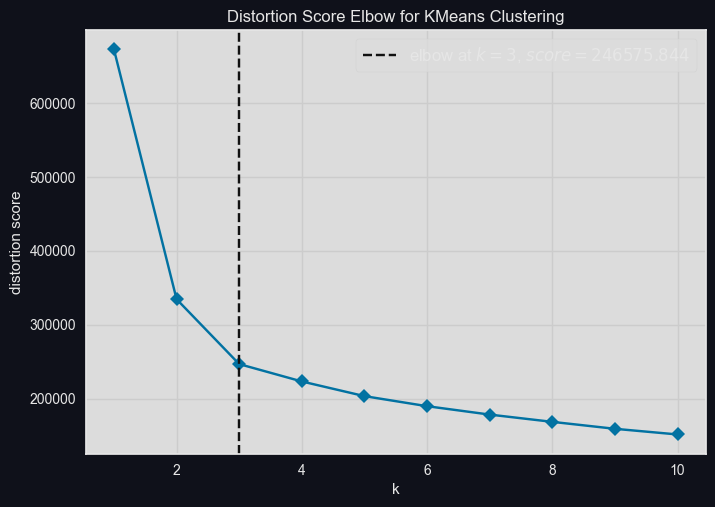

Silhouette score:  0.4271276456665667
WCSS:  246576.00996068658
Model Centroids: 
 [[-5.19208496e-01  8.38684890e-01 -4.68528526e-01  5.75814245e-01
  -6.68796766e-01  6.64509118e+00  8.37999680e-01  5.48850964e-02
  -1.87570485e-01 -3.26071009e-01]
 [ 3.51645332e-02  2.19490059e-01 -3.25953317e-02  1.12014781e-01
  -2.49420970e-03  2.07968680e-01 -8.97484399e-02  1.53422111e-01
   4.30693387e-02  1.02545051e-01]
 [ 4.18517543e-01  6.00141596e-02  4.87615866e-01 -9.14368657e-02
   9.25560417e-02  8.92081425e-02 -2.32283216e-01  4.02655654e+00
   4.91426403e-02  9.66329498e-02]]
Cluster (1) Size: 9262
Cluster (2) Size: 31410
Cluster (3) Size: 6920


In [8]:
elbowDT, kmeansDTElbow = elbowVisualizer(xDT)
ncluster_KMeansDT = elbowDT
KMeansDT_clf, dfKMeansDT = KMeansModelGenerator(xDT, ncluster_KMeansDT)

Elbow Value:  4
Elbow Score:  327544.2013818523


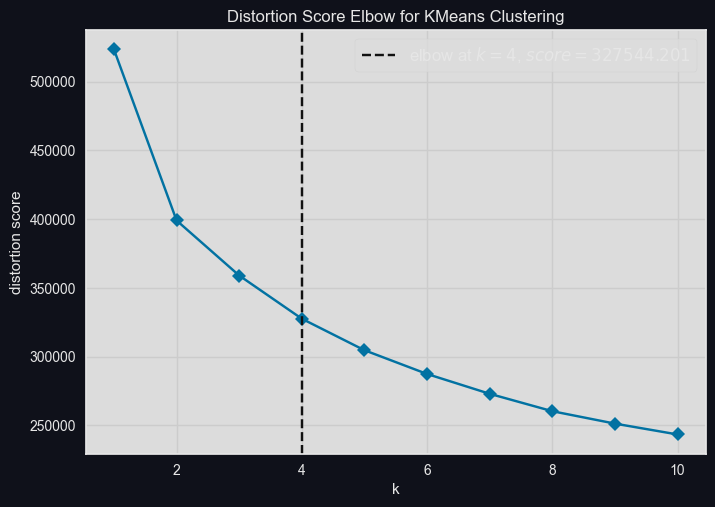

Silhouette score:  0.20198902246126277
WCSS:  327544.4036794595
Model Centroids: 
 [[ 0.75380321 -0.36540429  0.8666318  -0.27224079  0.22429013 -0.49534453
  -0.31103034  2.18763353  0.01268384  0.13249271  0.1038461 ]
 [ 0.06059368 -0.37809622  0.18243395  0.01567666  0.37066673 -0.10925254
  -0.31142912 -0.21943887  0.08395352  0.14725071  1.3520886 ]
 [ 0.06506417 -0.35146883  0.0573685  -0.0526372   0.37419592 -0.26624981
  -0.32697435 -0.34240467  0.15778076  0.24526183 -0.73959651]
 [-0.79855406  1.6387214  -1.02577731  0.30986305 -1.58022728  1.16660167
   1.44930629 -0.48452246 -0.50914738 -0.89725277 -0.06441232]]
Cluster (2) Size: 11487
Cluster (3) Size: 21156
Cluster (1) Size: 6360
Cluster (4) Size: 8589


In [9]:
elbowKNN, kmeansKNNElbow = elbowVisualizer(xKNN)
ncluster_KMeansKNN = elbowKNN
KMeansKNN_clf, dfKMeansKNN = KMeansModelGenerator(xKNN, ncluster_KMeansKNN)

Elbow Value:  3
Elbow Score:  449936.0165006577


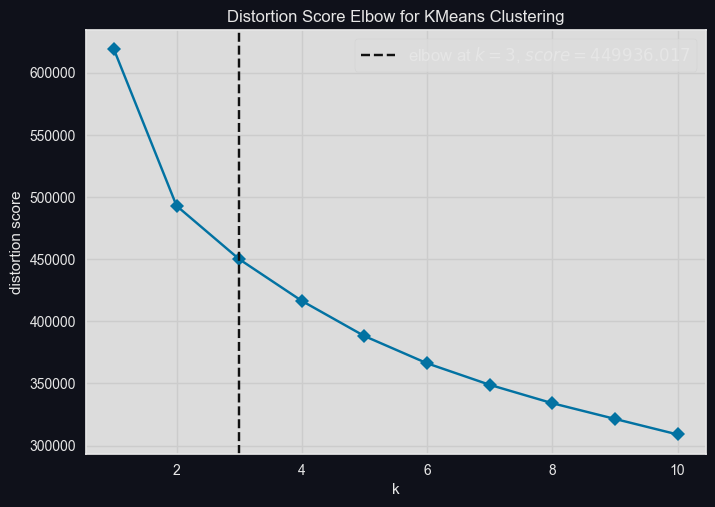

Silhouette score:  0.25026963049437245
WCSS:  449936.17234520905
Model Centroids: 
 [[ 0.26659266 -0.40775939  0.40613154 -0.1511992   0.32887146 -0.23033066
   0.04393073 -0.36262281  0.44304152  0.11345215  0.07827898  2.85954805
  -0.16809302]
 [-0.74657466  1.52277572 -0.92312224  0.30130667 -1.47409948  1.08208534
  -0.31742825  1.34880085 -0.48444873 -0.46289632 -0.82977286 -0.20082271
  -0.02152317]
 [ 0.18033512 -0.38725347  0.21205353 -0.06655192  0.38428127 -0.28367058
   0.08659061 -0.34280331  0.07844456  0.11921779  0.231574   -0.34970561
   0.03030713]]
Cluster (3) Size: 33172
Cluster (1) Size: 4736
Cluster (2) Size: 9684


In [8]:
elbowLR, kmeansLRElbow = elbowVisualizer(xLR)
ncluster_KMeansLR = elbowLR
KMeansLR_clf, dfKMeansLR = KMeansModelGenerator(xLR, ncluster_KMeansLR)


Elbow Value:  3
Elbow Score:  312745.5551197307


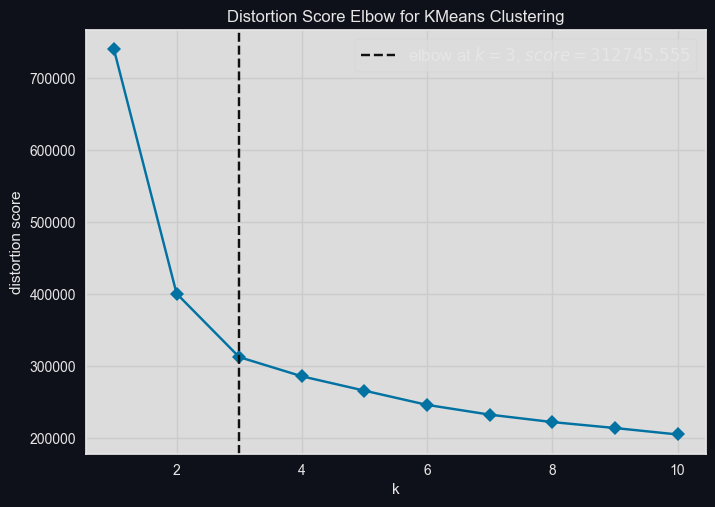

Silhouette score:  0.4105455806510139
WCSS:  312745.60181021056
Model Centroids: 
 [[ 4.16277888e-01  6.00469409e-02  4.83625542e-01 -9.20589307e-02
   9.56335094e-02  9.00888609e-02  6.51216172e-01 -2.33940771e-01
   4.00604640e+00  5.04299961e-02  9.70320893e-02  1.96100917e-01
   4.33342890e-01]
 [-5.19149354e-01  8.39920507e-01 -4.68773501e-01  5.75121119e-01
  -6.70283448e-01  6.64716010e+00  1.68356769e-01  8.39121356e-01
   5.53124742e-02 -1.87659646e-01 -3.26290396e-01  9.30307942e-02
   4.06158833e-01]
 [ 3.46536376e-02  2.19617378e-01 -3.29104614e-02  1.12921834e-01
  -3.10394356e-03  2.08867890e-01  4.60903823e-01 -8.91809770e-02
   1.49067691e-01  4.27440589e-02  1.02438724e-01  9.42890852e-02
   3.20334173e-01]]
Cluster (2) Size: 9255
Cluster (3) Size: 31368
Cluster (1) Size: 6969


In [11]:
elbowRF, kmeansRFElbow = elbowVisualizer(xRF)
ncluster_KMeansRF = elbowRF
KMeansRF_clf, dfKMeansRF = KMeansModelGenerator(xRF, ncluster_KMeansRF)

Elbow Value:  3
Elbow Score:  314128.83285195625


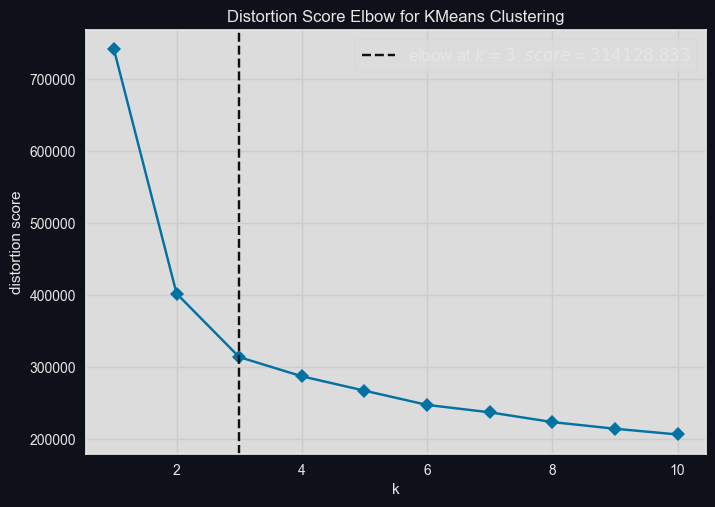

Silhouette score:  0.38090970032624377
WCSS:  314128.8729828111
Model Centroids: 
 [[-5.19149354e-01  8.39920507e-01 -4.68773501e-01  5.75121119e-01
  -6.70283448e-01  6.64716010e+00  1.68356769e-01  8.39121356e-01
   5.53124742e-02 -1.87659646e-01 -3.26290396e-01  9.30307942e-02
   3.92220421e-02  4.06158833e-01]
 [ 3.48728721e-02  2.19531980e-01 -3.28775256e-02  1.12793332e-01
  -2.97744198e-03  2.08896957e-01  4.60975706e-01 -8.92460475e-02
   1.49913809e-01  4.27552922e-02  1.02213397e-01  9.43745020e-02
   3.00557769e-02  3.20382470e-01]
 [ 4.16057298e-01  6.01109151e-02  4.84515824e-01 -9.18920238e-02
   9.52619692e-02  8.97190094e-02  6.51274925e-01 -2.33938624e-01
   4.00998934e+00  5.03948277e-02  9.80366773e-02  1.95920712e-01
   1.75237001e-02  4.33352485e-01]]
Cluster (1) Size: 9255
Cluster (2) Size: 31368
Cluster (3) Size: 6969


In [12]:
elbowMLP, kmeansMLPElbow = elbowVisualizer(xMLP)
ncluster_KMeansMLP = elbowMLP
KMeansMLP_clf, dfKMeansMLP = KMeansModelGenerator(xMLP, ncluster_KMeansMLP)

In [13]:
cluster_KMeansDT = dfKMeansDT['Cluster']
dfV_KMeansDT = dfV.copy()
dfV_KMeansDT['Cluster'] = cluster_KMeansDT
dfV_KMeansDT.groupby('Cluster').mean()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
Cluster,,,,,,,,,,,
1,33.577413,0.564639,0.460085,273271.890664,0.396532,0.797534,0.147259,-15.429765,0.051638,111.548227,0.326137
2,45.769118,0.249641,0.565136,236353.205900,0.647023,0.025087,0.186314,-7.633955,0.057398,121.686838,0.491611
3,54.209538,0.168766,0.690284,220146.419605,0.682900,0.010828,0.207769,-6.582366,0.285718,121.993819,0.489175


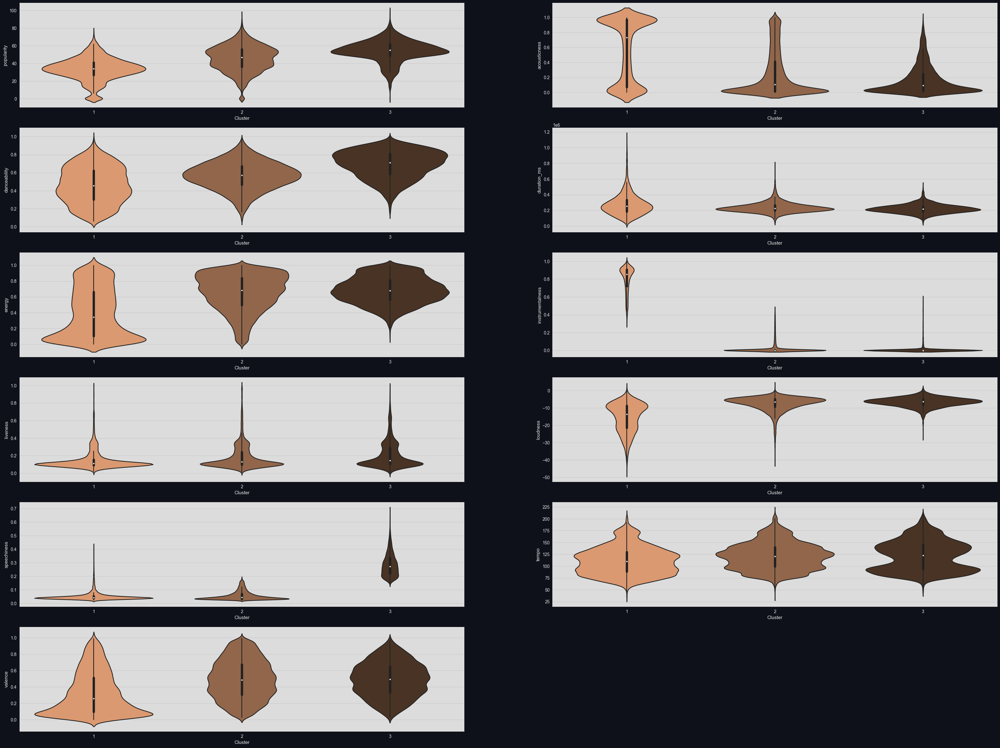

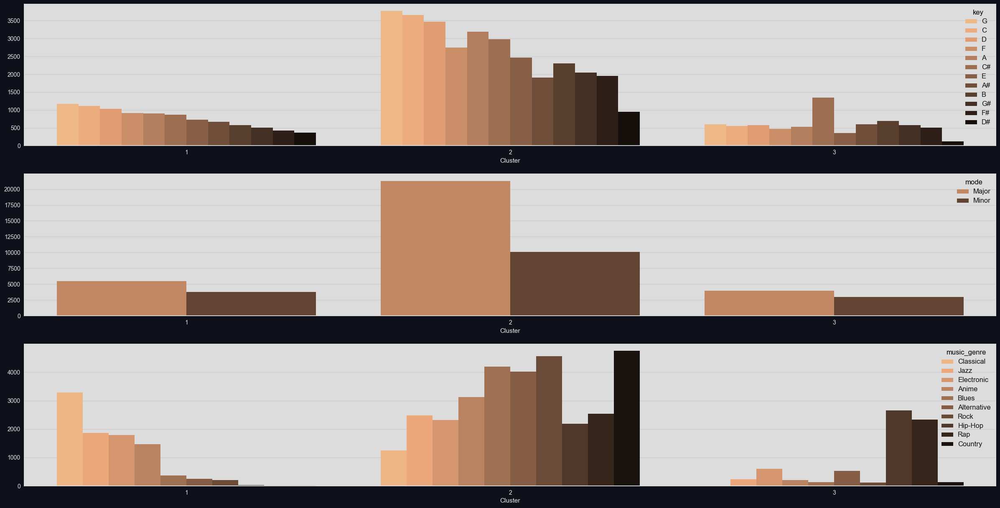

In [14]:
violinKMeansDT, barKMeansDT = clusterVisualization(dfV_KMeansDT, numCol, cateCol)

In [15]:
cluster_KMeansKNN = dfKMeansKNN['Cluster']
dfV_KMeansKNN = dfV.copy()
dfV_KMeansKNN['Cluster'] = cluster_KMeansKNN
dfV_KMeansKNN.groupby('Cluster').mean()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
Cluster,,,,,,,,,,,
1,56.173113,0.175456,0.715934,218151.826310,0.662391,0.015063,0.202209,-6.768306,0.291538,120.130227,0.491594
2,45.556890,0.171407,0.595142,242515.564435,0.700738,0.138440,0.185008,-6.895967,0.069201,122.199862,0.495216
3,45.625165,0.180593,0.573055,236702.204323,0.701567,0.088218,0.191329,-6.802310,0.057889,124.368161,0.519250
4,32.356852,0.853801,0.381382,267483.750572,0.188244,0.546891,0.139105,-18.869824,0.044768,104.863153,0.238320


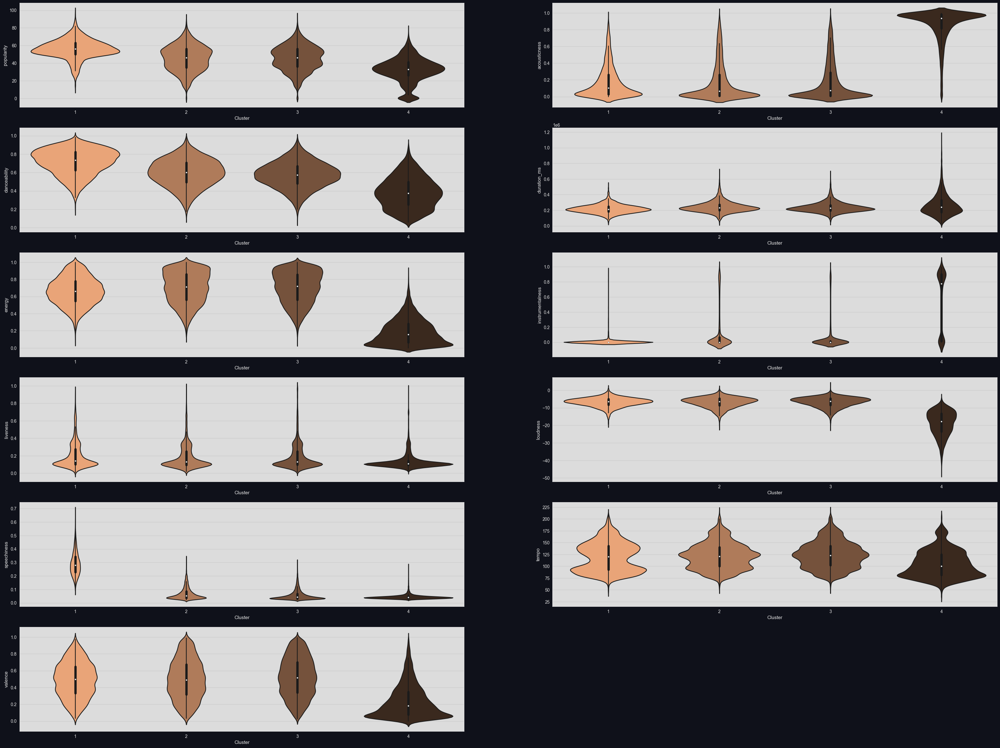

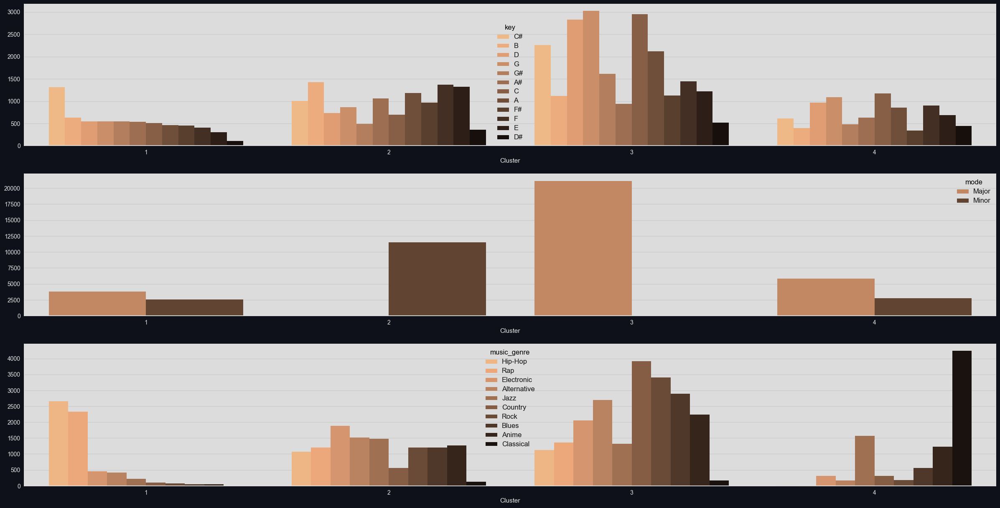

In [16]:
violinKMeansKNN, barKMeansKNN = clusterVisualization(dfV_KMeansKNN, numCol, cateCol)

In [17]:
cluster_KMeansLR = dfKMeansLR['Cluster']
dfV_KMeansLR = dfV.copy()
dfV_KMeansLR['Cluster'] = cluster_KMeansLR
dfV_KMeansLR.groupby('Cluster').mean()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
Cluster,,,,,,,,,,,
1,48.710093,0.161244,0.634641,228365.452280,0.689877,0.099733,0.187969,-6.685167,0.130368,123.073260,0.478292
2,33.171727,0.814842,0.399536,266702.011738,0.215907,0.519532,0.137464,-17.956290,0.044759,106.202918,0.254826
3,47.383516,0.168340,0.600332,235561.033663,0.704306,0.082786,0.193909,-6.713292,0.096691,123.242388,0.515927


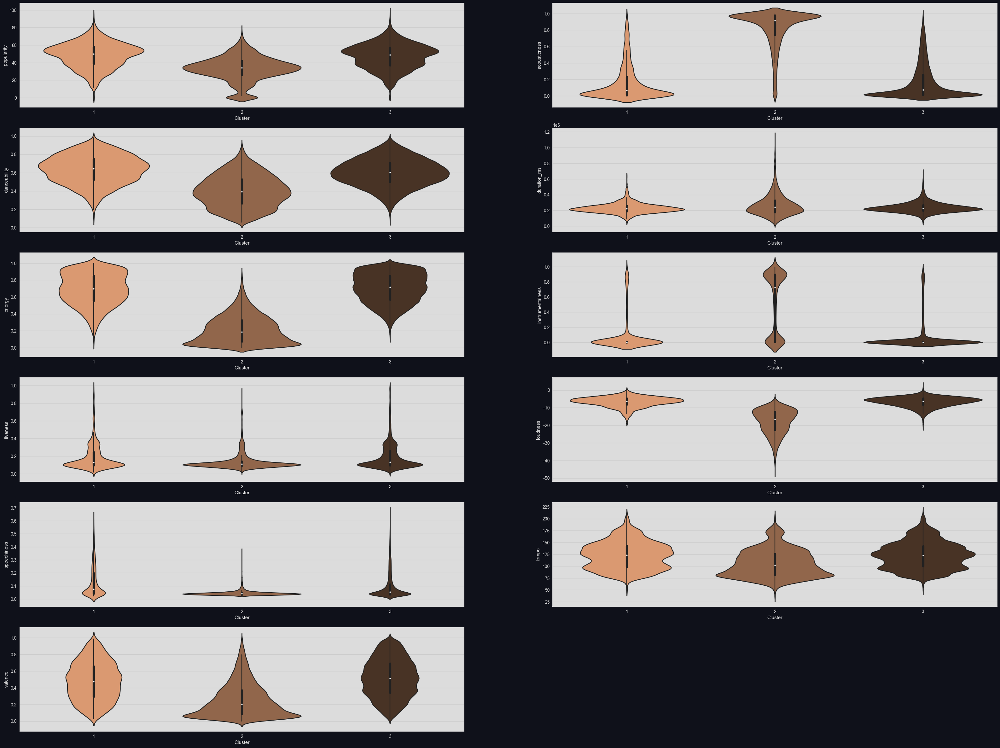

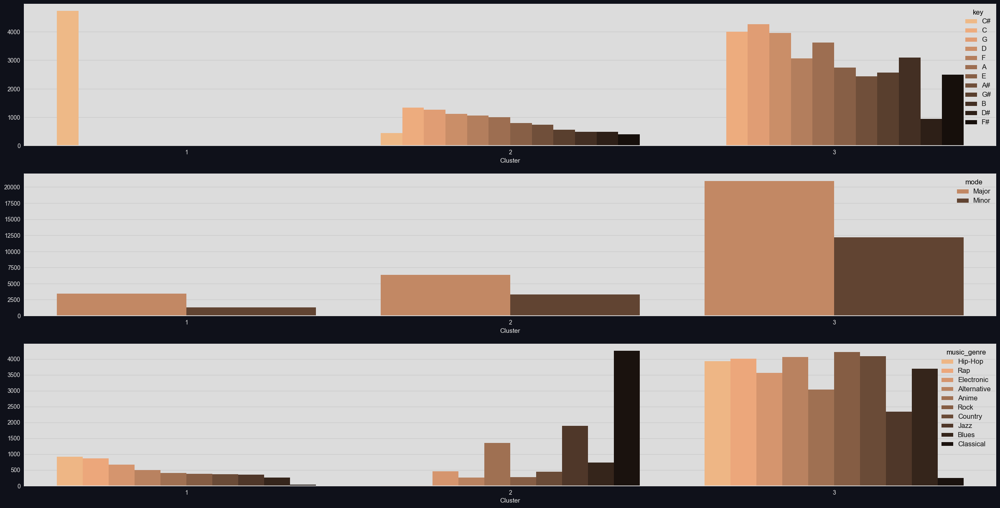

In [18]:
violinKMeansLR, barKMeansLR = clusterVisualization(dfV_KMeansLR, numCol, cateCol)

In [19]:
cluster_KMeansRF = dfKMeansRF['Cluster']
dfV_KMeansRF = dfV.copy()
dfV_KMeansRF['Cluster'] = cluster_KMeansRF
dfV_KMeansRF.groupby('Cluster').mean()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
Cluster,,,,,,,,,,,
1,54.151241,0.168673,0.689738,220092.569044,0.683843,0.010885,0.211240,-6.576038,0.284872,122.029508,0.489673
2,33.578714,0.565268,0.460026,273216.705673,0.395973,0.797783,0.146543,-15.438759,0.051663,111.544305,0.326052
3,45.765780,0.249673,0.565055,236415.007258,0.646867,0.025195,0.185711,-7.636090,0.057220,121.677325,0.491492


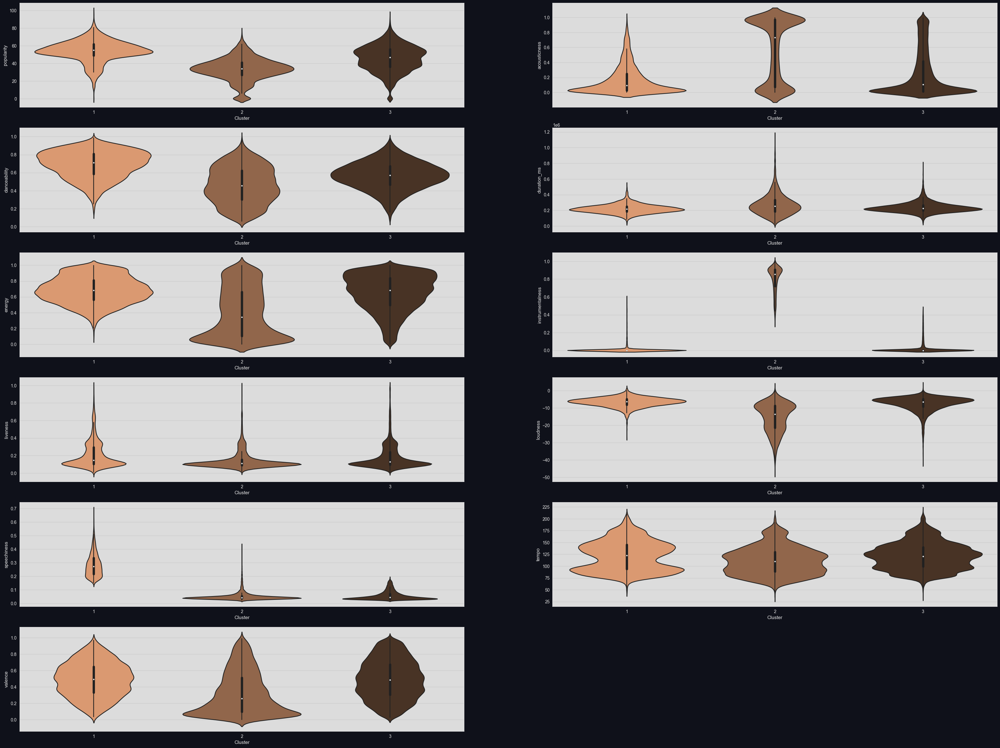

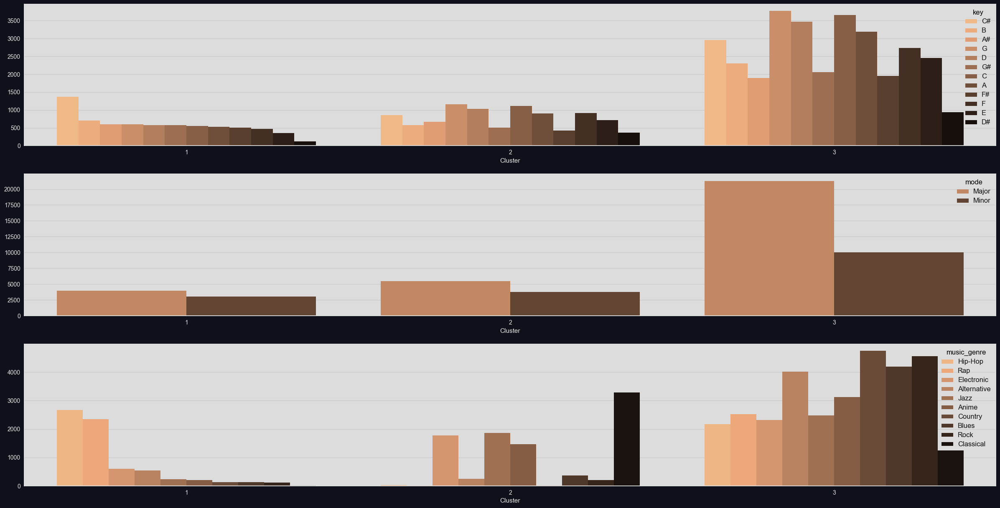

In [20]:
violinKMeansRF, barKMeansRF = clusterVisualization(dfV_KMeansRF, numCol, cateCol)

In [21]:
cluster_KMeansMLP = dfKMeansMLP['Cluster']
dfV_KMeansMLP = dfV.copy()
dfV_KMeansMLP['Cluster'] = cluster_KMeansMLP
dfV_KMeansMLP.groupby('Cluster').mean()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
Cluster,,,,,,,,,,,
1,33.578714,0.565268,0.460026,273216.705673,0.395973,0.797783,0.146543,-15.438759,0.051663,111.544305,0.326052
2,45.765780,0.249673,0.565055,236415.007258,0.646867,0.025195,0.185711,-7.636090,0.057220,121.677325,0.491492
3,54.151241,0.168673,0.689738,220092.569044,0.683843,0.010885,0.211240,-6.576038,0.284872,122.029508,0.489673


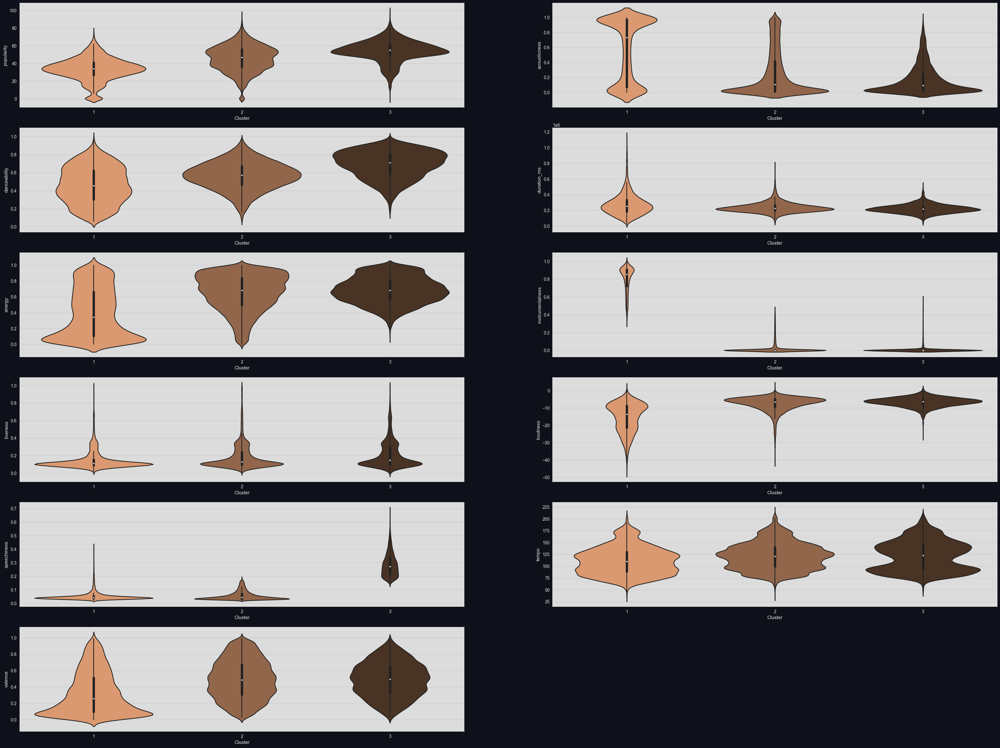

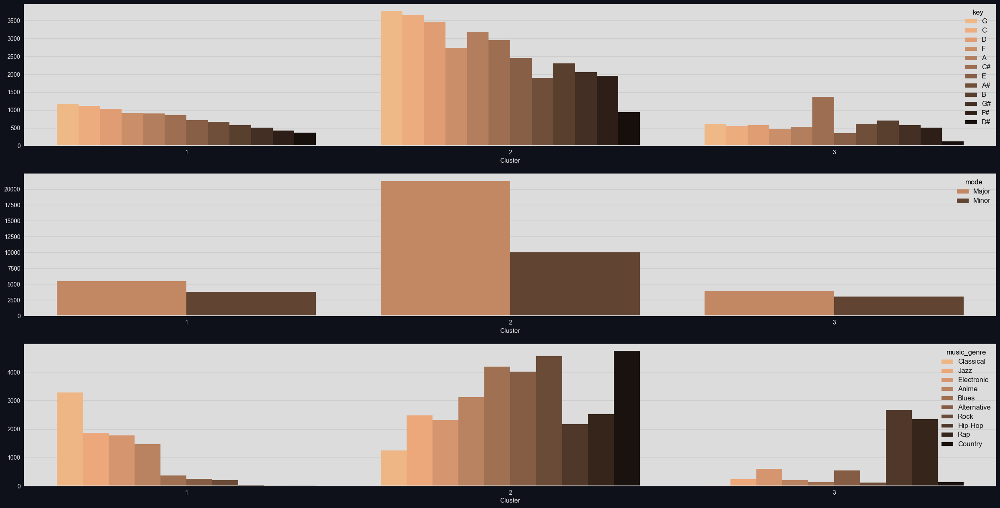

In [22]:
violinKMeansMLP, barKMeansMLP = clusterVisualization(dfV_KMeansMLP, numCol, cateCol)

### **Agglomerative Clustering**

In [23]:
def distMatGenerator(dataFrame, cacheName=None):
    if os.path.exists(f"Data/linkageCache/{cacheName}.csv"):
        print('Loading from cache...')
        Z = np.loadtxt(f"Data/linkageCache/{cacheName}.csv", delimiter=',')
    else:
        print('Calculating...')
        Z = linkage(dataFrame, method='ward')
    
    if not os.path.exists('Data/linkageCache'):
        os.makedirs('Data/linkageCache')

    if cacheName is not None:
        np.savetxt(f"Data/linkageCache/{cacheName}.csv", Z, delimiter=",")

    print('Distance of Last 8 Clusters from linkage array: ')
    print(Z[-8:, 2].reshape(8,1))
    print('Distance between last 8 Clusters: ')
    print(Z[-8:, 2].reshape(8,1) - Z[-9:-1, 2].reshape(8,1))
    print('='*50)

    return Z

In [24]:
def HierModelGenerator(dataFrame, max_cluster, Z, cacheName=None):
    bestSilScore = 0
    bestK = 0
    n_cluster = 0
    df = dataFrame.copy()
    
    if cacheName is not None:
        if not os.path.exists(f"Data/hierCache/HierClusters.json"):
            with open(f"Data/hierCache/HierClusters.json", 'w') as f:
                json.dump({}, f)
        with open(f"Data/hierCache/HierClusters.json", 'r') as f:
            updateCache = json.load(f)
            n_cluster = updateCache[cacheName] if cacheName in updateCache else 0

    if n_cluster == 0 or n_cluster > max_cluster:
        print('Calculating...')
        for k in range(2, max_cluster+1):
            clusters = fcluster(Z, k, criterion='maxclust')

            df['Cluster'] = clusters
            
            silhouetteScore = silhouette_score(dataFrame, clusters, metric='euclidean', random_state=1)
            print(f'Silhouette score (k={k}): {silhouetteScore}')

            if silhouetteScore > bestSilScore or bestK == 0:
                bestSilScore = silhouetteScore
                bestK = k
                bestDF = df.copy()
        
        df = bestDF.copy()
        print('='*50)
        print(f'Best Silhouette Score: {bestSilScore}')
        print(f'Best K: {bestK}')
        print('='*50)

        if cacheName is not None:
            updateCache[cacheName] = bestK
            with open(f"Data/hierCache/HierClusters.json", 'w') as f:
                json.dump(updateCache, f)
    else:
        print('Loading from cache...')
        clusters = fcluster(Z, n_cluster, criterion='maxclust')

        df['Cluster'] = clusters

        silhouetteScore = silhouette_score(dataFrame, clusters, metric='euclidean', random_state=1)
        print(f'Silhouette score (k={n_cluster}): {silhouetteScore}')

    for var in df['Cluster'].unique():
        print(f"Cluster ({var}) Size: {df[df['Cluster'] == var].shape[0]}")
    print('='*50)
    return df

In [25]:
ZDT = distMatGenerator(xDT, 'linkage_DT')
dfHierDT = HierModelGenerator(xDT, 10, ZDT, 'Hier_DT')

Loading from cache...
Distance of Last 8 Clusters from linkage array: 
[[116.08249331]
 [144.85169041]
 [156.5123412 ]
 [169.41647326]
 [199.01220345]
 [199.44436721]
 [396.92686434]
 [812.96301644]]
Distance between last 8 Clusters: 
[[ 15.45782478]
 [ 28.7691971 ]
 [ 11.66065079]
 [ 12.90413205]
 [ 29.59573019]
 [  0.43216376]
 [197.48249713]
 [416.0361521 ]]
Loading from cache...
Silhouette score (k=2): 0.5239420266009056
Cluster (1) Size: 9920
Cluster (2) Size: 37672


In [26]:
ZKNN = distMatGenerator(xKNN, 'linkage_KNN')
dfHierKNN = HierModelGenerator(xKNN, 10, ZKNN, 'Hier_KNN')

Loading from cache...
Distance of Last 8 Clusters from linkage array: 
[[129.72980351]
 [143.84166224]
 [158.89035019]
 [159.84449933]
 [208.81039775]
 [236.6327341 ]
 [269.10086872]
 [475.0467936 ]]
Distance between last 8 Clusters: 
[[  7.64569553]
 [ 14.11185873]
 [ 15.04868795]
 [  0.95414914]
 [ 48.96589842]
 [ 27.82233635]
 [ 32.46813462]
 [205.94592487]]
Loading from cache...
Silhouette score (k=2): 0.30368612197277284
Cluster (2) Size: 40221
Cluster (1) Size: 7371


In [27]:
ZLR = distMatGenerator(xLR, 'linkage_LR')
dfHierLR = HierModelGenerator(xLR, 10, ZLR, 'Hier_LR')

Loading from cache...
Distance of Last 8 Clusters from linkage array: 
[[141.14781782]
 [185.43326904]
 [197.91108958]
 [227.95414396]
 [230.63687152]
 [231.41952313]
 [295.85388256]
 [456.58621564]]
Distance between last 8 Clusters: 
[[ 14.40452798]
 [ 44.28545122]
 [ 12.47782054]
 [ 30.04305438]
 [  2.68272756]
 [  0.78265161]
 [ 64.43435943]
 [160.73233308]]
Loading from cache...
Silhouette score (k=2): 0.2005508198625577
Cluster (2) Size: 37121
Cluster (1) Size: 10471


In [28]:
ZRF = distMatGenerator(xRF, 'linkage_RF')
dfHierRF = HierModelGenerator(xRF, 10, ZRF, 'Hier_RF')

Loading from cache...
Distance of Last 8 Clusters from linkage array: 
[[138.68508071]
 [139.23019827]
 [139.79291576]
 [171.36266161]
 [192.48140317]
 [192.59805004]
 [403.77884152]
 [817.34208087]]
Distance between last 8 Clusters: 
[[9.34498584e+00]
 [5.45117555e-01]
 [5.62717493e-01]
 [3.15697459e+01]
 [2.11187416e+01]
 [1.16646868e-01]
 [2.11180791e+02]
 [4.13563239e+02]]
Loading from cache...
Silhouette score (k=2): 0.4936149468931683
Cluster (1) Size: 9696
Cluster (2) Size: 37896


In [29]:
ZMLP = distMatGenerator(xMLP, 'linkage_MLP')
dfHierMLP = HierModelGenerator(xMLP, 10, ZMLP, 'Hier_MLP')

Loading from cache...
Distance of Last 8 Clusters from linkage array: 
[[124.22181594]
 [140.58948393]
 [147.06443142]
 [170.35662814]
 [181.92641687]
 [214.76116843]
 [409.43766487]
 [817.87937858]]
Distance between last 8 Clusters: 
[[  6.73383254]
 [ 16.36766799]
 [  6.47494749]
 [ 23.29219672]
 [ 11.56978872]
 [ 32.83475157]
 [194.67649644]
 [408.44171371]]
Loading from cache...
Silhouette score (k=2): 0.5013451014755653
Cluster (1) Size: 9052
Cluster (2) Size: 38540


In [30]:
cluster_HierDT = dfHierDT['Cluster']
dfV_HierDT = dfV.copy()
dfV_HierDT['Cluster'] = cluster_HierDT
dfV_HierDT.groupby('Cluster').mean()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
Cluster,,,,,,,,,,,
1,34.259073,0.531531,0.468416,271228.438575,0.422812,0.766109,0.150200,-14.782263,0.051655,112.813664,0.341491
2,47.352994,0.238001,0.587765,233269.419242,0.651069,0.017251,0.190162,-7.475126,0.099434,121.587093,0.490011


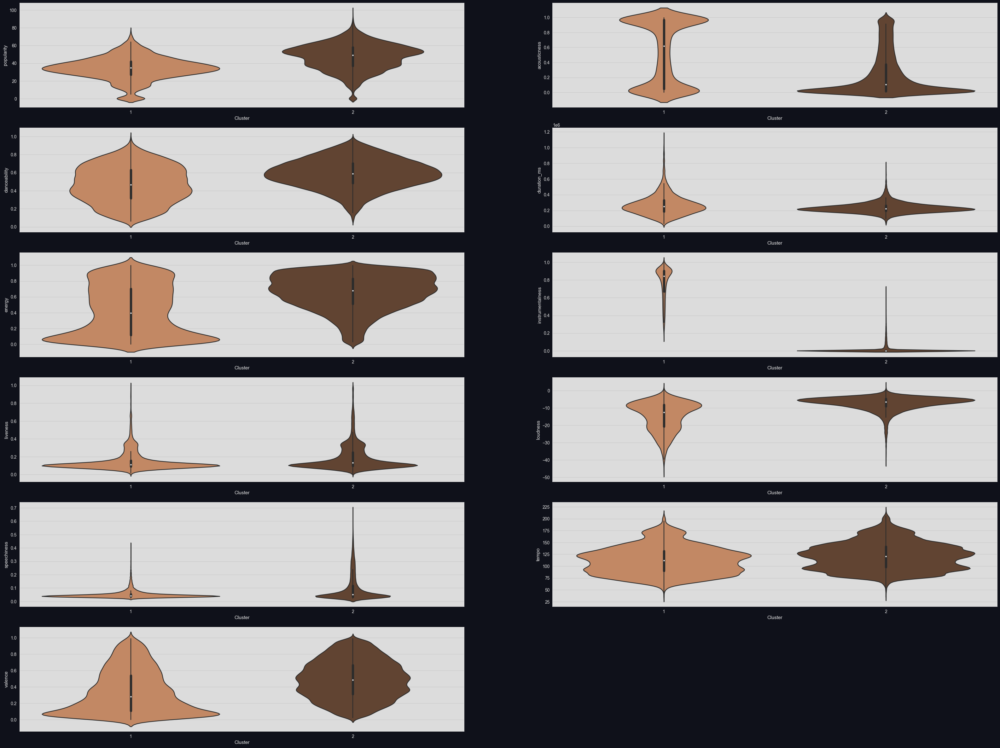

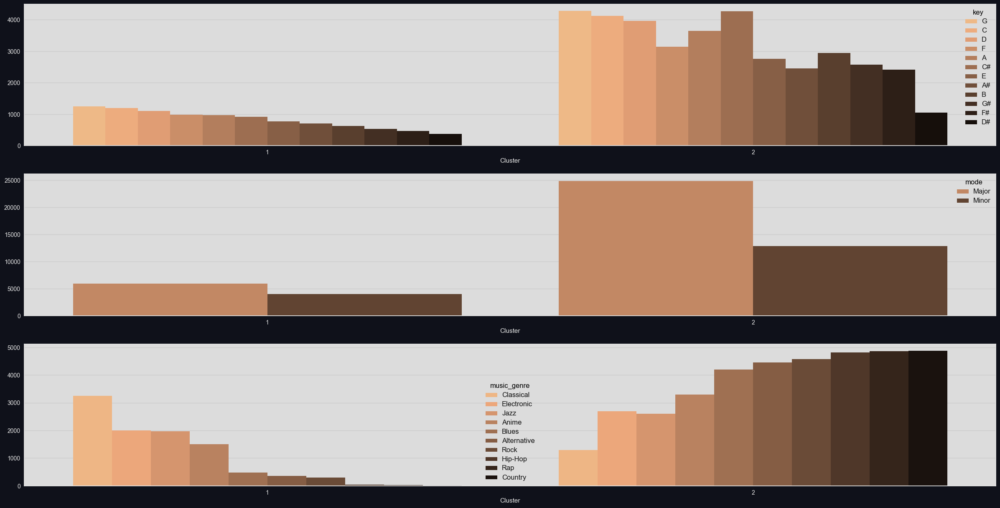

In [31]:
violinHierDT, barHierDT = clusterVisualization(dfV_HierDT, numCol, cateCol)

In [32]:
cluster_HierKNN = dfHierKNN['Cluster']
dfV_HierKNN = dfV.copy()
dfV_HierKNN['Cluster'] = cluster_HierKNN
dfV_HierKNN.groupby('Cluster').mean()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
Cluster,,,,,,,,,,,
1,31.851445,0.887288,0.359595,264074.723330,0.164755,0.539310,0.138680,-19.675815,0.044418,104.882972,0.228704
2,46.964397,0.191407,0.600144,236986.074107,0.683895,0.106273,0.189741,-7.041410,0.097732,122.484476,0.501268


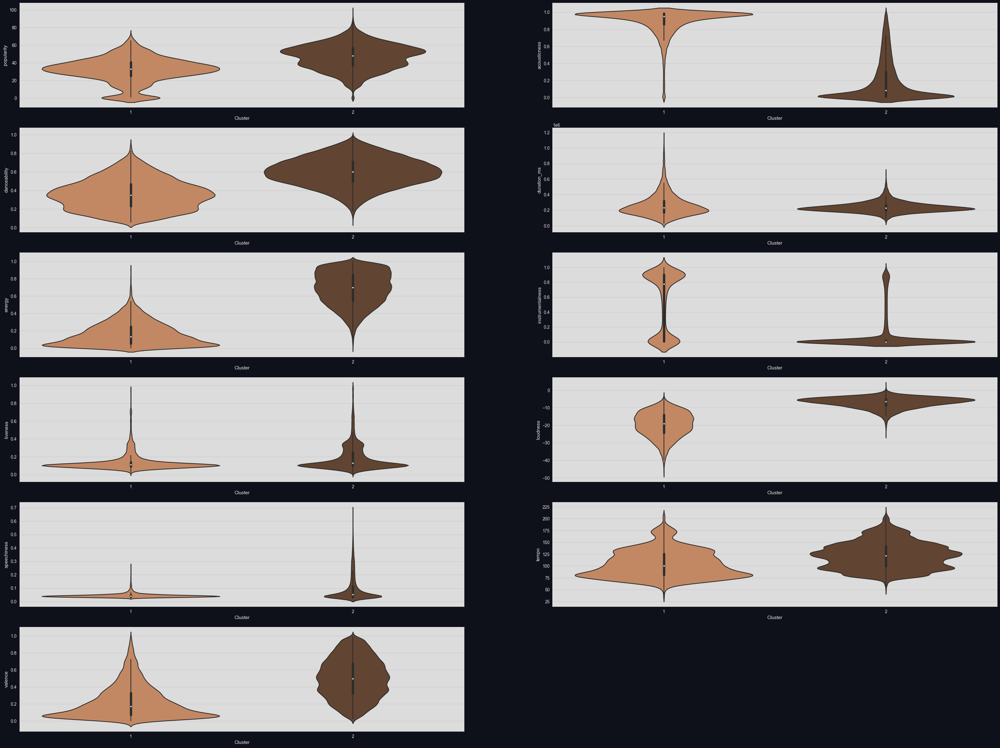

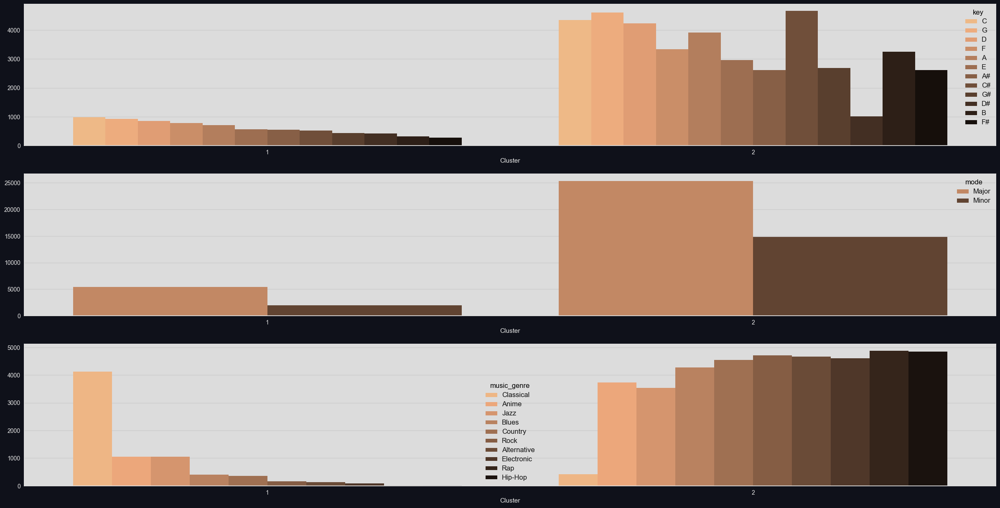

In [33]:
violinHierKNN, barHierKNN = clusterVisualization(dfV_HierKNN, numCol, cateCol)

In [34]:
cluster_HierLR = dfHierLR['Cluster']
dfV_HierLR = dfV.copy()
dfV_HierLR['Cluster'] = cluster_HierLR
dfV_HierLR.groupby('Cluster').mean()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
Cluster,,,,,,,,,,,
1,35.802120,0.760261,0.407440,266904.382198,0.256673,0.383535,0.139485,-16.621541,0.044358,107.986211,0.270829
2,47.112093,0.169125,0.606737,233925.699371,0.701321,0.114051,0.193778,-6.847844,0.102202,123.079036,0.512147


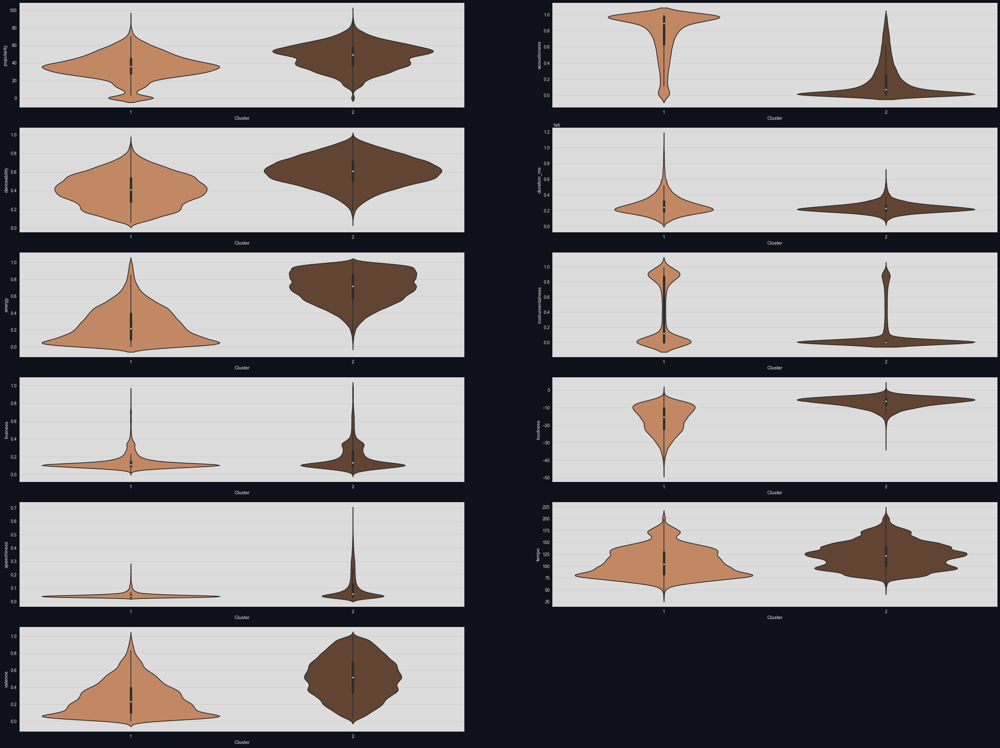

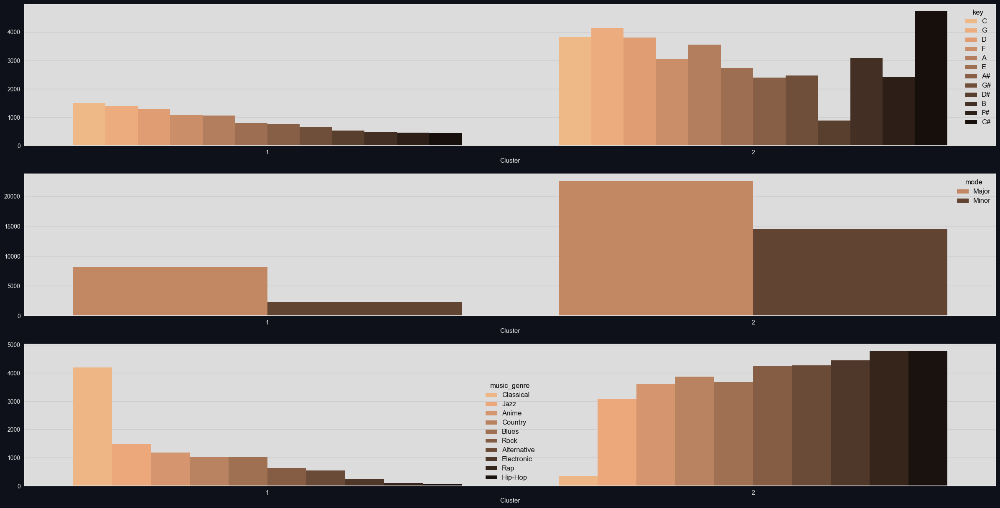

In [35]:
violinHierLR, barHierLR = clusterVisualization(dfV_HierLR, numCol, cateCol)

In [36]:
cluster_HierRF = dfHierRF['Cluster']
dfV_HierRF = dfV.copy()
dfV_HierRF['Cluster'] = cluster_HierRF
dfV_HierRF.groupby('Cluster').mean()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
Cluster,,,,,,,,,,,
1,33.815078,0.558172,0.462678,270337.710018,0.401825,0.775149,0.148143,-15.26674,0.051464,111.791193,0.331409
2,47.389197,0.232920,0.588528,233721.691894,0.655089,0.019364,0.190452,-7.39436,0.099201,121.796841,0.491712


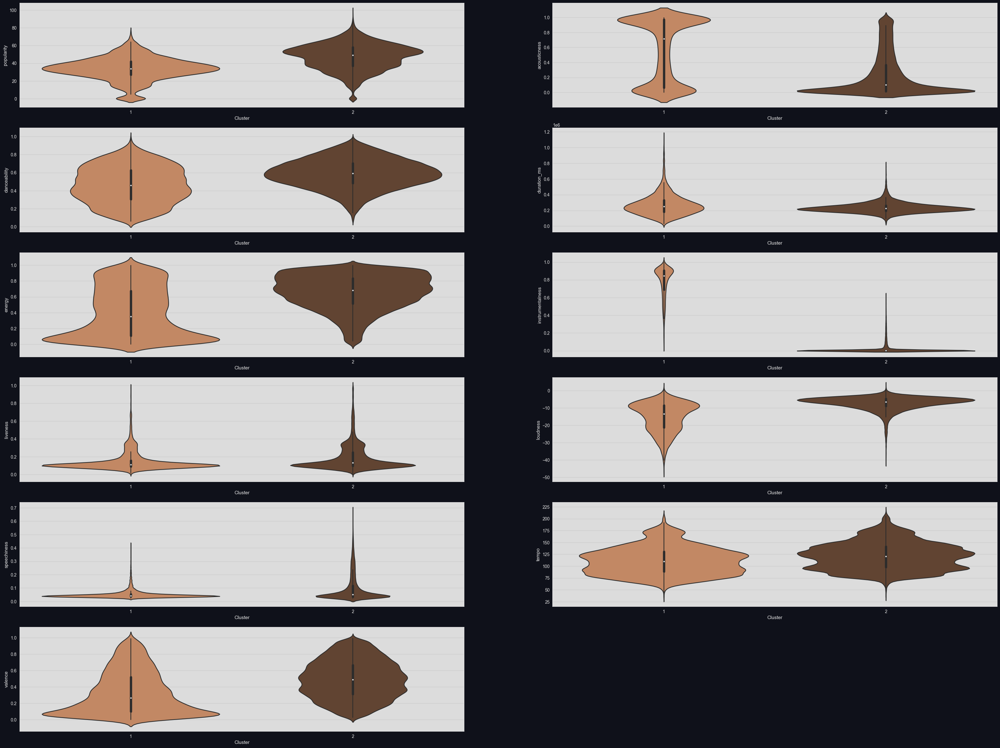

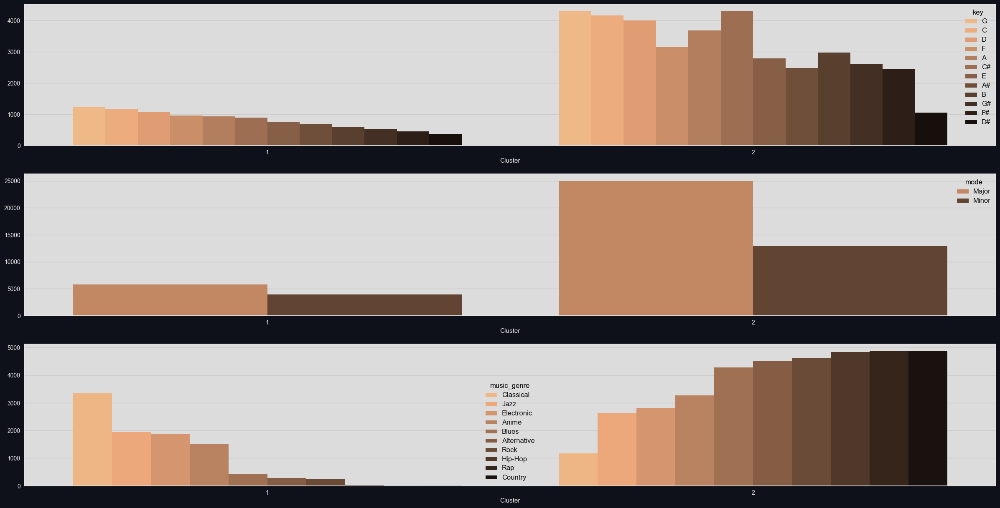

In [37]:
violinHierRF, barHierRF = clusterVisualization(dfV_HierRF, numCol, cateCol)

In [38]:
cluster_HierMLP = dfHierMLP['Cluster']
dfV_HierMLP = dfV.copy()
dfV_HierMLP['Cluster'] = cluster_HierMLP
dfV_HierMLP.groupby('Cluster').mean()

,popularity,acousticness,danceability,duration_ms,energy,instrumentalness,liveness,loudness,speechiness,tempo,valence
Cluster,,,,,,,,,,,
1,33.475917,0.573195,0.458418,274046.983724,0.390958,0.801787,0.146446,-15.534186,0.050759,111.661533,0.325123
2,47.242034,0.234827,0.587425,233462.334605,0.653410,0.025737,0.190144,-7.463091,0.098569,121.660102,0.490510


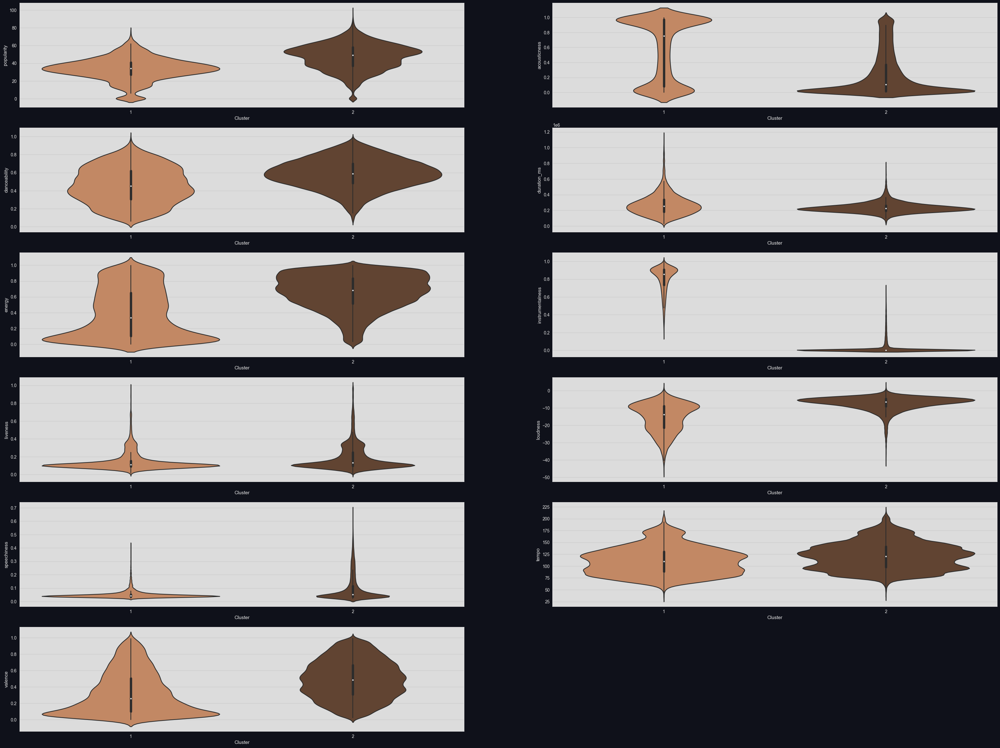

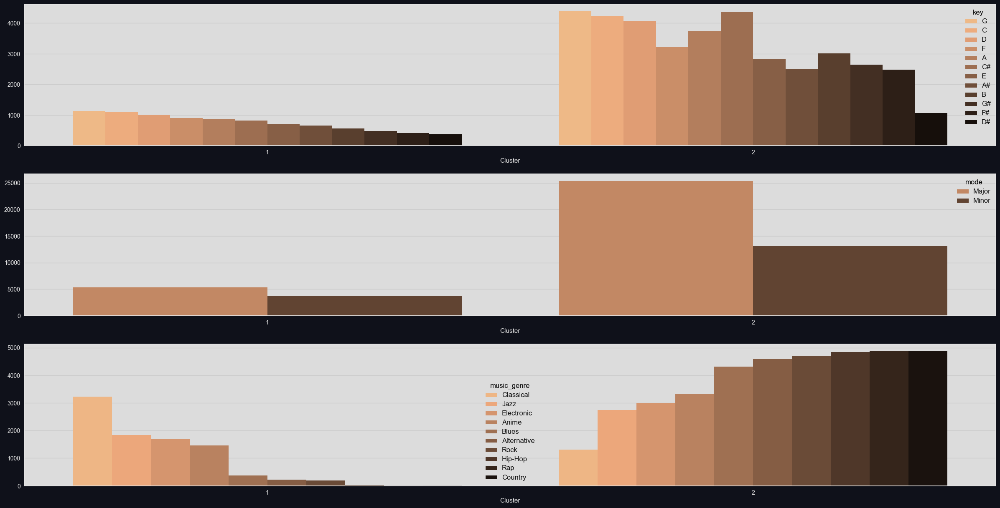

In [39]:
violinHierMLP, barHierMLP = clusterVisualization(dfV_HierMLP, numCol, cateCol)

### **Real Modeling**

In [40]:
def modelTestProcessFE(dfdict ,verbose=0):
    verboseprint = print if verbose==1 else lambda *a, **k: None
    # Model
    LR_clf = LogisticRegression(n_jobs=-1, random_state=1,multi_class='multinomial')
    DT_clf = DecisionTreeClassifier(random_state=1)
    RF_clf = RandomForestClassifier(n_jobs=-1, random_state=1)
    KNN_clf = KNeighborsClassifier(n_jobs=-1)
    MLPC_clf = MLPClassifier(random_state=1)
    # SVC_clf = LinearSVC(random_state=1,multi_class='crammer_singer') # U take too much time
    modeldict = {'Logistic Regression Model':LR_clf, 'Decision Tree Model':DT_clf, 'Random Forest Model':RF_clf,
                'KNN Model':KNN_clf, 'MLPC Model':MLPC_clf}
    # Training
    traintestdict = {}
    for modelname, model in modeldict.items():
        X = dfdict[modelname].drop(['music_genre'],axis=1)
        y = dfdict[modelname]['music_genre']
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=1)
        traintestdict[modelname] = [X_train, X_test, y_train, y_test]
        model.fit(X_train, y_train)
        verboseprint(f'{modelname} trained.')
        verboseprint(f'-'*50)
    # Testing
    resultdict = {}
    confusion_matrix_dict = {}
    f1scoredict = {}
    for modelname, model in modeldict.items():
        X_train, X_test, y_train, y_test = traintestdict[modelname]
        y_pred = model.predict(X_test)
        resultdict[modelname] = classification_report(y_test, y_pred)
        confusion_matrix_dict[modelname] = confusion_matrix(y_test, y_pred)
        f1scoredict[modelname] = f1_score(y_test, y_pred, average='weighted')
    for key, value in f1scoredict.items():
        print(f'{key} (F1 score) : {value}')
    return modeldict, resultdict, confusion_matrix_dict, f1scoredict

In [11]:
dfKMeansDT = pd.concat([dfKMeansDT, yDT], axis=1)
dfKMeansKNN = pd.concat([dfKMeansKNN, yKNN], axis=1)
dfKMeansLR = pd.concat([dfKMeansLR, yLR], axis=1)
dfKMeansRF = pd.concat([dfKMeansRF, yRF], axis=1)
dfKMeansMLP = pd.concat([dfKMeansMLP, yMLP], axis=1)

dfHierDT = pd.concat([dfHierDT, yDT], axis=1)
dfHierKNN = pd.concat([dfHierKNN, yKNN], axis=1)
dfHierLR = pd.concat([dfHierLR, yLR], axis=1)
dfHierRF = pd.concat([dfHierRF, yRF], axis=1)
dfHierMLP = pd.concat([dfHierMLP, yMLP], axis=1)

NameError: name 'dfKMeansDT' is not defined

In [42]:
dfKMeansDict = {'Logistic Regression Model':dfKMeansLR,
                'Decision Tree Model':dfKMeansDT,
                'Random Forest Model':dfKMeansRF,
                'KNN Model':dfKMeansKNN,
                'MLPC Model':dfKMeansMLP}

dfHierDict = {'Logistic Regression Model':dfHierLR,
              'Decision Tree Model':dfHierDT,
              'Random Forest Model':dfHierRF,
              'KNN Model':dfHierKNN,
              'MLPC Model':dfHierMLP}

In [43]:
bestModel_KMeans, res_KMeans, confMat_KMeans, f1s_KMeans = modelTestProcessFE(dfKMeansDict, verbose=0)

Logistic Regression Model (F1 score) : 0.5406364828076667
Decision Tree Model (F1 score) : 0.4435197988385712
Random Forest Model (F1 score) : 0.5571831269191239
KNN Model (F1 score) : 0.5114730733360549
MLPC Model (F1 score) : 0.6016884667497465


In [44]:
bestModel_Hier, res_Hier, confMat_Hier, f1s_Hier = modelTestProcessFE(dfHierDict, verbose=0)

Logistic Regression Model (F1 score) : 0.5393855259633985
Decision Tree Model (F1 score) : 0.4428870513299256
Random Forest Model (F1 score) : 0.5619798090713762
KNN Model (F1 score) : 0.5133930025637373
MLPC Model (F1 score) : 0.6018491619405515


### **Hyperparameter Tuning**

Choosing Solver for Logistic Regression:
[Stack-sama](https://stackoverflow.com/questions/38640109/logistic-regression-python-solvers-definitions)

In [24]:
def paramTuning(**kwargs):
    f1sc = make_scorer(f1_score, average='weighted')

    if os.path.exists('Data/paramTuning/tuned.json'):
        with open('Data/paramTuning/tuned.json', 'r') as f:
            tuned = json.load(f)
    else:
        os.makedirs('Data/paramTuning') if not os.path.exists('Data/paramTuning') else None
        tuned = {}
        with open('Data/paramTuning/tuned.json', 'w') as f:
            json.dump(tuned, f)

    DT_param, dfDT, yDT = kwargs['DT'] if 'DT' in kwargs else None, None, None
    LR_param, dfLR, yLR = kwargs['LR'] if 'LR' in kwargs else None, None, None
    RF_param, dfRF, yRF = kwargs['RF'] if 'RF' in kwargs else None, None, None
    KNN_param, dfKNN, yKNN = kwargs['KNN'] if 'KNN' in kwargs else None, None, None
    
    DT_clf = DecisionTreeClassifier(random_state=1)
    LR_clf = LogisticRegression(solver='saga', n_jobs=-1, random_state=1, multi_class='multinomial')
    RF_clf = RandomForestClassifier(n_jobs=-1, random_state=1)
    KNN_clf = KNeighborsClassifier(n_jobs=-1)

    grid_DT_clf = GridSearchCV(DT_clf, param_grid=DT_param, cv=4, scoring=f1sc, n_jobs=-1)
    grid_LR_clf = GridSearchCV(LR_clf, param_grid=LR_param, cv=4, scoring=f1sc, n_jobs=-1)
    grid_RF_clf = GridSearchCV(RF_clf, param_grid=RF_param, cv=4, scoring=f1sc, n_jobs=-1)
    grid_KNN_clf = GridSearchCV(KNN_clf, param_grid=KNN_param, cv=4, scoring=f1sc, n_jobs=-1)

    modelDict = {'DecisionTreeClassifier': [grid_DT_clf, dfDT, yDT], 
                'LogisticRegression': [grid_LR_clf, dfLR, yLR], 
                'RandomForestClassifier': [grid_RF_clf, dfRF, yRF], 
                'KNeighborsClassifier': [grid_KNN_clf, dfKNN, yKNN]}
    for key, value in modelDict.items():
        if key not in tuned and value[1] is not None:
            X_train, _, y_train, _ = train_test_split(value[1], value[2], test_size=0.2, random_state=1)
            value[0].fit(X_train, y_train)
            tuned[key] = value[0].best_params_
            with open('Data/paramTuning/tuned.json', 'w') as f:
                json.dump(tuned, f)
            print(f'{key} tuned.\n Tuned Params: {tuned[key]}')
        elif key in tuned:
            print(f'{key} already tuned.\n Tuned Params: {tuned[key]}')
    return tuned

In [26]:
def MLPTuning(data, number=0):
    if os.path.exists(f'Data/paramTuning/tunedMLP.json'):
        with open(f'Data/paramTuning/tunedMLP.json', 'r') as f:
            tuned = json.load(f)
        if number == 1:
            tuned = tuned['MLPClassifier1']
        elif number == 2:
            tuned = tuned['MLPClassifier2']
        else:
            raise ValueError('\'number\' must be 1 or 2')
        print(f'MLPClassifier{number} already tuned.\n Tuned Params: {tuned}')
    else:
        os.makedirs('Data/paramTuning') if not os.path.exists('Data/paramTuning') else None
        tuned = {}
        with open(f'Data/paramTuning/tunedMLP.json', 'w') as f:
            json.dump(tuned, f)

        f1sc = make_scorer(f1_score, average='weighted')
        MLP_param, dfMLP, yMLP = data
        if number == 1:
            MLP_clf = MLPClassifier(random_state=1,)
        elif number == 2:
            tunedParam1 = tuned['MLPClassifier1']
            MLP_clf = MLPClassifier(random_state=1, **tunedParam1)
        else:
            raise ValueError('\'number\' must be 1 or 2')
            
        grid = GridSearchCV(MLP_clf, param_grid=MLP_param, cv=4, scoring=f1sc, n_jobs=-1)
        X_train, _, y_train, _ = train_test_split(dfMLP, yMLP, test_size=0.2, random_state=1)
        grid.fit(X_train, y_train)

        tuned[f'MLPClassifier{number}'] = grid.best_params_
        with open(f'Data/paramTuning/tunedMLP{number}.json', 'w') as f:
            json.dump(tuned, f)
        print(f'MLPClassifier{number} tuned.\n Tuned Params: {tuned[f"MLPClassifier{number}"]}')
    return tuned

In [54]:
DT_param = [{'criterion': ['entropy', 'gini', 'log_loss'],
            'splitter': ['best', 'random'],
            'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, None],
            'max_features': ['auto', 'sqrt', 'log2'],
            'min_samples_split': [2, 5, 10],
            'min_samples_leaf': [1, 2, 4],
            }]

LR_param = [{'penalty': ['l1', 'l2', 'none'],
            'C': [0.001, 0.01, 0.1, 1, 10, 100, 1000],
            'tol': [1e-4, 1e-3, 1e-2, 1e-1],
            }]

RF_param = [{'n_estimators': [10, 50, 100, 150],
            'criterion': ['entropy', 'gini', 'log_loss'],
            'max_depth': [10, 20, 30, 40, 50, 60, 70, 80, 90, 100, None],
            'max_features': ['auto', 'sqrt', 'log2'],
            'min_samples_split': [2, 5, 10],
            'min_samples_leaf': [1, 2, 4],
            }]

KNN_param = [{'n_neighbors': [2, 3, 4, 5, 6, 7, 8, 9, 10],
            'weights': ['uniform', 'distance'],
            'algorithm': ['ball_tree', 'kd_tree'],
            'leaf_size': [10, 20, 30, 40],
            'p': [1, 2, 3],
            }]

MLP_param1 = [{
            'solver': ['lbfgs', 'sgd', 'adam'],
            'alpha': [0.0001, 0.001, 0.01, 0.1, 1],
            'learning_rate': ['constant', 'invscaling', 'adaptive'],
            'learning_rate_init': [0.001, 0.01, 0.1, 1],
}]

MLP_param2 = []
for i in range(2,100,8):
    buffer2 = []
    for j in range(5):
        buffer2.append(i)
        tuplebuffer = tuple(buffer2)
        MLP_param2.append(tuplebuffer)

xKMeansLR = dfKMeansLR.drop(['music_genre'], axis=1)

DTData = xDT, yDT
LRData = xKMeansLR, yLR
RFData = xRF, yRF
KNNData = xKNN, yKNN
MLPData = xMLP, yMLP
dataDict = {'DecisionTreeClassifier': DTData, 'LogisticRegression': LRData, 'RandomForestClassifier': RFData, 'KNeighborsClassifier': KNNData, 'MLPClassifier': MLPData}

DTGrid = DT_param, DTData
LRGrid = LR_param, LRData
RFGrid = RF_param, RFData
KNNGrid = KNN_param, KNNData
MLPGrid1 = MLP_param1, MLPData
MLPGrid2 = MLP_param2, MLPData

In [55]:
tunedParams = paramTuning(DT=DTGrid, LR=LRGrid, RF=RFGrid, KNN=KNNGrid)

DecisionTreeClassifier already tuned.
 Tuned Params: {'criterion': 'gini', 'max_depth': 10, 'max_features': 'auto', 'min_samples_leaf': 2, 'min_samples_split': 2, 'splitter': 'best'}
LogisticRegression already tuned.
 Tuned Params: {'C': 1, 'penalty': 'l1', 'tol': 0.001}
RandomForestClassifier already tuned.
 Tuned Params: {'criterion': 'entropy', 'max_depth': 10, 'max_features': 'auto', 'min_samples_leaf': 4, 'min_samples_split': 2, 'n_estimators': 150}
KNeighborsClassifier already tuned.
 Tuned Params: {'algorithm': 'ball_tree', 'leaf_size': 20, 'n_neighbors': 10, 'p': 1, 'weights': 'uniform'}


In [56]:
MLPTunedParams1 = MLPTuning(MLPGrid1, 1)

MLPClassifier1 already tuned.
 Tuned Params: {'alpha': 0.1, 'learning_rate': 'adaptive', 'learning_rate_init': 0.1, 'solver': 'sgd'}


In [57]:
MLPTunedParams2 = MLPTuning(MLPGrid2, 2)

MLPClassifier2 already tuned.
 Tuned Params: {'hidden_layer_sizes': [28, 28]}


In [60]:
MLPTunedParams = {**MLPTunedParams1, **MLPTunedParams2}
tunedParams['MLPClassifier'] = MLPTunedParams

In [75]:
def modelTraining(tunedParams, data, verbose=0):
    printV = print if verbose==1 else lambda *a, **k: None
    # DT_clf = DecisionTreeClassifier(random_state=1)
    # LR_clf = LogisticRegression(solver='saga', n_jobs=-1, random_state=1, multi_class='multinomial')
    # RF_clf = RandomForestClassifier(n_jobs=-1, random_state=1)
    # KNN_clf = KNeighborsClassifier(n_jobs=-1)
    modelDict = {}
    resultDict = {}
    confMatDict = {}
    f1SDict = {}
    for (keyParams, valueParams), (_, valueData) in zip(tunedParams.items(), data.items()):
        if keyParams == 'DecisionTreeClassifier':
            model = DecisionTreeClassifier(random_state=1, **valueParams)
        elif keyParams == 'LogisticRegression':
            model = LogisticRegression(solver='saga', n_jobs=-1, random_state=1, multi_class='multinomial',**valueParams)
        elif keyParams == 'RandomForestClassifier':
            model = RandomForestClassifier(n_jobs=-1, random_state=1, **valueParams)
        elif keyParams == 'KNeighborsClassifier':
            model = KNeighborsClassifier(n_jobs=-1, **valueParams)
        elif keyParams == 'MLPClassifier':
            model = MLPClassifier(random_state=1, **valueParams)

        # Train the model
        X_train, X_test, y_train, y_test = train_test_split(valueData[0], valueData[1], test_size=0.2, random_state=1)
        model.fit(X_train, y_train)
        printV(f'{keyParams} trained.')
        modelDict[keyParams] = model

        # Test the model
        y_pred = model.predict(X_test)
        resultDict[keyParams] = classification_report(y_test, y_pred, output_dict=True)
        confMatDict[keyParams] = confusion_matrix(y_test, y_pred)
        f1SDict[keyParams] = f1_score(y_test, y_pred, average='weighted')
        modelDict[keyParams] = model
        printV(f'{keyParams} tested.')
        printV('='*50)
        print(f'{keyParams} done.\nF1 Score: {f1SDict[keyParams]}')
        print('='*50)
    return modelDict, resultDict, confMatDict, f1SDict

In [77]:
modelDict, resultDict, confMatDict, f1SDict = modelTraining(tunedParams, dataDict)

DecisionTreeClassifier done.
F1 Score: 0.5075533546997169
LogisticRegression done.
F1 Score: 0.5415573311238068
RandomForestClassifier done.
F1 Score: 0.5839005835395805
KNeighborsClassifier done.
F1 Score: 0.5383574455772249
MLPClassifier done.
F1 Score: 0.6083777789505443
